# Notebook demonstrating the use of Timeseriesai for generating predictions
https://github.com/timeseriesAI/timeseriesAI

## The below is done using the tutorial data set (one state, one season) and is a very small dataset so the results are only intended for use on how to use this, not necessarily what the ML capability is

### uses env timeseriesai

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from tsai.all import *
from joblib import Parallel, delayed
from openavalancheproject.tsai_utilities import *
import zarr
from fastai.callback.tracker import EarlyStoppingCallback


In [3]:
#chck if GPU is available
torch.cuda.device(0)
torch.cuda.is_available()

True

In [4]:
data_root = 'D:/OAPMLData/'

ml_path = data_root + '/4.MLData/'
interpolation = 1
label = 'Day1DangerAboveTreeline'
file_label = 'ca_co_day1above_3h_84d_allvars_small'

In [5]:
X = zarr.open(ml_path + 'X_' + file_label + '.zarr', mode='r')

In [6]:
X.shape

(48000, 774, 673)

In [7]:
utils = TSAIUtilities(X, label)
feature_names = pd.read_csv(ml_path + '/FeatureLabels_' + file_label + '.csv')
feature_names = feature_names['0'].sort_values().values

In [8]:
feature_names

array(['ABSV_1000mb_avg', 'ABSV_1000mb_max', 'ABSV_1000mb_min',
       'ABSV_100mb_avg', 'ABSV_100mb_max', 'ABSV_100mb_min',
       'ABSV_10mb_avg', 'ABSV_10mb_max', 'ABSV_10mb_min',
       'ABSV_150mb_avg', 'ABSV_150mb_max', 'ABSV_150mb_min',
       'ABSV_200mb_avg', 'ABSV_200mb_max', 'ABSV_200mb_min',
       'ABSV_20mb_avg', 'ABSV_20mb_max', 'ABSV_20mb_min',
       'ABSV_250mb_avg', 'ABSV_250mb_max', 'ABSV_250mb_min',
       'ABSV_300mb_avg', 'ABSV_300mb_max', 'ABSV_300mb_min',
       'ABSV_30mb_avg', 'ABSV_30mb_max', 'ABSV_30mb_min',
       'ABSV_350mb_avg', 'ABSV_350mb_max', 'ABSV_350mb_min',
       'ABSV_400mb_avg', 'ABSV_400mb_max', 'ABSV_400mb_min',
       'ABSV_450mb_avg', 'ABSV_450mb_max', 'ABSV_450mb_min',
       'ABSV_500mb_avg', 'ABSV_500mb_max', 'ABSV_500mb_min',
       'ABSV_50mb_avg', 'ABSV_50mb_max', 'ABSV_50mb_min',
       'ABSV_550mb_avg', 'ABSV_550mb_max', 'ABSV_550mb_min',
       'ABSV_600mb_avg', 'ABSV_600mb_max', 'ABSV_600mb_min',
       'ABSV_650mb_avg', 'ABSV_65

In [9]:
num_train_files = 20 
file_list = []
for i in range(num_train_files):
    file_list.append(pd.read_parquet(ml_path + '/y_train_batch_' + str(i) + '_' + file_label + '.parquet'))

    
num_test_files = 4 
for i in range(num_test_files):
    file_list.append(pd.read_parquet(ml_path + '/y_test_batch_' + str(i + num_train_files) + '_' + file_label + '.parquet'))
    
y_df = pd.concat(file_list).reset_index(drop=True)

In [10]:
y_df['Day1DangerAboveTreeline'].value_counts()

Day1DangerAboveTreeline
Moderate        12000
Considerable    12000
Low             12000
High            12000
Name: count, dtype: int64

In [11]:
y, cat_dict = utils.get_y_as_cat(y_df)
cat_dict

{0: 'Low', 1: 'Moderate', 2: 'Considerable', 3: 'High'}

In [12]:
train_test_seperator = len(y_df[y_df['season'] != '20-21'])

In [13]:
splits = (L(range(0,train_test_seperator)).shuffle(), L(range(train_test_seperator,len(y_df))).shuffle())

In [14]:
feature_mins, feature_maxs = utils.calc_min_max(X, 0, train_test_seperator)

on 0
on 10
on 20
on 30
on 40
on 50
on 60
on 70
on 80
on 90
on 100
on 110
on 120
on 130
on 140
on 150
on 160
on 170
on 180
on 190
on 200
on 210
on 220
on 230
on 240
on 250
on 260
on 270
on 280
on 290
on 300
on 310
on 320
on 330
on 340
on 350
on 360
on 370
on 380
on 390
on 400
on 410
on 420
on 430
on 440
on 450
on 460
on 470
on 480
on 490
on 500
on 510
on 520
on 530
on 540
on 550
on 560
on 570
on 580
on 590
on 600
on 610
on 620
on 630
on 640
on 650
on 660
on 670
on 680
on 690
on 700
on 710
on 720
on 730
on 740
on 750
on 760
on 770


In [15]:
#save feature_mins and feature_maxes to disk
np.save(ml_path + 'feature_mins_' + file_label + '.npy', feature_mins)
np.save(ml_path + 'feature_maxs_' + file_label + '.npy', feature_maxs)

In [14]:
#read feature_mins and feature_maxes from disk
feature_mins = np.load(ml_path + 'feature_mins_' + file_label + '.npy')
feature_maxs = np.load(ml_path + 'feature_maxs_' + file_label + '.npy')


In [16]:
splits2, dls = utils.create_dls(X, y, feature_mins=np.array(feature_mins), feature_maxs=np.array(feature_maxs), sample_frac=1.0, splits=splits, batch_size=96)
splits2

((#40000) [25580,39682,26619,14937,3271,10716,26282,19542,5550,31659...],
 (#8000) [45526,45185,41087,41466,40666,41930,47577,42661,46645,43325...])

In [ ]:
#1. train a model for each time lenght
#2. find its important features
#3. train a model with only the important features
#4. do 1-3 for each time length and create an ensemble model


In [17]:
lr = 1e-5

In [20]:
X.shape

(48000, 774, 673)

epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.622717,1.406205,0.226250,0.226250,00:48
1,1.636642,1.400647,0.240500,0.240500,00:50
2,1.599196,1.394176,0.259625,0.259625,00:49
3,1.610417,1.387268,0.282750,0.282750,00:49
4,1.589230,1.378479,0.315875,0.315875,00:51
5,1.583632,1.366115,0.360500,0.360500,00:51
6,1.550699,1.349795,0.403000,0.403000,00:51
7,1.525667,1.320933,0.441500,0.441500,00:50
8,1.480540,1.277194,0.453750,0.453750,00:48
9,1.427722,1.229598,0.457875,0.457875,00:48


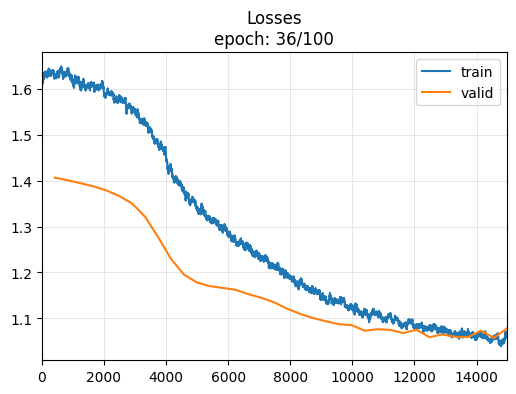

,train_loss,valid_loss,accuracy,balanced_accuracy_score
35,1.062417,1.078436,0.555375,0.555375


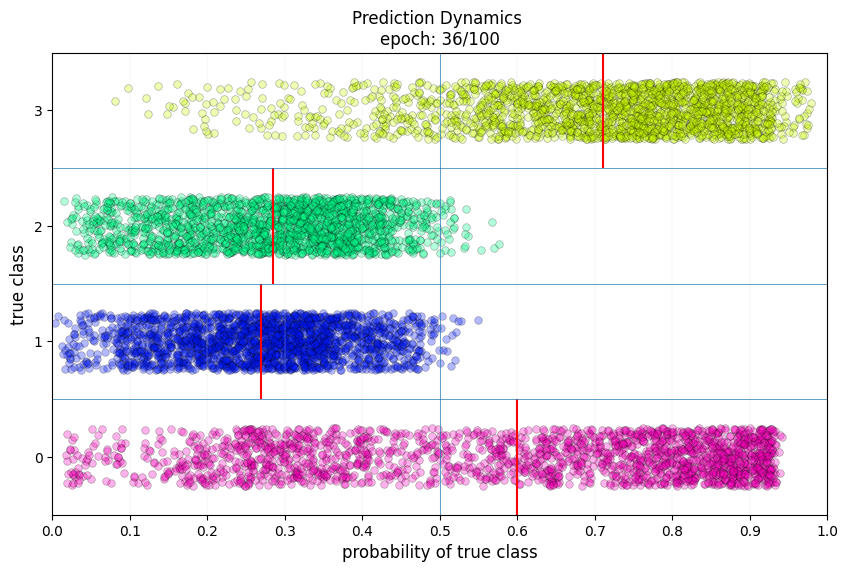

No improvement since epoch 29: early stopping


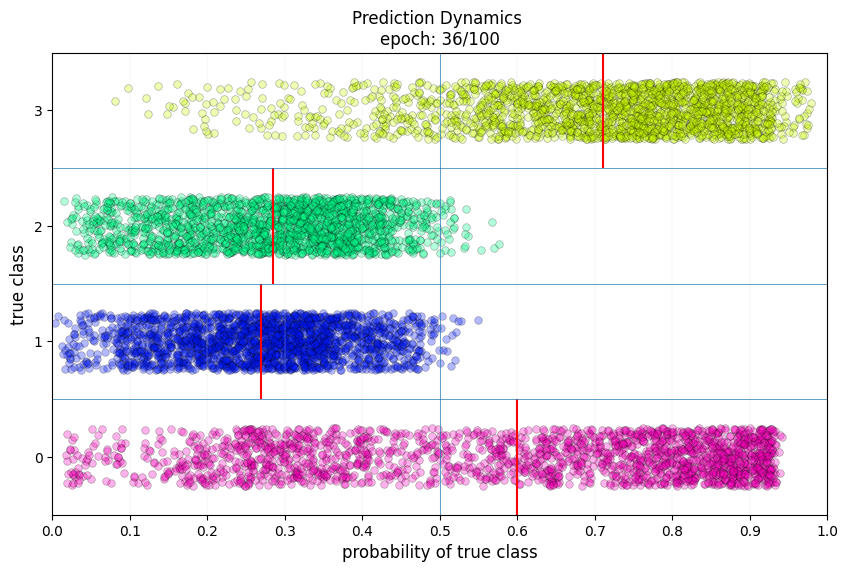

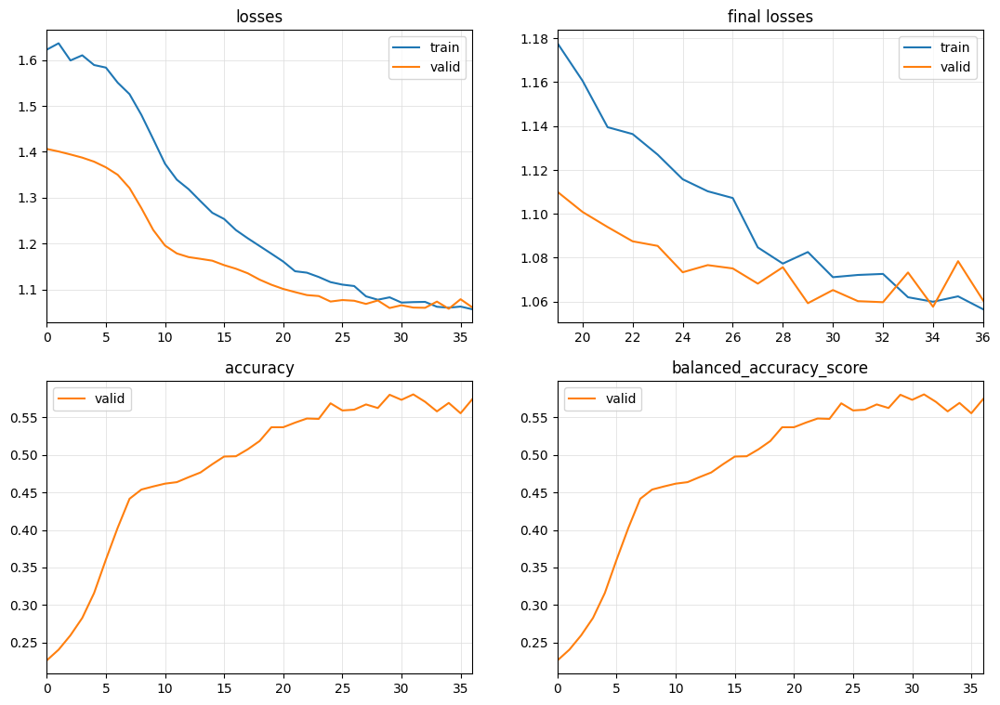

X.shape: (40000, 774, 112)
y.shape: (40000,)
Selected metric: accuracy
Computing feature importance (permutation method)...


  0 feature: BASELINE             accuracy: 0.601950


  0 feature: ABSV_1000mb_avg      accuracy: 0.601725


  1 feature: ABSV_1000mb_max      accuracy: 0.601650


  2 feature: ABSV_1000mb_min      accuracy: 0.601925


  3 feature: ABSV_100mb_avg       accuracy: 0.602000


  4 feature: ABSV_100mb_max       accuracy: 0.601900


  5 feature: ABSV_100mb_min       accuracy: 0.601950


  6 feature: ABSV_10mb_avg        accuracy: 0.601950


  7 feature: ABSV_10mb_max        accuracy: 0.601925


  8 feature: ABSV_10mb_min        accuracy: 0.602075


  9 feature: ABSV_150mb_avg       accuracy: 0.601900


 10 feature: ABSV_150mb_max       accuracy: 0.602025


 11 feature: ABSV_150mb_min       accuracy: 0.602150


 12 feature: ABSV_200mb_avg       accuracy: 0.601950


 13 feature: ABSV_200mb_max       accuracy: 0.602000


 14 feature: ABSV_200mb_min       accuracy: 0.602075


 15 feature: ABSV_20mb_avg        accuracy: 0.602025


 16 feature: ABSV_20mb_max        accuracy: 0.601975


 17 feature: ABSV_20mb_min        accuracy: 0.601975


 18 feature: ABSV_250mb_avg       accuracy: 0.602300


 19 feature: ABSV_250mb_max       accuracy: 0.602275


 20 feature: ABSV_250mb_min       accuracy: 0.601700


 21 feature: ABSV_300mb_avg       accuracy: 0.602000


 22 feature: ABSV_300mb_max       accuracy: 0.602100


 23 feature: ABSV_300mb_min       accuracy: 0.601950


 24 feature: ABSV_30mb_avg        accuracy: 0.602050


 25 feature: ABSV_30mb_max        accuracy: 0.602050


 26 feature: ABSV_30mb_min        accuracy: 0.602050


 27 feature: ABSV_350mb_avg       accuracy: 0.602050


 28 feature: ABSV_350mb_max       accuracy: 0.602200


 29 feature: ABSV_350mb_min       accuracy: 0.602125


 30 feature: ABSV_400mb_avg       accuracy: 0.601600


 31 feature: ABSV_400mb_max       accuracy: 0.602075


 32 feature: ABSV_400mb_min       accuracy: 0.602000


 33 feature: ABSV_450mb_avg       accuracy: 0.602000


 34 feature: ABSV_450mb_max       accuracy: 0.602075


 35 feature: ABSV_450mb_min       accuracy: 0.601825


 36 feature: ABSV_500mb_avg       accuracy: 0.601850


 37 feature: ABSV_500mb_max       accuracy: 0.602050


 38 feature: ABSV_500mb_min       accuracy: 0.601900


 39 feature: ABSV_50mb_avg        accuracy: 0.602000


 40 feature: ABSV_50mb_max        accuracy: 0.601975


 41 feature: ABSV_50mb_min        accuracy: 0.602025


 42 feature: ABSV_550mb_avg       accuracy: 0.601925


 43 feature: ABSV_550mb_max       accuracy: 0.602075


 44 feature: ABSV_550mb_min       accuracy: 0.601975


 45 feature: ABSV_600mb_avg       accuracy: 0.601825


 46 feature: ABSV_600mb_max       accuracy: 0.602125


 47 feature: ABSV_600mb_min       accuracy: 0.601775


 48 feature: ABSV_650mb_avg       accuracy: 0.601525


 49 feature: ABSV_650mb_max       accuracy: 0.601925


 50 feature: ABSV_650mb_min       accuracy: 0.602125


 51 feature: ABSV_700mb_avg       accuracy: 0.601750


 52 feature: ABSV_700mb_max       accuracy: 0.601850


 53 feature: ABSV_700mb_min       accuracy: 0.601700


 54 feature: ABSV_70mb_avg        accuracy: 0.601850


 55 feature: ABSV_70mb_max        accuracy: 0.601950


 56 feature: ABSV_70mb_min        accuracy: 0.601925


 57 feature: ABSV_750mb_avg       accuracy: 0.601725


 58 feature: ABSV_750mb_max       accuracy: 0.601800


 59 feature: ABSV_750mb_min       accuracy: 0.601550


 60 feature: ABSV_800mb_avg       accuracy: 0.602125


 61 feature: ABSV_800mb_max       accuracy: 0.601925


 62 feature: ABSV_800mb_min       accuracy: 0.601400


 63 feature: ABSV_850mb_avg       accuracy: 0.601975


 64 feature: ABSV_850mb_max       accuracy: 0.602275


 65 feature: ABSV_850mb_min       accuracy: 0.602025


 66 feature: ABSV_900mb_avg       accuracy: 0.602100


 67 feature: ABSV_900mb_max       accuracy: 0.602150


 68 feature: ABSV_900mb_min       accuracy: 0.601875


 69 feature: ABSV_925mb_avg       accuracy: 0.601975


 70 feature: ABSV_925mb_max       accuracy: 0.601800


 71 feature: ABSV_925mb_min       accuracy: 0.601900


 72 feature: ABSV_950mb_avg       accuracy: 0.602100


 73 feature: ABSV_950mb_max       accuracy: 0.601800


 74 feature: ABSV_950mb_min       accuracy: 0.601800


 75 feature: ABSV_975mb_avg       accuracy: 0.602150


 76 feature: ABSV_975mb_max       accuracy: 0.602100


 77 feature: ABSV_975mb_min       accuracy: 0.601750


 78 feature: ACPCP_surface_sum    accuracy: 0.601850


 79 feature: APCP_surface_sum     accuracy: 0.601875


 80 feature: APTMP_2maboveground_avg accuracy: 0.601500


 81 feature: APTMP_2maboveground_max accuracy: 0.601650


 82 feature: APTMP_2maboveground_min accuracy: 0.601975


 83 feature: CAPE_180M0mbaboveground_avg accuracy: 0.602050


 84 feature: CAPE_180M0mbaboveground_max accuracy: 0.601950


 85 feature: CAPE_180M0mbaboveground_min accuracy: 0.601950


 86 feature: CAPE_255M0mbaboveground_avg accuracy: 0.602000


 87 feature: CAPE_255M0mbaboveground_max accuracy: 0.601875


 88 feature: CAPE_255M0mbaboveground_min accuracy: 0.601900


 89 feature: CAPE_surface_avg     accuracy: 0.602025


 90 feature: CAPE_surface_max     accuracy: 0.601950


 91 feature: CAPE_surface_min     accuracy: 0.601850


 92 feature: CIN_180M0mbaboveground_avg accuracy: 0.601950


 93 feature: CIN_180M0mbaboveground_max accuracy: 0.602100


 94 feature: CIN_180M0mbaboveground_min accuracy: 0.601900


 95 feature: CIN_255M0mbaboveground_avg accuracy: 0.601975


 96 feature: CIN_255M0mbaboveground_max accuracy: 0.601800


 97 feature: CIN_255M0mbaboveground_min accuracy: 0.601950


 98 feature: CIN_surface_avg      accuracy: 0.601925


 99 feature: CIN_surface_max      accuracy: 0.602100


100 feature: CIN_surface_min      accuracy: 0.602025


101 feature: CPOFP_surface_avg    accuracy: 0.600550


102 feature: CPOFP_surface_max    accuracy: 0.604400


103 feature: CPOFP_surface_min    accuracy: 0.600075


104 feature: DPT_2maboveground_avg accuracy: 0.601900


105 feature: DPT_2maboveground_max accuracy: 0.601875


106 feature: DPT_2maboveground_min accuracy: 0.602100


107 feature: GUST_surface_avg     accuracy: 0.601025


108 feature: GUST_surface_max     accuracy: 0.600850


109 feature: GUST_surface_min     accuracy: 0.600725


110 feature: HGT_0Cisotherm_avg   accuracy: 0.601150


111 feature: HGT_0Cisotherm_max   accuracy: 0.602000


112 feature: HGT_0Cisotherm_min   accuracy: 0.601975


113 feature: HGT_1000mb_avg       accuracy: 0.602875


114 feature: HGT_1000mb_max       accuracy: 0.602675


115 feature: HGT_1000mb_min       accuracy: 0.602375


116 feature: HGT_100mb_avg        accuracy: 0.602050


117 feature: HGT_100mb_max        accuracy: 0.601975


118 feature: HGT_100mb_min        accuracy: 0.601925


119 feature: HGT_10mb_avg         accuracy: 0.601925


120 feature: HGT_10mb_max         accuracy: 0.602025


121 feature: HGT_10mb_min         accuracy: 0.601950


122 feature: HGT_150mb_avg        accuracy: 0.601975


123 feature: HGT_150mb_max        accuracy: 0.601950


124 feature: HGT_150mb_min        accuracy: 0.601825


125 feature: HGT_200mb_avg        accuracy: 0.601825


126 feature: HGT_200mb_max        accuracy: 0.601900


127 feature: HGT_200mb_min        accuracy: 0.602075


128 feature: HGT_20mb_avg         accuracy: 0.601725


129 feature: HGT_20mb_max         accuracy: 0.601900


130 feature: HGT_20mb_min         accuracy: 0.602200


131 feature: HGT_250mb_avg        accuracy: 0.601975


132 feature: HGT_250mb_max        accuracy: 0.601825


133 feature: HGT_250mb_min        accuracy: 0.602075


134 feature: HGT_300mb_avg        accuracy: 0.601775


135 feature: HGT_300mb_max        accuracy: 0.602275


136 feature: HGT_300mb_min        accuracy: 0.602150


137 feature: HGT_30mb_avg         accuracy: 0.602000


138 feature: HGT_30mb_max         accuracy: 0.601675


139 feature: HGT_30mb_min         accuracy: 0.601950


140 feature: HGT_350mb_avg        accuracy: 0.602075


141 feature: HGT_350mb_max        accuracy: 0.601900


142 feature: HGT_350mb_min        accuracy: 0.601975


143 feature: HGT_400mb_avg        accuracy: 0.602000


144 feature: HGT_400mb_max        accuracy: 0.601725


145 feature: HGT_400mb_min        accuracy: 0.601675


146 feature: HGT_450mb_avg        accuracy: 0.601675


147 feature: HGT_450mb_max        accuracy: 0.601925


148 feature: HGT_450mb_min        accuracy: 0.601950


149 feature: HGT_500mb_avg        accuracy: 0.601875


150 feature: HGT_500mb_max        accuracy: 0.602200


151 feature: HGT_500mb_min        accuracy: 0.601750


152 feature: HGT_50mb_avg         accuracy: 0.602050


153 feature: HGT_50mb_max         accuracy: 0.601975


154 feature: HGT_50mb_min         accuracy: 0.602100


155 feature: HGT_550mb_avg        accuracy: 0.602100


156 feature: HGT_550mb_max        accuracy: 0.602175


157 feature: HGT_550mb_min        accuracy: 0.602375


158 feature: HGT_600mb_avg        accuracy: 0.601700


159 feature: HGT_600mb_max        accuracy: 0.601600


160 feature: HGT_600mb_min        accuracy: 0.602000


161 feature: HGT_650mb_avg        accuracy: 0.601875


162 feature: HGT_650mb_max        accuracy: 0.601900


163 feature: HGT_650mb_min        accuracy: 0.601875


164 feature: HGT_700mb_avg        accuracy: 0.601675


165 feature: HGT_700mb_max        accuracy: 0.602350


166 feature: HGT_700mb_min        accuracy: 0.601875


167 feature: HGT_70mb_avg         accuracy: 0.601800


168 feature: HGT_70mb_max         accuracy: 0.601925


169 feature: HGT_70mb_min         accuracy: 0.602125


170 feature: HGT_750mb_avg        accuracy: 0.602025


171 feature: HGT_750mb_max        accuracy: 0.602050


172 feature: HGT_750mb_min        accuracy: 0.602300


173 feature: HGT_800mb_avg        accuracy: 0.601950


174 feature: HGT_800mb_max        accuracy: 0.601900


175 feature: HGT_800mb_min        accuracy: 0.602125


176 feature: HGT_850mb_avg        accuracy: 0.602125


177 feature: HGT_850mb_max        accuracy: 0.601975


178 feature: HGT_850mb_min        accuracy: 0.601925


179 feature: HGT_900mb_avg        accuracy: 0.601675


180 feature: HGT_900mb_max        accuracy: 0.601675


181 feature: HGT_900mb_min        accuracy: 0.602150


182 feature: HGT_925mb_avg        accuracy: 0.601850


183 feature: HGT_925mb_max        accuracy: 0.602500


184 feature: HGT_925mb_min        accuracy: 0.602750


185 feature: HGT_950mb_avg        accuracy: 0.602400


186 feature: HGT_950mb_max        accuracy: 0.603150


187 feature: HGT_950mb_min        accuracy: 0.601775


188 feature: HGT_975mb_avg        accuracy: 0.601975


189 feature: HGT_975mb_max        accuracy: 0.601650


190 feature: HGT_975mb_min        accuracy: 0.602175


191 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.601650


192 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.601825


193 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.602125


194 feature: HGT_maxwind_avg      accuracy: 0.602175


195 feature: HGT_maxwind_max      accuracy: 0.602650


196 feature: HGT_maxwind_min      accuracy: 0.601900


197 feature: HGT_surface_avg      accuracy: 0.601875


198 feature: HGT_surface_max      accuracy: 0.602025


199 feature: HGT_surface_min      accuracy: 0.602425


200 feature: HGT_tropopause_avg   accuracy: 0.601850


201 feature: HGT_tropopause_max   accuracy: 0.601350


202 feature: HGT_tropopause_min   accuracy: 0.602400


203 feature: HINDEX_surface_avg   accuracy: 0.601925


204 feature: HINDEX_surface_max   accuracy: 0.602850


205 feature: HINDEX_surface_min   accuracy: 0.601125


206 feature: HLCY_3000M0maboveground_avg accuracy: 0.601250


207 feature: HLCY_3000M0maboveground_max accuracy: 0.601400


208 feature: HLCY_3000M0maboveground_min accuracy: 0.601125


209 feature: ICAHT_maxwind_avg    accuracy: 0.602375


210 feature: ICAHT_maxwind_max    accuracy: 0.602275


211 feature: ICAHT_maxwind_min    accuracy: 0.601425


212 feature: ICAHT_tropopause_avg accuracy: 0.602075


213 feature: ICAHT_tropopause_max accuracy: 0.602125


214 feature: ICAHT_tropopause_min accuracy: 0.602100


215 feature: ICEC_surface_avg     accuracy: 0.601950


216 feature: ICEC_surface_max     accuracy: 0.601950


217 feature: ICEC_surface_min     accuracy: 0.601950


218 feature: LAND_surface_avg     accuracy: 0.600400


219 feature: LAND_surface_max     accuracy: 0.601525


220 feature: LAND_surface_min     accuracy: 0.601575


221 feature: POT_0D995sigmalevel_avg accuracy: 0.601750


222 feature: POT_0D995sigmalevel_max accuracy: 0.601925


223 feature: POT_0D995sigmalevel_min accuracy: 0.601875


224 feature: PRES_80maboveground_avg accuracy: 0.601625


225 feature: PRES_80maboveground_max accuracy: 0.601725


226 feature: PRES_80maboveground_min accuracy: 0.601275


227 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.601350


228 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.601975


229 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.601300


230 feature: PRES_maxwind_avg     accuracy: 0.600425


231 feature: PRES_maxwind_max     accuracy: 0.600825


232 feature: PRES_maxwind_min     accuracy: 0.601275


233 feature: PRES_surface_avg     accuracy: 0.601475


234 feature: PRES_surface_max     accuracy: 0.601650


235 feature: PRES_surface_min     accuracy: 0.601900


236 feature: PRES_tropopause_avg  accuracy: 0.601375


237 feature: PRES_tropopause_max  accuracy: 0.601425


238 feature: PRES_tropopause_min  accuracy: 0.600475


239 feature: PRMSL_meansealevel_avg accuracy: 0.602025


240 feature: PRMSL_meansealevel_max accuracy: 0.602050


241 feature: PRMSL_meansealevel_min accuracy: 0.602125


242 feature: RH_0Cisotherm_avg    accuracy: 0.600450


243 feature: RH_0Cisotherm_max    accuracy: 0.601050


244 feature: RH_0Cisotherm_min    accuracy: 0.600575


245 feature: RH_0D33M1sigmalayer_avg accuracy: 0.599950


246 feature: RH_0D33M1sigmalayer_max accuracy: 0.602700


247 feature: RH_0D33M1sigmalayer_min accuracy: 0.600050


248 feature: RH_0D44M0D72sigmalayer_avg accuracy: 0.600025


249 feature: RH_0D44M0D72sigmalayer_max accuracy: 0.601600


250 feature: RH_0D44M0D72sigmalayer_min accuracy: 0.604600


251 feature: RH_0D44M1sigmalayer_avg accuracy: 0.601375


252 feature: RH_0D44M1sigmalayer_max accuracy: 0.600500


253 feature: RH_0D44M1sigmalayer_min accuracy: 0.604725


254 feature: RH_0D72M0D94sigmalayer_avg accuracy: 0.599600


255 feature: RH_0D72M0D94sigmalayer_max accuracy: 0.603075


256 feature: RH_0D72M0D94sigmalayer_min accuracy: 0.603900


257 feature: RH_0D995sigmalevel_avg accuracy: 0.599075


258 feature: RH_0D995sigmalevel_max accuracy: 0.602975


259 feature: RH_0D995sigmalevel_min accuracy: 0.600450


260 feature: RH_1000mb_avg        accuracy: 0.600700


261 feature: RH_1000mb_max        accuracy: 0.603075


262 feature: RH_1000mb_min        accuracy: 0.602150


263 feature: RH_100mb_avg         accuracy: 0.602250


264 feature: RH_100mb_max         accuracy: 0.602075


265 feature: RH_100mb_min         accuracy: 0.602275


266 feature: RH_10mb_avg          accuracy: 0.601825


267 feature: RH_10mb_max          accuracy: 0.601875


268 feature: RH_10mb_min          accuracy: 0.602050


269 feature: RH_150mb_avg         accuracy: 0.601525


270 feature: RH_150mb_max         accuracy: 0.601075


271 feature: RH_150mb_min         accuracy: 0.601400


272 feature: RH_200mb_avg         accuracy: 0.600250


273 feature: RH_200mb_max         accuracy: 0.599825


274 feature: RH_200mb_min         accuracy: 0.601000


275 feature: RH_20mb_avg          accuracy: 0.601800


276 feature: RH_20mb_max          accuracy: 0.602125


277 feature: RH_20mb_min          accuracy: 0.601975


278 feature: RH_250mb_avg         accuracy: 0.600375


279 feature: RH_250mb_max         accuracy: 0.600175


280 feature: RH_250mb_min         accuracy: 0.600725


281 feature: RH_2maboveground_avg accuracy: 0.601125


282 feature: RH_2maboveground_max accuracy: 0.599775


283 feature: RH_2maboveground_min accuracy: 0.601200


284 feature: RH_300mb_avg         accuracy: 0.602125


285 feature: RH_300mb_max         accuracy: 0.602075


286 feature: RH_300mb_min         accuracy: 0.599750


287 feature: RH_30M0mbaboveground_avg accuracy: 0.603175


288 feature: RH_30M0mbaboveground_max accuracy: 0.602250


289 feature: RH_30M0mbaboveground_min accuracy: 0.603675


290 feature: RH_30mb_avg          accuracy: 0.601300


291 feature: RH_30mb_max          accuracy: 0.601750


292 feature: RH_30mb_min          accuracy: 0.602050


293 feature: RH_350mb_avg         accuracy: 0.601425


294 feature: RH_350mb_max         accuracy: 0.602200


295 feature: RH_350mb_min         accuracy: 0.601675


296 feature: RH_400mb_avg         accuracy: 0.600550


297 feature: RH_400mb_max         accuracy: 0.602825


298 feature: RH_400mb_min         accuracy: 0.601875


299 feature: RH_450mb_avg         accuracy: 0.604200


300 feature: RH_450mb_max         accuracy: 0.602300


301 feature: RH_450mb_min         accuracy: 0.603350


302 feature: RH_500mb_avg         accuracy: 0.599650


303 feature: RH_500mb_max         accuracy: 0.599425


304 feature: RH_500mb_min         accuracy: 0.604400


305 feature: RH_50mb_avg          accuracy: 0.601175


306 feature: RH_50mb_max          accuracy: 0.601850


307 feature: RH_50mb_min          accuracy: 0.601575


308 feature: RH_550mb_avg         accuracy: 0.600575


309 feature: RH_550mb_max         accuracy: 0.603775


310 feature: RH_550mb_min         accuracy: 0.601250


311 feature: RH_600mb_avg         accuracy: 0.605775


312 feature: RH_600mb_max         accuracy: 0.598900


313 feature: RH_600mb_min         accuracy: 0.600625


314 feature: RH_650mb_avg         accuracy: 0.603450


315 feature: RH_650mb_max         accuracy: 0.600750


316 feature: RH_650mb_min         accuracy: 0.600975


317 feature: RH_700mb_avg         accuracy: 0.604275


318 feature: RH_700mb_max         accuracy: 0.604350


319 feature: RH_700mb_min         accuracy: 0.602625


320 feature: RH_70mb_avg          accuracy: 0.601425


321 feature: RH_70mb_max          accuracy: 0.602150


322 feature: RH_70mb_min          accuracy: 0.601750


323 feature: RH_750mb_avg         accuracy: 0.600300


324 feature: RH_750mb_max         accuracy: 0.600825


325 feature: RH_750mb_min         accuracy: 0.601250


326 feature: RH_800mb_avg         accuracy: 0.604225


327 feature: RH_800mb_max         accuracy: 0.604725


328 feature: RH_800mb_min         accuracy: 0.598825


329 feature: RH_850mb_avg         accuracy: 0.602950


330 feature: RH_850mb_max         accuracy: 0.600650


331 feature: RH_850mb_min         accuracy: 0.603600


332 feature: RH_900mb_avg         accuracy: 0.602900


333 feature: RH_900mb_max         accuracy: 0.601075


334 feature: RH_900mb_min         accuracy: 0.600875


335 feature: RH_925mb_avg         accuracy: 0.599475


336 feature: RH_925mb_max         accuracy: 0.601675


337 feature: RH_925mb_min         accuracy: 0.600350


338 feature: RH_950mb_avg         accuracy: 0.601625


339 feature: RH_950mb_max         accuracy: 0.601100


340 feature: RH_950mb_min         accuracy: 0.601000


341 feature: RH_975mb_avg         accuracy: 0.600250


342 feature: RH_975mb_max         accuracy: 0.602400


343 feature: RH_975mb_min         accuracy: 0.600425


344 feature: SNOD_surface_avg     accuracy: 0.601425


345 feature: SNOD_surface_max     accuracy: 0.601100


346 feature: SNOD_surface_min     accuracy: 0.601075


347 feature: SPFH_2maboveground_avg accuracy: 0.601350


348 feature: SPFH_2maboveground_max accuracy: 0.600225


349 feature: SPFH_2maboveground_min accuracy: 0.601250


350 feature: SPFH_30M0mbaboveground_avg accuracy: 0.602200


351 feature: SPFH_30M0mbaboveground_max accuracy: 0.602025


352 feature: SPFH_30M0mbaboveground_min accuracy: 0.601925


353 feature: SPFH_80maboveground_avg accuracy: 0.601825


354 feature: SPFH_80maboveground_max accuracy: 0.601775


355 feature: SPFH_80maboveground_min accuracy: 0.601550


356 feature: TMP_0D995sigmalevel_avg accuracy: 0.601975


357 feature: TMP_0D995sigmalevel_max accuracy: 0.601900


358 feature: TMP_0D995sigmalevel_min accuracy: 0.601500


359 feature: TMP_1000mb_avg       accuracy: 0.601925


360 feature: TMP_1000mb_max       accuracy: 0.601975


361 feature: TMP_1000mb_min       accuracy: 0.601675


362 feature: TMP_100maboveground_avg accuracy: 0.601750


363 feature: TMP_100maboveground_max accuracy: 0.602025


364 feature: TMP_100maboveground_min accuracy: 0.601925


365 feature: TMP_100mb_avg        accuracy: 0.602200


366 feature: TMP_100mb_max        accuracy: 0.602275


367 feature: TMP_100mb_min        accuracy: 0.601450


368 feature: TMP_10mb_avg         accuracy: 0.602250


369 feature: TMP_10mb_max         accuracy: 0.602050


370 feature: TMP_10mb_min         accuracy: 0.601975


371 feature: TMP_150mb_avg        accuracy: 0.601925


372 feature: TMP_150mb_max        accuracy: 0.601875


373 feature: TMP_150mb_min        accuracy: 0.602375


374 feature: TMP_1829mabovemeansealevel_avg accuracy: 0.602525


375 feature: TMP_1829mabovemeansealevel_max accuracy: 0.600650


376 feature: TMP_1829mabovemeansealevel_min accuracy: 0.601300


377 feature: TMP_200mb_avg        accuracy: 0.602000


378 feature: TMP_200mb_max        accuracy: 0.601850


379 feature: TMP_200mb_min        accuracy: 0.601550


380 feature: TMP_20mb_avg         accuracy: 0.602750


381 feature: TMP_20mb_max         accuracy: 0.602300


382 feature: TMP_20mb_min         accuracy: 0.602075


383 feature: TMP_250mb_avg        accuracy: 0.601925


384 feature: TMP_250mb_max        accuracy: 0.602100


385 feature: TMP_250mb_min        accuracy: 0.601900


386 feature: TMP_2743mabovemeansealevel_avg accuracy: 0.600950


387 feature: TMP_2743mabovemeansealevel_max accuracy: 0.601975


388 feature: TMP_2743mabovemeansealevel_min accuracy: 0.600300


389 feature: TMP_2maboveground_avg accuracy: 0.601975


390 feature: TMP_2maboveground_max accuracy: 0.601750


391 feature: TMP_2maboveground_min accuracy: 0.601925


392 feature: TMP_300mb_avg        accuracy: 0.601850


393 feature: TMP_300mb_max        accuracy: 0.602150


394 feature: TMP_300mb_min        accuracy: 0.602025


395 feature: TMP_30M0mbaboveground_avg accuracy: 0.601775


396 feature: TMP_30M0mbaboveground_max accuracy: 0.601675


397 feature: TMP_30M0mbaboveground_min accuracy: 0.601675


398 feature: TMP_30mb_avg         accuracy: 0.601950


399 feature: TMP_30mb_max         accuracy: 0.602375


400 feature: TMP_30mb_min         accuracy: 0.601750


401 feature: TMP_350mb_avg        accuracy: 0.602000


402 feature: TMP_350mb_max        accuracy: 0.601900


403 feature: TMP_350mb_min        accuracy: 0.601850


404 feature: TMP_3658mabovemeansealevel_avg accuracy: 0.602050


405 feature: TMP_3658mabovemeansealevel_max accuracy: 0.602100


406 feature: TMP_3658mabovemeansealevel_min accuracy: 0.602000


407 feature: TMP_400mb_avg        accuracy: 0.601750


408 feature: TMP_400mb_max        accuracy: 0.602075


409 feature: TMP_400mb_min        accuracy: 0.601975


410 feature: TMP_450mb_avg        accuracy: 0.601700


411 feature: TMP_450mb_max        accuracy: 0.601775


412 feature: TMP_450mb_min        accuracy: 0.601825


413 feature: TMP_500mb_avg        accuracy: 0.602125


414 feature: TMP_500mb_max        accuracy: 0.601975


415 feature: TMP_500mb_min        accuracy: 0.601750


416 feature: TMP_50mb_avg         accuracy: 0.601725


417 feature: TMP_50mb_max         accuracy: 0.601750


418 feature: TMP_50mb_min         accuracy: 0.602500


419 feature: TMP_550mb_avg        accuracy: 0.601875


420 feature: TMP_550mb_max        accuracy: 0.601950


421 feature: TMP_550mb_min        accuracy: 0.602000


422 feature: TMP_600mb_avg        accuracy: 0.601800


423 feature: TMP_600mb_max        accuracy: 0.601725


424 feature: TMP_600mb_min        accuracy: 0.601775


425 feature: TMP_650mb_avg        accuracy: 0.601850


426 feature: TMP_650mb_max        accuracy: 0.601975


427 feature: TMP_650mb_min        accuracy: 0.601775


428 feature: TMP_700mb_avg        accuracy: 0.601775


429 feature: TMP_700mb_max        accuracy: 0.601950


430 feature: TMP_700mb_min        accuracy: 0.601525


431 feature: TMP_70mb_avg         accuracy: 0.601075


432 feature: TMP_70mb_max         accuracy: 0.601500


433 feature: TMP_70mb_min         accuracy: 0.602200


434 feature: TMP_750mb_avg        accuracy: 0.601750


435 feature: TMP_750mb_max        accuracy: 0.602075


436 feature: TMP_750mb_min        accuracy: 0.602075


437 feature: TMP_800mb_avg        accuracy: 0.601900


438 feature: TMP_800mb_max        accuracy: 0.601900


439 feature: TMP_800mb_min        accuracy: 0.602075


440 feature: TMP_80maboveground_avg accuracy: 0.601875


441 feature: TMP_80maboveground_max accuracy: 0.601975


442 feature: TMP_80maboveground_min accuracy: 0.601975


443 feature: TMP_850mb_avg        accuracy: 0.602150


444 feature: TMP_850mb_max        accuracy: 0.601925


445 feature: TMP_850mb_min        accuracy: 0.601975


446 feature: TMP_900mb_avg        accuracy: 0.601775


447 feature: TMP_900mb_max        accuracy: 0.602000


448 feature: TMP_900mb_min        accuracy: 0.601850


449 feature: TMP_925mb_avg        accuracy: 0.601400


450 feature: TMP_925mb_max        accuracy: 0.601600


451 feature: TMP_925mb_min        accuracy: 0.602075


452 feature: TMP_950mb_avg        accuracy: 0.601975


453 feature: TMP_950mb_max        accuracy: 0.601800


454 feature: TMP_950mb_min        accuracy: 0.602000


455 feature: TMP_975mb_avg        accuracy: 0.602050


456 feature: TMP_975mb_max        accuracy: 0.602000


457 feature: TMP_975mb_min        accuracy: 0.601775


458 feature: TMP_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.602075


459 feature: TMP_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.601875


460 feature: TMP_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.601975


461 feature: TMP_maxwind_avg      accuracy: 0.601800


462 feature: TMP_maxwind_max      accuracy: 0.601925


463 feature: TMP_maxwind_min      accuracy: 0.601875


464 feature: TMP_surface_avg      accuracy: 0.601750


465 feature: TMP_surface_max      accuracy: 0.601650


466 feature: TMP_surface_min      accuracy: 0.601750


467 feature: TMP_tropopause_avg   accuracy: 0.601925


468 feature: TMP_tropopause_max   accuracy: 0.602200


469 feature: TMP_tropopause_min   accuracy: 0.601575


470 feature: TSOIL_0D1M0D4mbelowground_avg accuracy: 0.602125


471 feature: TSOIL_0D1M0D4mbelowground_max accuracy: 0.601825


472 feature: TSOIL_0D1M0D4mbelowground_min accuracy: 0.601850


473 feature: TSOIL_0D4M1mbelowground_avg accuracy: 0.601325


474 feature: TSOIL_0D4M1mbelowground_max accuracy: 0.601925


475 feature: TSOIL_0D4M1mbelowground_min accuracy: 0.602100


476 feature: TSOIL_0M0D1mbelowground_avg accuracy: 0.602000


477 feature: TSOIL_0M0D1mbelowground_max accuracy: 0.601575


478 feature: TSOIL_0M0D1mbelowground_min accuracy: 0.601750


479 feature: TSOIL_1M2mbelowground_avg accuracy: 0.601775


480 feature: TSOIL_1M2mbelowground_max accuracy: 0.601675


481 feature: TSOIL_1M2mbelowground_min accuracy: 0.602150


482 feature: UGRD_0D995sigmalevel_avg accuracy: 0.601975


483 feature: UGRD_0D995sigmalevel_max accuracy: 0.602250


484 feature: UGRD_0D995sigmalevel_min accuracy: 0.602175


485 feature: UGRD_1000mb_avg      accuracy: 0.601850


486 feature: UGRD_1000mb_max      accuracy: 0.602100


487 feature: UGRD_1000mb_min      accuracy: 0.602250


488 feature: UGRD_100maboveground_avg accuracy: 0.601850


489 feature: UGRD_100maboveground_max accuracy: 0.601900


490 feature: UGRD_100maboveground_min accuracy: 0.602075


491 feature: UGRD_100mb_avg       accuracy: 0.600825


492 feature: UGRD_100mb_max       accuracy: 0.601650


493 feature: UGRD_100mb_min       accuracy: 0.599725


494 feature: UGRD_10maboveground_avg accuracy: 0.602400


495 feature: UGRD_10maboveground_max accuracy: 0.602000


496 feature: UGRD_10maboveground_min accuracy: 0.602100


497 feature: UGRD_10mb_avg        accuracy: 0.601100


498 feature: UGRD_10mb_max        accuracy: 0.601600


499 feature: UGRD_10mb_min        accuracy: 0.601400


500 feature: UGRD_150mb_avg       accuracy: 0.600925


501 feature: UGRD_150mb_max       accuracy: 0.601750


502 feature: UGRD_150mb_min       accuracy: 0.600900


503 feature: UGRD_1829mabovemeansealevel_avg accuracy: 0.600525


504 feature: UGRD_1829mabovemeansealevel_max accuracy: 0.599975


505 feature: UGRD_1829mabovemeansealevel_min accuracy: 0.599575


506 feature: UGRD_200mb_avg       accuracy: 0.601500


507 feature: UGRD_200mb_max       accuracy: 0.602425


508 feature: UGRD_200mb_min       accuracy: 0.601075


509 feature: UGRD_20mb_avg        accuracy: 0.601600


510 feature: UGRD_20mb_max        accuracy: 0.601300


511 feature: UGRD_20mb_min        accuracy: 0.601625


512 feature: UGRD_250mb_avg       accuracy: 0.601700


513 feature: UGRD_250mb_max       accuracy: 0.601350


514 feature: UGRD_250mb_min       accuracy: 0.601875


515 feature: UGRD_2743mabovemeansealevel_avg accuracy: 0.601950


516 feature: UGRD_2743mabovemeansealevel_max accuracy: 0.600750


517 feature: UGRD_2743mabovemeansealevel_min accuracy: 0.601700


518 feature: UGRD_300mb_avg       accuracy: 0.602600


519 feature: UGRD_300mb_max       accuracy: 0.602300


520 feature: UGRD_300mb_min       accuracy: 0.600750


521 feature: UGRD_30M0mbaboveground_avg accuracy: 0.601550


522 feature: UGRD_30M0mbaboveground_max accuracy: 0.601625


523 feature: UGRD_30M0mbaboveground_min accuracy: 0.601875


524 feature: UGRD_30mb_avg        accuracy: 0.602100


525 feature: UGRD_30mb_max        accuracy: 0.600950


526 feature: UGRD_30mb_min        accuracy: 0.601925


527 feature: UGRD_350mb_avg       accuracy: 0.601600


528 feature: UGRD_350mb_max       accuracy: 0.601175


529 feature: UGRD_350mb_min       accuracy: 0.602575


530 feature: UGRD_3658mabovemeansealevel_avg accuracy: 0.602000


531 feature: UGRD_3658mabovemeansealevel_max accuracy: 0.602475


532 feature: UGRD_3658mabovemeansealevel_min accuracy: 0.602075


533 feature: UGRD_400mb_avg       accuracy: 0.602500


534 feature: UGRD_400mb_max       accuracy: 0.601300


535 feature: UGRD_400mb_min       accuracy: 0.602025


536 feature: UGRD_450mb_avg       accuracy: 0.600525


537 feature: UGRD_450mb_max       accuracy: 0.601350


538 feature: UGRD_450mb_min       accuracy: 0.602700


539 feature: UGRD_500mb_avg       accuracy: 0.602325


540 feature: UGRD_500mb_max       accuracy: 0.600975


541 feature: UGRD_500mb_min       accuracy: 0.600700


542 feature: UGRD_50mb_avg        accuracy: 0.602400


543 feature: UGRD_50mb_max        accuracy: 0.601600


544 feature: UGRD_50mb_min        accuracy: 0.601900


545 feature: UGRD_550mb_avg       accuracy: 0.601125


546 feature: UGRD_550mb_max       accuracy: 0.601525


547 feature: UGRD_550mb_min       accuracy: 0.601850


548 feature: UGRD_600mb_avg       accuracy: 0.601825


549 feature: UGRD_600mb_max       accuracy: 0.601500


550 feature: UGRD_600mb_min       accuracy: 0.602825


551 feature: UGRD_650mb_avg       accuracy: 0.601825


552 feature: UGRD_650mb_max       accuracy: 0.601450


553 feature: UGRD_650mb_min       accuracy: 0.601575


554 feature: UGRD_700mb_avg       accuracy: 0.601650


555 feature: UGRD_700mb_max       accuracy: 0.601725


556 feature: UGRD_700mb_min       accuracy: 0.601950


557 feature: UGRD_70mb_avg        accuracy: 0.601675


558 feature: UGRD_70mb_max        accuracy: 0.601950


559 feature: UGRD_70mb_min        accuracy: 0.601375


560 feature: UGRD_750mb_avg       accuracy: 0.601975


561 feature: UGRD_750mb_max       accuracy: 0.601600


562 feature: UGRD_750mb_min       accuracy: 0.601425


563 feature: UGRD_800mb_avg       accuracy: 0.602300


564 feature: UGRD_800mb_max       accuracy: 0.601575


565 feature: UGRD_800mb_min       accuracy: 0.602175


566 feature: UGRD_80maboveground_avg accuracy: 0.601500


567 feature: UGRD_80maboveground_max accuracy: 0.601850


568 feature: UGRD_80maboveground_min accuracy: 0.601925


569 feature: UGRD_850mb_avg       accuracy: 0.601775


570 feature: UGRD_850mb_max       accuracy: 0.601700


571 feature: UGRD_850mb_min       accuracy: 0.601800


572 feature: UGRD_900mb_avg       accuracy: 0.601800


573 feature: UGRD_900mb_max       accuracy: 0.602075


574 feature: UGRD_900mb_min       accuracy: 0.601575


575 feature: UGRD_925mb_avg       accuracy: 0.601650


576 feature: UGRD_925mb_max       accuracy: 0.601950


577 feature: UGRD_925mb_min       accuracy: 0.601925


578 feature: UGRD_950mb_avg       accuracy: 0.601800


579 feature: UGRD_950mb_max       accuracy: 0.601875


580 feature: UGRD_950mb_min       accuracy: 0.602075


581 feature: UGRD_975mb_avg       accuracy: 0.602175


582 feature: UGRD_975mb_max       accuracy: 0.601850


583 feature: UGRD_975mb_min       accuracy: 0.601950


584 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.601575


585 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.601625


586 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.601075


587 feature: UGRD_maxwind_avg     accuracy: 0.601375


588 feature: UGRD_maxwind_max     accuracy: 0.600950


589 feature: UGRD_maxwind_min     accuracy: 0.601000


590 feature: UGRD_tropopause_avg  accuracy: 0.601950


591 feature: UGRD_tropopause_max  accuracy: 0.601825


592 feature: UGRD_tropopause_min  accuracy: 0.601400


593 feature: VGRD_0D995sigmalevel_avg accuracy: 0.601325


594 feature: VGRD_0D995sigmalevel_max accuracy: 0.602100


595 feature: VGRD_0D995sigmalevel_min accuracy: 0.602250


596 feature: VGRD_1000mb_avg      accuracy: 0.601875


597 feature: VGRD_1000mb_max      accuracy: 0.602075


598 feature: VGRD_1000mb_min      accuracy: 0.602250


599 feature: VGRD_100maboveground_avg accuracy: 0.602125


600 feature: VGRD_100maboveground_max accuracy: 0.602150


601 feature: VGRD_100maboveground_min accuracy: 0.601950


602 feature: VGRD_100mb_avg       accuracy: 0.601350


603 feature: VGRD_100mb_max       accuracy: 0.601200


604 feature: VGRD_100mb_min       accuracy: 0.601050


605 feature: VGRD_10maboveground_avg accuracy: 0.601700


606 feature: VGRD_10maboveground_max accuracy: 0.601950


607 feature: VGRD_10maboveground_min accuracy: 0.602250


608 feature: VGRD_10mb_avg        accuracy: 0.601150


609 feature: VGRD_10mb_max        accuracy: 0.600800


610 feature: VGRD_10mb_min        accuracy: 0.600425


611 feature: VGRD_150mb_avg       accuracy: 0.602125


612 feature: VGRD_150mb_max       accuracy: 0.601600


613 feature: VGRD_150mb_min       accuracy: 0.600450


614 feature: VGRD_1829mabovemeansealevel_avg accuracy: 0.600550


615 feature: VGRD_1829mabovemeansealevel_max accuracy: 0.601825


616 feature: VGRD_1829mabovemeansealevel_min accuracy: 0.600425


617 feature: VGRD_200mb_avg       accuracy: 0.601275


618 feature: VGRD_200mb_max       accuracy: 0.601250


619 feature: VGRD_200mb_min       accuracy: 0.601425


620 feature: VGRD_20mb_avg        accuracy: 0.601050


621 feature: VGRD_20mb_max        accuracy: 0.601050


622 feature: VGRD_20mb_min        accuracy: 0.602075


623 feature: VGRD_250mb_avg       accuracy: 0.601750


624 feature: VGRD_250mb_max       accuracy: 0.602875


625 feature: VGRD_250mb_min       accuracy: 0.600000


626 feature: VGRD_2743mabovemeansealevel_avg accuracy: 0.603175


627 feature: VGRD_2743mabovemeansealevel_max accuracy: 0.599875


628 feature: VGRD_2743mabovemeansealevel_min accuracy: 0.602150


629 feature: VGRD_300mb_avg       accuracy: 0.601975


630 feature: VGRD_300mb_max       accuracy: 0.601200


631 feature: VGRD_300mb_min       accuracy: 0.602150


632 feature: VGRD_30M0mbaboveground_avg accuracy: 0.601950


633 feature: VGRD_30M0mbaboveground_max accuracy: 0.602300


634 feature: VGRD_30M0mbaboveground_min accuracy: 0.601925


635 feature: VGRD_30mb_avg        accuracy: 0.600700


636 feature: VGRD_30mb_max        accuracy: 0.601350


637 feature: VGRD_30mb_min        accuracy: 0.601675


638 feature: VGRD_350mb_avg       accuracy: 0.602575


639 feature: VGRD_350mb_max       accuracy: 0.601575


640 feature: VGRD_350mb_min       accuracy: 0.601800


641 feature: VGRD_3658mabovemeansealevel_avg accuracy: 0.601775


642 feature: VGRD_3658mabovemeansealevel_max accuracy: 0.601775


643 feature: VGRD_3658mabovemeansealevel_min accuracy: 0.602225


644 feature: VGRD_400mb_avg       accuracy: 0.602175


645 feature: VGRD_400mb_max       accuracy: 0.601175


646 feature: VGRD_400mb_min       accuracy: 0.601650


647 feature: VGRD_450mb_avg       accuracy: 0.602250


648 feature: VGRD_450mb_max       accuracy: 0.602650


649 feature: VGRD_450mb_min       accuracy: 0.602325


650 feature: VGRD_500mb_avg       accuracy: 0.601450


651 feature: VGRD_500mb_max       accuracy: 0.601225


652 feature: VGRD_500mb_min       accuracy: 0.601900


653 feature: VGRD_50mb_avg        accuracy: 0.600800


654 feature: VGRD_50mb_max        accuracy: 0.601450


655 feature: VGRD_50mb_min        accuracy: 0.602200


656 feature: VGRD_550mb_avg       accuracy: 0.601900


657 feature: VGRD_550mb_max       accuracy: 0.601575


658 feature: VGRD_550mb_min       accuracy: 0.602300


659 feature: VGRD_600mb_avg       accuracy: 0.602475


660 feature: VGRD_600mb_max       accuracy: 0.602475


661 feature: VGRD_600mb_min       accuracy: 0.602575


662 feature: VGRD_650mb_avg       accuracy: 0.602000


663 feature: VGRD_650mb_max       accuracy: 0.602375


664 feature: VGRD_650mb_min       accuracy: 0.601625


665 feature: VGRD_700mb_avg       accuracy: 0.602100


666 feature: VGRD_700mb_max       accuracy: 0.601200


667 feature: VGRD_700mb_min       accuracy: 0.602150


668 feature: VGRD_70mb_avg        accuracy: 0.601675


669 feature: VGRD_70mb_max        accuracy: 0.601700


670 feature: VGRD_70mb_min        accuracy: 0.601375


671 feature: VGRD_750mb_avg       accuracy: 0.602100


672 feature: VGRD_750mb_max       accuracy: 0.602750


673 feature: VGRD_750mb_min       accuracy: 0.602350


674 feature: VGRD_800mb_avg       accuracy: 0.601875


675 feature: VGRD_800mb_max       accuracy: 0.601800


676 feature: VGRD_800mb_min       accuracy: 0.602025


677 feature: VGRD_80maboveground_avg accuracy: 0.601650


678 feature: VGRD_80maboveground_max accuracy: 0.601825


679 feature: VGRD_80maboveground_min accuracy: 0.602325


680 feature: VGRD_850mb_avg       accuracy: 0.602125


681 feature: VGRD_850mb_max       accuracy: 0.601800


682 feature: VGRD_850mb_min       accuracy: 0.602125


683 feature: VGRD_900mb_avg       accuracy: 0.601850


684 feature: VGRD_900mb_max       accuracy: 0.602075


685 feature: VGRD_900mb_min       accuracy: 0.601850


686 feature: VGRD_925mb_avg       accuracy: 0.602025


687 feature: VGRD_925mb_max       accuracy: 0.601625


688 feature: VGRD_925mb_min       accuracy: 0.602125


689 feature: VGRD_950mb_avg       accuracy: 0.601850


690 feature: VGRD_950mb_max       accuracy: 0.602025


691 feature: VGRD_950mb_min       accuracy: 0.602150


692 feature: VGRD_975mb_avg       accuracy: 0.601975


693 feature: VGRD_975mb_max       accuracy: 0.601600


694 feature: VGRD_975mb_min       accuracy: 0.601750


695 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.603025


696 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.601625


697 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.601150


698 feature: VGRD_maxwind_avg     accuracy: 0.602100


699 feature: VGRD_maxwind_max     accuracy: 0.601675


700 feature: VGRD_maxwind_min     accuracy: 0.601350


701 feature: VGRD_tropopause_avg  accuracy: 0.602050


702 feature: VGRD_tropopause_max  accuracy: 0.602100


703 feature: VGRD_tropopause_min  accuracy: 0.601150


704 feature: VVEL_0D995sigmalevel_avg accuracy: 0.602100


705 feature: VVEL_0D995sigmalevel_max accuracy: 0.602025


706 feature: VVEL_0D995sigmalevel_min accuracy: 0.602025


707 feature: VVEL_1000mb_avg      accuracy: 0.602100


708 feature: VVEL_1000mb_max      accuracy: 0.601700


709 feature: VVEL_1000mb_min      accuracy: 0.601925


710 feature: VVEL_100mb_avg       accuracy: 0.602075


711 feature: VVEL_100mb_max       accuracy: 0.602050


712 feature: VVEL_100mb_min       accuracy: 0.601900


713 feature: VVEL_150mb_avg       accuracy: 0.602125


714 feature: VVEL_150mb_max       accuracy: 0.602025


715 feature: VVEL_150mb_min       accuracy: 0.602050


716 feature: VVEL_200mb_avg       accuracy: 0.602100


717 feature: VVEL_200mb_max       accuracy: 0.602050


718 feature: VVEL_200mb_min       accuracy: 0.602075


719 feature: VVEL_250mb_avg       accuracy: 0.602075


720 feature: VVEL_250mb_max       accuracy: 0.602000


721 feature: VVEL_250mb_min       accuracy: 0.602050


722 feature: VVEL_300mb_avg       accuracy: 0.602075


723 feature: VVEL_300mb_max       accuracy: 0.601875


724 feature: VVEL_300mb_min       accuracy: 0.601825


725 feature: VVEL_350mb_avg       accuracy: 0.602125


726 feature: VVEL_350mb_max       accuracy: 0.602100


727 feature: VVEL_350mb_min       accuracy: 0.602050


728 feature: VVEL_400mb_avg       accuracy: 0.602025


729 feature: VVEL_400mb_max       accuracy: 0.602075


730 feature: VVEL_400mb_min       accuracy: 0.602100


731 feature: VVEL_450mb_avg       accuracy: 0.602000


732 feature: VVEL_450mb_max       accuracy: 0.601900


733 feature: VVEL_450mb_min       accuracy: 0.601950


734 feature: VVEL_500mb_avg       accuracy: 0.602075


735 feature: VVEL_500mb_max       accuracy: 0.601975


736 feature: VVEL_500mb_min       accuracy: 0.601700


737 feature: VVEL_550mb_avg       accuracy: 0.602000


738 feature: VVEL_550mb_max       accuracy: 0.602000


739 feature: VVEL_550mb_min       accuracy: 0.601850


740 feature: VVEL_600mb_avg       accuracy: 0.601975


741 feature: VVEL_600mb_max       accuracy: 0.601875


742 feature: VVEL_600mb_min       accuracy: 0.602075


743 feature: VVEL_650mb_avg       accuracy: 0.601825


744 feature: VVEL_650mb_max       accuracy: 0.601925


745 feature: VVEL_650mb_min       accuracy: 0.601825


746 feature: VVEL_700mb_avg       accuracy: 0.601825


747 feature: VVEL_700mb_max       accuracy: 0.601925


748 feature: VVEL_700mb_min       accuracy: 0.601850


749 feature: VVEL_750mb_avg       accuracy: 0.601825


750 feature: VVEL_750mb_max       accuracy: 0.602125


751 feature: VVEL_750mb_min       accuracy: 0.601725


752 feature: VVEL_800mb_avg       accuracy: 0.602000


753 feature: VVEL_800mb_max       accuracy: 0.601875


754 feature: VVEL_800mb_min       accuracy: 0.602125


755 feature: VVEL_850mb_avg       accuracy: 0.601125


756 feature: VVEL_850mb_max       accuracy: 0.602175


757 feature: VVEL_850mb_min       accuracy: 0.602125


758 feature: VVEL_900mb_avg       accuracy: 0.601800


759 feature: VVEL_900mb_max       accuracy: 0.602000


760 feature: VVEL_900mb_min       accuracy: 0.602175


761 feature: VVEL_925mb_avg       accuracy: 0.601275


762 feature: VVEL_925mb_max       accuracy: 0.602150


763 feature: VVEL_925mb_min       accuracy: 0.601700


764 feature: VVEL_950mb_avg       accuracy: 0.601750


765 feature: VVEL_950mb_max       accuracy: 0.601525


766 feature: VVEL_950mb_min       accuracy: 0.601475


767 feature: VVEL_975mb_avg       accuracy: 0.602125


768 feature: VVEL_975mb_max       accuracy: 0.601575


769 feature: VVEL_975mb_min       accuracy: 0.601650


770 feature: WATR_surface_sum     accuracy: 0.601875


771 feature: WEASD_surface_avg    accuracy: 0.601300


772 feature: WEASD_surface_max    accuracy: 0.601975


773 feature: WEASD_surface_min    accuracy: 0.601200



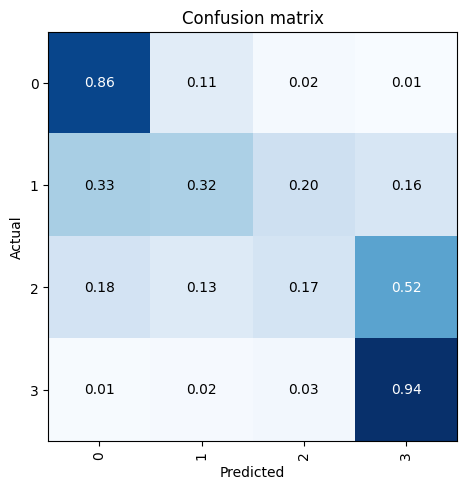

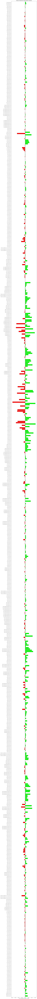

In [23]:
days = 14
_, dls_14 = utils.create_dls(X[:,:,-1 * days *8:], y, feature_mins=np.array(feature_mins), feature_maxs=np.array(feature_maxs), sample_frac=1.0, splits=splits, batch_size=96)
model_14 = TSTPlus(dls_14.vars, dls_14.c, seq_len=days*8, d_model=15, n_heads=15, d_k=1, d_v=2, d_ff=128, dropout=.2, n_layers=8, fc_dropout=.8, attn_dropout=.4, store_attn=False)
learn_14 = Learner(dls_14, model_14, loss_func=LabelSmoothingCrossEntropy(), metrics=[accuracy, BalancedAccuracy()],  opt_func=partial(Adam, decouple_wd=False),cbs=[ShowGraphCallback2(), PredictionDynamics()])
learn_14.fit_one_cycle(100, lr, cbs=[EarlyStoppingCallback(monitor='accuracy', min_delta=0.001, patience=7)])
interp = ClassificationInterpretation.from_learner(learn_14)
conf_matrix = interp.plot_confusion_matrix(normalize=True)
fi = learn_14.feature_importance(feature_names=list(feature_names))

In [24]:
#save model and feature importance
learn_14.export(ml_path + 'model_' + file_label + '_14days')
fi.to_csv(ml_path + 'fi_' + file_label + '_14days.csv')

In [25]:
del model_14, learn_14, dls_14 

epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.604543,1.385841,0.264500,0.264500,02:02
1,1.610568,1.379920,0.282875,0.282875,02:03
2,1.598241,1.371227,0.303875,0.303875,02:03
3,1.585831,1.358759,0.332375,0.332375,02:03
4,1.561430,1.337920,0.357625,0.357625,02:03
5,1.523195,1.308629,0.370125,0.370125,02:03
6,1.487405,1.282179,0.381000,0.381000,02:03
7,1.447921,1.267903,0.393125,0.393125,02:03
8,1.429821,1.260671,0.399500,0.399500,02:03
9,1.404006,1.257501,0.407250,0.407250,02:03


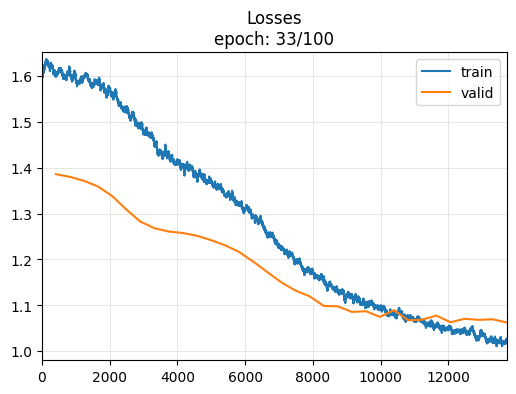

,train_loss,valid_loss,accuracy,balanced_accuracy_score
32,1.021982,1.062148,0.58,0.58


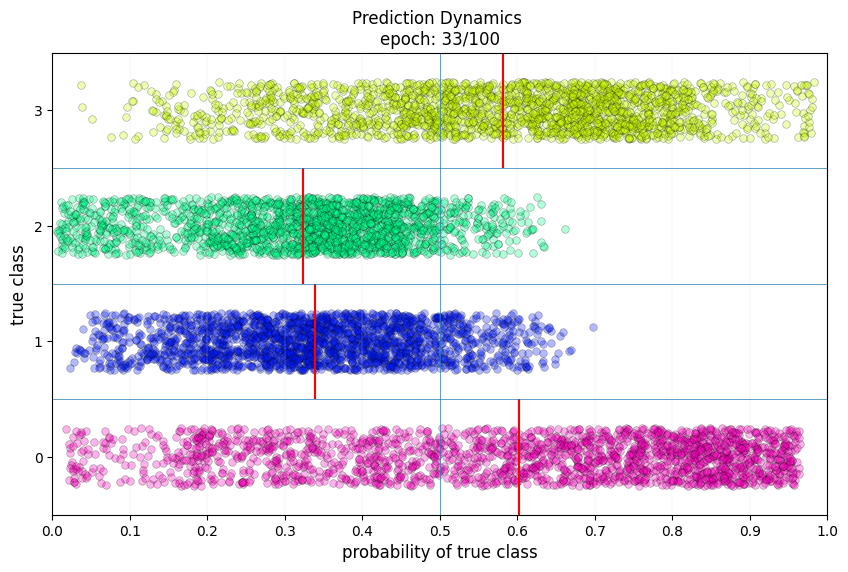

No improvement since epoch 26: early stopping


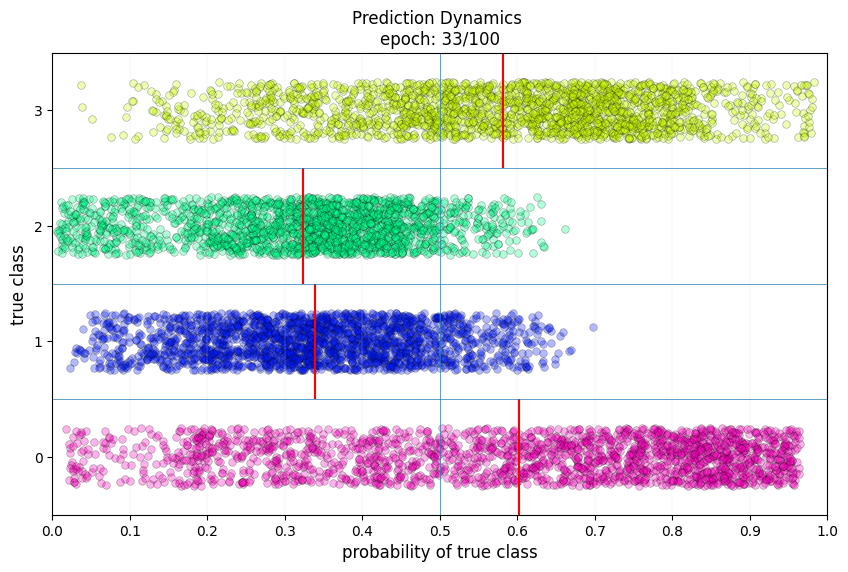

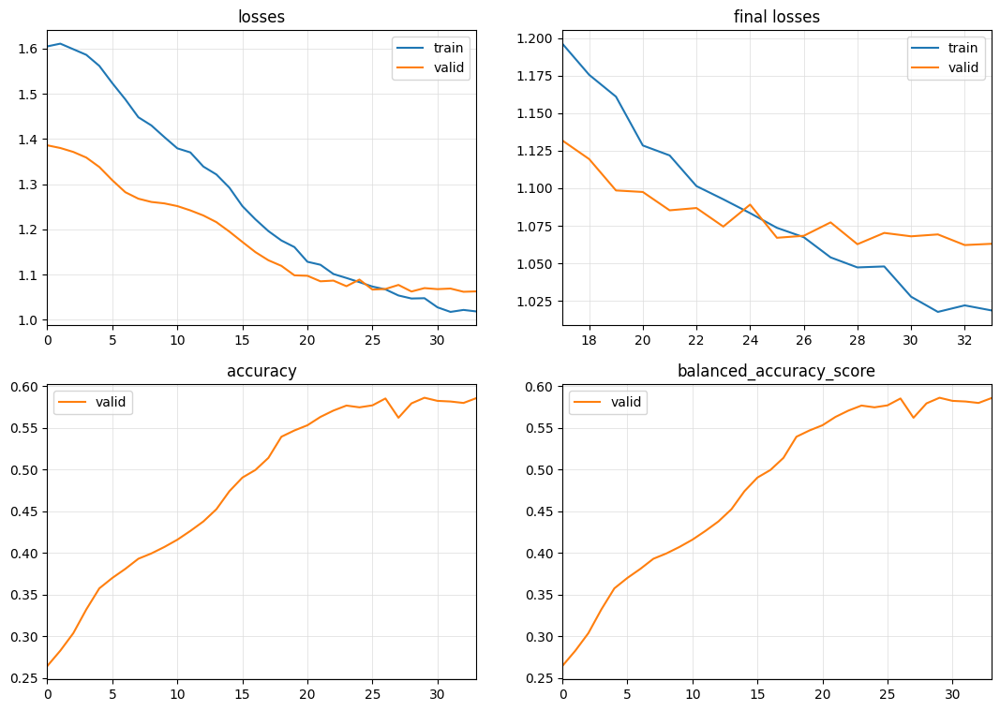

X.shape: (40000, 774, 224)
y.shape: (40000,)
Selected metric: accuracy
Computing feature importance (permutation method)...


  0 feature: BASELINE             accuracy: 0.641325


  0 feature: ABSV_1000mb_avg      accuracy: 0.641525


  1 feature: ABSV_1000mb_max      accuracy: 0.640825


  2 feature: ABSV_1000mb_min      accuracy: 0.641550


  3 feature: ABSV_100mb_avg       accuracy: 0.641375


  4 feature: ABSV_100mb_max       accuracy: 0.640775


  5 feature: ABSV_100mb_min       accuracy: 0.641550


  6 feature: ABSV_10mb_avg        accuracy: 0.641375


  7 feature: ABSV_10mb_max        accuracy: 0.641700


  8 feature: ABSV_10mb_min        accuracy: 0.641150


  9 feature: ABSV_150mb_avg       accuracy: 0.641375


 10 feature: ABSV_150mb_max       accuracy: 0.641675


 11 feature: ABSV_150mb_min       accuracy: 0.641650


 12 feature: ABSV_200mb_avg       accuracy: 0.641400


 13 feature: ABSV_200mb_max       accuracy: 0.641725


 14 feature: ABSV_200mb_min       accuracy: 0.641350


 15 feature: ABSV_20mb_avg        accuracy: 0.641350


 16 feature: ABSV_20mb_max        accuracy: 0.641325


 17 feature: ABSV_20mb_min        accuracy: 0.641675


 18 feature: ABSV_250mb_avg       accuracy: 0.641000


 19 feature: ABSV_250mb_max       accuracy: 0.641300


 20 feature: ABSV_250mb_min       accuracy: 0.641950


 21 feature: ABSV_300mb_avg       accuracy: 0.641425


 22 feature: ABSV_300mb_max       accuracy: 0.640975


 23 feature: ABSV_300mb_min       accuracy: 0.641300


 24 feature: ABSV_30mb_avg        accuracy: 0.641225


 25 feature: ABSV_30mb_max        accuracy: 0.641250


 26 feature: ABSV_30mb_min        accuracy: 0.641375


 27 feature: ABSV_350mb_avg       accuracy: 0.641400


 28 feature: ABSV_350mb_max       accuracy: 0.641525


 29 feature: ABSV_350mb_min       accuracy: 0.641225


 30 feature: ABSV_400mb_avg       accuracy: 0.641400


 31 feature: ABSV_400mb_max       accuracy: 0.641250


 32 feature: ABSV_400mb_min       accuracy: 0.641650


 33 feature: ABSV_450mb_avg       accuracy: 0.641025


 34 feature: ABSV_450mb_max       accuracy: 0.641625


 35 feature: ABSV_450mb_min       accuracy: 0.641325


 36 feature: ABSV_500mb_avg       accuracy: 0.641600


 37 feature: ABSV_500mb_max       accuracy: 0.640900


 38 feature: ABSV_500mb_min       accuracy: 0.641300


 39 feature: ABSV_50mb_avg        accuracy: 0.641450


 40 feature: ABSV_50mb_max        accuracy: 0.641275


 41 feature: ABSV_50mb_min        accuracy: 0.641650


 42 feature: ABSV_550mb_avg       accuracy: 0.641300


 43 feature: ABSV_550mb_max       accuracy: 0.641125


 44 feature: ABSV_550mb_min       accuracy: 0.641050


 45 feature: ABSV_600mb_avg       accuracy: 0.640875


 46 feature: ABSV_600mb_max       accuracy: 0.641300


 47 feature: ABSV_600mb_min       accuracy: 0.641500


 48 feature: ABSV_650mb_avg       accuracy: 0.641400


 49 feature: ABSV_650mb_max       accuracy: 0.641925


 50 feature: ABSV_650mb_min       accuracy: 0.641000


 51 feature: ABSV_700mb_avg       accuracy: 0.641800


 52 feature: ABSV_700mb_max       accuracy: 0.641850


 53 feature: ABSV_700mb_min       accuracy: 0.641800


 54 feature: ABSV_70mb_avg        accuracy: 0.641675


 55 feature: ABSV_70mb_max        accuracy: 0.641125


 56 feature: ABSV_70mb_min        accuracy: 0.641700


 57 feature: ABSV_750mb_avg       accuracy: 0.641125


 58 feature: ABSV_750mb_max       accuracy: 0.641225


 59 feature: ABSV_750mb_min       accuracy: 0.641350


 60 feature: ABSV_800mb_avg       accuracy: 0.641600


 61 feature: ABSV_800mb_max       accuracy: 0.641250


 62 feature: ABSV_800mb_min       accuracy: 0.640875


 63 feature: ABSV_850mb_avg       accuracy: 0.641475


 64 feature: ABSV_850mb_max       accuracy: 0.641025


 65 feature: ABSV_850mb_min       accuracy: 0.641525


 66 feature: ABSV_900mb_avg       accuracy: 0.641400


 67 feature: ABSV_900mb_max       accuracy: 0.641350


 68 feature: ABSV_900mb_min       accuracy: 0.640750


 69 feature: ABSV_925mb_avg       accuracy: 0.641475


 70 feature: ABSV_925mb_max       accuracy: 0.641725


 71 feature: ABSV_925mb_min       accuracy: 0.641750


 72 feature: ABSV_950mb_avg       accuracy: 0.641350


 73 feature: ABSV_950mb_max       accuracy: 0.640875


 74 feature: ABSV_950mb_min       accuracy: 0.640625


 75 feature: ABSV_975mb_avg       accuracy: 0.641200


 76 feature: ABSV_975mb_max       accuracy: 0.641550


 77 feature: ABSV_975mb_min       accuracy: 0.640550


 78 feature: ACPCP_surface_sum    accuracy: 0.641325


 79 feature: APCP_surface_sum     accuracy: 0.641250


 80 feature: APTMP_2maboveground_avg accuracy: 0.641725


 81 feature: APTMP_2maboveground_max accuracy: 0.641125


 82 feature: APTMP_2maboveground_min accuracy: 0.640350


 83 feature: CAPE_180M0mbaboveground_avg accuracy: 0.641325


 84 feature: CAPE_180M0mbaboveground_max accuracy: 0.641375


 85 feature: CAPE_180M0mbaboveground_min accuracy: 0.641425


 86 feature: CAPE_255M0mbaboveground_avg accuracy: 0.641450


 87 feature: CAPE_255M0mbaboveground_max accuracy: 0.641475


 88 feature: CAPE_255M0mbaboveground_min accuracy: 0.641300


 89 feature: CAPE_surface_avg     accuracy: 0.641275


 90 feature: CAPE_surface_max     accuracy: 0.641325


 91 feature: CAPE_surface_min     accuracy: 0.641350


 92 feature: CIN_180M0mbaboveground_avg accuracy: 0.641375


 93 feature: CIN_180M0mbaboveground_max accuracy: 0.641300


 94 feature: CIN_180M0mbaboveground_min accuracy: 0.641425


 95 feature: CIN_255M0mbaboveground_avg accuracy: 0.640625


 96 feature: CIN_255M0mbaboveground_max accuracy: 0.641275


 97 feature: CIN_255M0mbaboveground_min accuracy: 0.641525


 98 feature: CIN_surface_avg      accuracy: 0.640750


 99 feature: CIN_surface_max      accuracy: 0.641625


100 feature: CIN_surface_min      accuracy: 0.641250


101 feature: CPOFP_surface_avg    accuracy: 0.640675


102 feature: CPOFP_surface_max    accuracy: 0.637550


103 feature: CPOFP_surface_min    accuracy: 0.641675


104 feature: DPT_2maboveground_avg accuracy: 0.641675


105 feature: DPT_2maboveground_max accuracy: 0.641175


106 feature: DPT_2maboveground_min accuracy: 0.641500


107 feature: GUST_surface_avg     accuracy: 0.641125


108 feature: GUST_surface_max     accuracy: 0.640625


109 feature: GUST_surface_min     accuracy: 0.640575


110 feature: HGT_0Cisotherm_avg   accuracy: 0.641150


111 feature: HGT_0Cisotherm_max   accuracy: 0.640925


112 feature: HGT_0Cisotherm_min   accuracy: 0.641500


113 feature: HGT_1000mb_avg       accuracy: 0.640575


114 feature: HGT_1000mb_max       accuracy: 0.641175


115 feature: HGT_1000mb_min       accuracy: 0.640625


116 feature: HGT_100mb_avg        accuracy: 0.641575


117 feature: HGT_100mb_max        accuracy: 0.641375


118 feature: HGT_100mb_min        accuracy: 0.640700


119 feature: HGT_10mb_avg         accuracy: 0.641200


120 feature: HGT_10mb_max         accuracy: 0.640625


121 feature: HGT_10mb_min         accuracy: 0.641275


122 feature: HGT_150mb_avg        accuracy: 0.640800


123 feature: HGT_150mb_max        accuracy: 0.641275


124 feature: HGT_150mb_min        accuracy: 0.641875


125 feature: HGT_200mb_avg        accuracy: 0.641550


126 feature: HGT_200mb_max        accuracy: 0.641475


127 feature: HGT_200mb_min        accuracy: 0.640875


128 feature: HGT_20mb_avg         accuracy: 0.640450


129 feature: HGT_20mb_max         accuracy: 0.641450


130 feature: HGT_20mb_min         accuracy: 0.640625


131 feature: HGT_250mb_avg        accuracy: 0.641700


132 feature: HGT_250mb_max        accuracy: 0.641175


133 feature: HGT_250mb_min        accuracy: 0.640700


134 feature: HGT_300mb_avg        accuracy: 0.641025


135 feature: HGT_300mb_max        accuracy: 0.640550


136 feature: HGT_300mb_min        accuracy: 0.640875


137 feature: HGT_30mb_avg         accuracy: 0.640900


138 feature: HGT_30mb_max         accuracy: 0.641875


139 feature: HGT_30mb_min         accuracy: 0.641500


140 feature: HGT_350mb_avg        accuracy: 0.641225


141 feature: HGT_350mb_max        accuracy: 0.641225


142 feature: HGT_350mb_min        accuracy: 0.642100


143 feature: HGT_400mb_avg        accuracy: 0.640900


144 feature: HGT_400mb_max        accuracy: 0.641875


145 feature: HGT_400mb_min        accuracy: 0.641675


146 feature: HGT_450mb_avg        accuracy: 0.641025


147 feature: HGT_450mb_max        accuracy: 0.641825


148 feature: HGT_450mb_min        accuracy: 0.642125


149 feature: HGT_500mb_avg        accuracy: 0.640550


150 feature: HGT_500mb_max        accuracy: 0.641125


151 feature: HGT_500mb_min        accuracy: 0.641350


152 feature: HGT_50mb_avg         accuracy: 0.641625


153 feature: HGT_50mb_max         accuracy: 0.641125


154 feature: HGT_50mb_min         accuracy: 0.640300


155 feature: HGT_550mb_avg        accuracy: 0.641925


156 feature: HGT_550mb_max        accuracy: 0.642000


157 feature: HGT_550mb_min        accuracy: 0.641550


158 feature: HGT_600mb_avg        accuracy: 0.642325


159 feature: HGT_600mb_max        accuracy: 0.641000


160 feature: HGT_600mb_min        accuracy: 0.640450


161 feature: HGT_650mb_avg        accuracy: 0.641125


162 feature: HGT_650mb_max        accuracy: 0.641750


163 feature: HGT_650mb_min        accuracy: 0.641525


164 feature: HGT_700mb_avg        accuracy: 0.641450


165 feature: HGT_700mb_max        accuracy: 0.641425


166 feature: HGT_700mb_min        accuracy: 0.641950


167 feature: HGT_70mb_avg         accuracy: 0.640625


168 feature: HGT_70mb_max         accuracy: 0.641000


169 feature: HGT_70mb_min         accuracy: 0.641950


170 feature: HGT_750mb_avg        accuracy: 0.641275


171 feature: HGT_750mb_max        accuracy: 0.641600


172 feature: HGT_750mb_min        accuracy: 0.642325


173 feature: HGT_800mb_avg        accuracy: 0.640600


174 feature: HGT_800mb_max        accuracy: 0.642050


175 feature: HGT_800mb_min        accuracy: 0.640750


176 feature: HGT_850mb_avg        accuracy: 0.641900


177 feature: HGT_850mb_max        accuracy: 0.640700


178 feature: HGT_850mb_min        accuracy: 0.640975


179 feature: HGT_900mb_avg        accuracy: 0.641050


180 feature: HGT_900mb_max        accuracy: 0.640975


181 feature: HGT_900mb_min        accuracy: 0.641550


182 feature: HGT_925mb_avg        accuracy: 0.641625


183 feature: HGT_925mb_max        accuracy: 0.642000


184 feature: HGT_925mb_min        accuracy: 0.640675


185 feature: HGT_950mb_avg        accuracy: 0.641700


186 feature: HGT_950mb_max        accuracy: 0.642050


187 feature: HGT_950mb_min        accuracy: 0.642550


188 feature: HGT_975mb_avg        accuracy: 0.639875


189 feature: HGT_975mb_max        accuracy: 0.640050


190 feature: HGT_975mb_min        accuracy: 0.642100


191 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.641775


192 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.640925


193 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.641700


194 feature: HGT_maxwind_avg      accuracy: 0.641050


195 feature: HGT_maxwind_max      accuracy: 0.641950


196 feature: HGT_maxwind_min      accuracy: 0.641600


197 feature: HGT_surface_avg      accuracy: 0.641700


198 feature: HGT_surface_max      accuracy: 0.640575


199 feature: HGT_surface_min      accuracy: 0.641875


200 feature: HGT_tropopause_avg   accuracy: 0.641500


201 feature: HGT_tropopause_max   accuracy: 0.641825


202 feature: HGT_tropopause_min   accuracy: 0.642050


203 feature: HINDEX_surface_avg   accuracy: 0.640675


204 feature: HINDEX_surface_max   accuracy: 0.641025


205 feature: HINDEX_surface_min   accuracy: 0.641450


206 feature: HLCY_3000M0maboveground_avg accuracy: 0.641100


207 feature: HLCY_3000M0maboveground_max accuracy: 0.640575


208 feature: HLCY_3000M0maboveground_min accuracy: 0.640525


209 feature: ICAHT_maxwind_avg    accuracy: 0.641275


210 feature: ICAHT_maxwind_max    accuracy: 0.641500


211 feature: ICAHT_maxwind_min    accuracy: 0.641600


212 feature: ICAHT_tropopause_avg accuracy: 0.641225


213 feature: ICAHT_tropopause_max accuracy: 0.640875


214 feature: ICAHT_tropopause_min accuracy: 0.641400


215 feature: ICEC_surface_avg     accuracy: 0.641325


216 feature: ICEC_surface_max     accuracy: 0.641325


217 feature: ICEC_surface_min     accuracy: 0.641325


218 feature: LAND_surface_avg     accuracy: 0.640875


219 feature: LAND_surface_max     accuracy: 0.641300


220 feature: LAND_surface_min     accuracy: 0.641100


221 feature: POT_0D995sigmalevel_avg accuracy: 0.641350


222 feature: POT_0D995sigmalevel_max accuracy: 0.641725


223 feature: POT_0D995sigmalevel_min accuracy: 0.642075


224 feature: PRES_80maboveground_avg accuracy: 0.641125


225 feature: PRES_80maboveground_max accuracy: 0.640500


226 feature: PRES_80maboveground_min accuracy: 0.641275


227 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.641250


228 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.641500


229 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.641500


230 feature: PRES_maxwind_avg     accuracy: 0.641175


231 feature: PRES_maxwind_max     accuracy: 0.641075


232 feature: PRES_maxwind_min     accuracy: 0.641400


233 feature: PRES_surface_avg     accuracy: 0.641400


234 feature: PRES_surface_max     accuracy: 0.641575


235 feature: PRES_surface_min     accuracy: 0.641375


236 feature: PRES_tropopause_avg  accuracy: 0.641475


237 feature: PRES_tropopause_max  accuracy: 0.640975


238 feature: PRES_tropopause_min  accuracy: 0.640325


239 feature: PRMSL_meansealevel_avg accuracy: 0.640925


240 feature: PRMSL_meansealevel_max accuracy: 0.641725


241 feature: PRMSL_meansealevel_min accuracy: 0.641025


242 feature: RH_0Cisotherm_avg    accuracy: 0.640825


243 feature: RH_0Cisotherm_max    accuracy: 0.641450


244 feature: RH_0Cisotherm_min    accuracy: 0.641150


245 feature: RH_0D33M1sigmalayer_avg accuracy: 0.640625


246 feature: RH_0D33M1sigmalayer_max accuracy: 0.640100


247 feature: RH_0D33M1sigmalayer_min accuracy: 0.641750


248 feature: RH_0D44M0D72sigmalayer_avg accuracy: 0.641575


249 feature: RH_0D44M0D72sigmalayer_max accuracy: 0.640300


250 feature: RH_0D44M0D72sigmalayer_min accuracy: 0.641725


251 feature: RH_0D44M1sigmalayer_avg accuracy: 0.639575


252 feature: RH_0D44M1sigmalayer_max accuracy: 0.642025


253 feature: RH_0D44M1sigmalayer_min accuracy: 0.639900


254 feature: RH_0D72M0D94sigmalayer_avg accuracy: 0.641500


255 feature: RH_0D72M0D94sigmalayer_max accuracy: 0.641075


256 feature: RH_0D72M0D94sigmalayer_min accuracy: 0.641000


257 feature: RH_0D995sigmalevel_avg accuracy: 0.640775


258 feature: RH_0D995sigmalevel_max accuracy: 0.642325


259 feature: RH_0D995sigmalevel_min accuracy: 0.640850


260 feature: RH_1000mb_avg        accuracy: 0.641400


261 feature: RH_1000mb_max        accuracy: 0.641100


262 feature: RH_1000mb_min        accuracy: 0.640850


263 feature: RH_100mb_avg         accuracy: 0.641575


264 feature: RH_100mb_max         accuracy: 0.641300


265 feature: RH_100mb_min         accuracy: 0.641225


266 feature: RH_10mb_avg          accuracy: 0.641300


267 feature: RH_10mb_max          accuracy: 0.641300


268 feature: RH_10mb_min          accuracy: 0.641350


269 feature: RH_150mb_avg         accuracy: 0.641625


270 feature: RH_150mb_max         accuracy: 0.641625


271 feature: RH_150mb_min         accuracy: 0.641425


272 feature: RH_200mb_avg         accuracy: 0.639825


273 feature: RH_200mb_max         accuracy: 0.640300


274 feature: RH_200mb_min         accuracy: 0.639850


275 feature: RH_20mb_avg          accuracy: 0.641075


276 feature: RH_20mb_max          accuracy: 0.641525


277 feature: RH_20mb_min          accuracy: 0.641500


278 feature: RH_250mb_avg         accuracy: 0.639875


279 feature: RH_250mb_max         accuracy: 0.642950


280 feature: RH_250mb_min         accuracy: 0.641900


281 feature: RH_2maboveground_avg accuracy: 0.640150


282 feature: RH_2maboveground_max accuracy: 0.641600


283 feature: RH_2maboveground_min accuracy: 0.641150


284 feature: RH_300mb_avg         accuracy: 0.641600


285 feature: RH_300mb_max         accuracy: 0.640800


286 feature: RH_300mb_min         accuracy: 0.640650


287 feature: RH_30M0mbaboveground_avg accuracy: 0.642400


288 feature: RH_30M0mbaboveground_max accuracy: 0.640900


289 feature: RH_30M0mbaboveground_min accuracy: 0.640350


290 feature: RH_30mb_avg          accuracy: 0.641675


291 feature: RH_30mb_max          accuracy: 0.641325


292 feature: RH_30mb_min          accuracy: 0.640875


293 feature: RH_350mb_avg         accuracy: 0.642175


294 feature: RH_350mb_max         accuracy: 0.641450


295 feature: RH_350mb_min         accuracy: 0.641675


296 feature: RH_400mb_avg         accuracy: 0.642050


297 feature: RH_400mb_max         accuracy: 0.640850


298 feature: RH_400mb_min         accuracy: 0.641450


299 feature: RH_450mb_avg         accuracy: 0.641550


300 feature: RH_450mb_max         accuracy: 0.641475


301 feature: RH_450mb_min         accuracy: 0.640250


302 feature: RH_500mb_avg         accuracy: 0.639850


303 feature: RH_500mb_max         accuracy: 0.641225


304 feature: RH_500mb_min         accuracy: 0.640425


305 feature: RH_50mb_avg          accuracy: 0.641600


306 feature: RH_50mb_max          accuracy: 0.641400


307 feature: RH_50mb_min          accuracy: 0.641500


308 feature: RH_550mb_avg         accuracy: 0.641575


309 feature: RH_550mb_max         accuracy: 0.641675


310 feature: RH_550mb_min         accuracy: 0.642075


311 feature: RH_600mb_avg         accuracy: 0.639900


312 feature: RH_600mb_max         accuracy: 0.641475


313 feature: RH_600mb_min         accuracy: 0.642025


314 feature: RH_650mb_avg         accuracy: 0.641950


315 feature: RH_650mb_max         accuracy: 0.638500


316 feature: RH_650mb_min         accuracy: 0.639925


317 feature: RH_700mb_avg         accuracy: 0.639225


318 feature: RH_700mb_max         accuracy: 0.641675


319 feature: RH_700mb_min         accuracy: 0.641375


320 feature: RH_70mb_avg          accuracy: 0.641700


321 feature: RH_70mb_max          accuracy: 0.641475


322 feature: RH_70mb_min          accuracy: 0.641150


323 feature: RH_750mb_avg         accuracy: 0.641400


324 feature: RH_750mb_max         accuracy: 0.638675


325 feature: RH_750mb_min         accuracy: 0.641975


326 feature: RH_800mb_avg         accuracy: 0.641000


327 feature: RH_800mb_max         accuracy: 0.641075


328 feature: RH_800mb_min         accuracy: 0.641225


329 feature: RH_850mb_avg         accuracy: 0.641175


330 feature: RH_850mb_max         accuracy: 0.640925


331 feature: RH_850mb_min         accuracy: 0.641425


332 feature: RH_900mb_avg         accuracy: 0.640800


333 feature: RH_900mb_max         accuracy: 0.640425


334 feature: RH_900mb_min         accuracy: 0.641175


335 feature: RH_925mb_avg         accuracy: 0.641075


336 feature: RH_925mb_max         accuracy: 0.641750


337 feature: RH_925mb_min         accuracy: 0.640950


338 feature: RH_950mb_avg         accuracy: 0.641725


339 feature: RH_950mb_max         accuracy: 0.641425


340 feature: RH_950mb_min         accuracy: 0.641475


341 feature: RH_975mb_avg         accuracy: 0.640775


342 feature: RH_975mb_max         accuracy: 0.641100


343 feature: RH_975mb_min         accuracy: 0.641325


344 feature: SNOD_surface_avg     accuracy: 0.641600


345 feature: SNOD_surface_max     accuracy: 0.641175


346 feature: SNOD_surface_min     accuracy: 0.642100


347 feature: SPFH_2maboveground_avg accuracy: 0.642150


348 feature: SPFH_2maboveground_max accuracy: 0.642100


349 feature: SPFH_2maboveground_min accuracy: 0.641300


350 feature: SPFH_30M0mbaboveground_avg accuracy: 0.641450


351 feature: SPFH_30M0mbaboveground_max accuracy: 0.641275


352 feature: SPFH_30M0mbaboveground_min accuracy: 0.640975


353 feature: SPFH_80maboveground_avg accuracy: 0.641275


354 feature: SPFH_80maboveground_max accuracy: 0.640800


355 feature: SPFH_80maboveground_min accuracy: 0.641250


356 feature: TMP_0D995sigmalevel_avg accuracy: 0.641550


357 feature: TMP_0D995sigmalevel_max accuracy: 0.641575


358 feature: TMP_0D995sigmalevel_min accuracy: 0.640800


359 feature: TMP_1000mb_avg       accuracy: 0.641650


360 feature: TMP_1000mb_max       accuracy: 0.640950


361 feature: TMP_1000mb_min       accuracy: 0.641625


362 feature: TMP_100maboveground_avg accuracy: 0.641200


363 feature: TMP_100maboveground_max accuracy: 0.641350


364 feature: TMP_100maboveground_min accuracy: 0.641550


365 feature: TMP_100mb_avg        accuracy: 0.641525


366 feature: TMP_100mb_max        accuracy: 0.641200


367 feature: TMP_100mb_min        accuracy: 0.640575


368 feature: TMP_10mb_avg         accuracy: 0.641075


369 feature: TMP_10mb_max         accuracy: 0.641175


370 feature: TMP_10mb_min         accuracy: 0.641175


371 feature: TMP_150mb_avg        accuracy: 0.640675


372 feature: TMP_150mb_max        accuracy: 0.641575


373 feature: TMP_150mb_min        accuracy: 0.641000


374 feature: TMP_1829mabovemeansealevel_avg accuracy: 0.640075


375 feature: TMP_1829mabovemeansealevel_max accuracy: 0.638675


376 feature: TMP_1829mabovemeansealevel_min accuracy: 0.640450


377 feature: TMP_200mb_avg        accuracy: 0.641425


378 feature: TMP_200mb_max        accuracy: 0.641300


379 feature: TMP_200mb_min        accuracy: 0.640975


380 feature: TMP_20mb_avg         accuracy: 0.641275


381 feature: TMP_20mb_max         accuracy: 0.641200


382 feature: TMP_20mb_min         accuracy: 0.641425


383 feature: TMP_250mb_avg        accuracy: 0.641250


384 feature: TMP_250mb_max        accuracy: 0.641475


385 feature: TMP_250mb_min        accuracy: 0.640675


386 feature: TMP_2743mabovemeansealevel_avg accuracy: 0.641975


387 feature: TMP_2743mabovemeansealevel_max accuracy: 0.641800


388 feature: TMP_2743mabovemeansealevel_min accuracy: 0.640425


389 feature: TMP_2maboveground_avg accuracy: 0.641500


390 feature: TMP_2maboveground_max accuracy: 0.640400


391 feature: TMP_2maboveground_min accuracy: 0.640600


392 feature: TMP_300mb_avg        accuracy: 0.641275


393 feature: TMP_300mb_max        accuracy: 0.640950


394 feature: TMP_300mb_min        accuracy: 0.641325


395 feature: TMP_30M0mbaboveground_avg accuracy: 0.641225


396 feature: TMP_30M0mbaboveground_max accuracy: 0.641600


397 feature: TMP_30M0mbaboveground_min accuracy: 0.641175


398 feature: TMP_30mb_avg         accuracy: 0.641450


399 feature: TMP_30mb_max         accuracy: 0.641475


400 feature: TMP_30mb_min         accuracy: 0.641025


401 feature: TMP_350mb_avg        accuracy: 0.640825


402 feature: TMP_350mb_max        accuracy: 0.641800


403 feature: TMP_350mb_min        accuracy: 0.641400


404 feature: TMP_3658mabovemeansealevel_avg accuracy: 0.640500


405 feature: TMP_3658mabovemeansealevel_max accuracy: 0.640725


406 feature: TMP_3658mabovemeansealevel_min accuracy: 0.641425


407 feature: TMP_400mb_avg        accuracy: 0.641775


408 feature: TMP_400mb_max        accuracy: 0.641625


409 feature: TMP_400mb_min        accuracy: 0.641300


410 feature: TMP_450mb_avg        accuracy: 0.641025


411 feature: TMP_450mb_max        accuracy: 0.641250


412 feature: TMP_450mb_min        accuracy: 0.641600


413 feature: TMP_500mb_avg        accuracy: 0.641275


414 feature: TMP_500mb_max        accuracy: 0.641450


415 feature: TMP_500mb_min        accuracy: 0.641450


416 feature: TMP_50mb_avg         accuracy: 0.641825


417 feature: TMP_50mb_max         accuracy: 0.641100


418 feature: TMP_50mb_min         accuracy: 0.640775


419 feature: TMP_550mb_avg        accuracy: 0.641100


420 feature: TMP_550mb_max        accuracy: 0.641425


421 feature: TMP_550mb_min        accuracy: 0.641300


422 feature: TMP_600mb_avg        accuracy: 0.641475


423 feature: TMP_600mb_max        accuracy: 0.641075


424 feature: TMP_600mb_min        accuracy: 0.641425


425 feature: TMP_650mb_avg        accuracy: 0.641725


426 feature: TMP_650mb_max        accuracy: 0.641725


427 feature: TMP_650mb_min        accuracy: 0.641250


428 feature: TMP_700mb_avg        accuracy: 0.641600


429 feature: TMP_700mb_max        accuracy: 0.641300


430 feature: TMP_700mb_min        accuracy: 0.641150


431 feature: TMP_70mb_avg         accuracy: 0.640750


432 feature: TMP_70mb_max         accuracy: 0.641200


433 feature: TMP_70mb_min         accuracy: 0.641800


434 feature: TMP_750mb_avg        accuracy: 0.641150


435 feature: TMP_750mb_max        accuracy: 0.640725


436 feature: TMP_750mb_min        accuracy: 0.641275


437 feature: TMP_800mb_avg        accuracy: 0.641950


438 feature: TMP_800mb_max        accuracy: 0.641525


439 feature: TMP_800mb_min        accuracy: 0.641400


440 feature: TMP_80maboveground_avg accuracy: 0.640550


441 feature: TMP_80maboveground_max accuracy: 0.640875


442 feature: TMP_80maboveground_min accuracy: 0.640400


443 feature: TMP_850mb_avg        accuracy: 0.641950


444 feature: TMP_850mb_max        accuracy: 0.641650


445 feature: TMP_850mb_min        accuracy: 0.641675


446 feature: TMP_900mb_avg        accuracy: 0.641825


447 feature: TMP_900mb_max        accuracy: 0.641650


448 feature: TMP_900mb_min        accuracy: 0.640550


449 feature: TMP_925mb_avg        accuracy: 0.641675


450 feature: TMP_925mb_max        accuracy: 0.641675


451 feature: TMP_925mb_min        accuracy: 0.641925


452 feature: TMP_950mb_avg        accuracy: 0.641075


453 feature: TMP_950mb_max        accuracy: 0.641425


454 feature: TMP_950mb_min        accuracy: 0.641975


455 feature: TMP_975mb_avg        accuracy: 0.641200


456 feature: TMP_975mb_max        accuracy: 0.641875


457 feature: TMP_975mb_min        accuracy: 0.640950


458 feature: TMP_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.641150


459 feature: TMP_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.641625


460 feature: TMP_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.641425


461 feature: TMP_maxwind_avg      accuracy: 0.641200


462 feature: TMP_maxwind_max      accuracy: 0.641775


463 feature: TMP_maxwind_min      accuracy: 0.641525


464 feature: TMP_surface_avg      accuracy: 0.640850


465 feature: TMP_surface_max      accuracy: 0.641525


466 feature: TMP_surface_min      accuracy: 0.641300


467 feature: TMP_tropopause_avg   accuracy: 0.641550


468 feature: TMP_tropopause_max   accuracy: 0.640875


469 feature: TMP_tropopause_min   accuracy: 0.641075


470 feature: TSOIL_0D1M0D4mbelowground_avg accuracy: 0.641550


471 feature: TSOIL_0D1M0D4mbelowground_max accuracy: 0.641875


472 feature: TSOIL_0D1M0D4mbelowground_min accuracy: 0.641475


473 feature: TSOIL_0D4M1mbelowground_avg accuracy: 0.641300


474 feature: TSOIL_0D4M1mbelowground_max accuracy: 0.638725


475 feature: TSOIL_0D4M1mbelowground_min accuracy: 0.641425


476 feature: TSOIL_0M0D1mbelowground_avg accuracy: 0.641625


477 feature: TSOIL_0M0D1mbelowground_max accuracy: 0.641550


478 feature: TSOIL_0M0D1mbelowground_min accuracy: 0.641600


479 feature: TSOIL_1M2mbelowground_avg accuracy: 0.641300


480 feature: TSOIL_1M2mbelowground_max accuracy: 0.641250


481 feature: TSOIL_1M2mbelowground_min accuracy: 0.641925


482 feature: UGRD_0D995sigmalevel_avg accuracy: 0.641600


483 feature: UGRD_0D995sigmalevel_max accuracy: 0.641550


484 feature: UGRD_0D995sigmalevel_min accuracy: 0.641400


485 feature: UGRD_1000mb_avg      accuracy: 0.641850


486 feature: UGRD_1000mb_max      accuracy: 0.640600


487 feature: UGRD_1000mb_min      accuracy: 0.641025


488 feature: UGRD_100maboveground_avg accuracy: 0.641550


489 feature: UGRD_100maboveground_max accuracy: 0.642050


490 feature: UGRD_100maboveground_min accuracy: 0.641025


491 feature: UGRD_100mb_avg       accuracy: 0.641100


492 feature: UGRD_100mb_max       accuracy: 0.641650


493 feature: UGRD_100mb_min       accuracy: 0.641025


494 feature: UGRD_10maboveground_avg accuracy: 0.641100


495 feature: UGRD_10maboveground_max accuracy: 0.641100


496 feature: UGRD_10maboveground_min accuracy: 0.641575


497 feature: UGRD_10mb_avg        accuracy: 0.641300


498 feature: UGRD_10mb_max        accuracy: 0.641650


499 feature: UGRD_10mb_min        accuracy: 0.641925


500 feature: UGRD_150mb_avg       accuracy: 0.641550


501 feature: UGRD_150mb_max       accuracy: 0.641225


502 feature: UGRD_150mb_min       accuracy: 0.641925


503 feature: UGRD_1829mabovemeansealevel_avg accuracy: 0.642200


504 feature: UGRD_1829mabovemeansealevel_max accuracy: 0.640825


505 feature: UGRD_1829mabovemeansealevel_min accuracy: 0.640925


506 feature: UGRD_200mb_avg       accuracy: 0.641150


507 feature: UGRD_200mb_max       accuracy: 0.641425


508 feature: UGRD_200mb_min       accuracy: 0.641175


509 feature: UGRD_20mb_avg        accuracy: 0.641400


510 feature: UGRD_20mb_max        accuracy: 0.641325


511 feature: UGRD_20mb_min        accuracy: 0.641050


512 feature: UGRD_250mb_avg       accuracy: 0.641125


513 feature: UGRD_250mb_max       accuracy: 0.640425


514 feature: UGRD_250mb_min       accuracy: 0.641225


515 feature: UGRD_2743mabovemeansealevel_avg accuracy: 0.641350


516 feature: UGRD_2743mabovemeansealevel_max accuracy: 0.641175


517 feature: UGRD_2743mabovemeansealevel_min accuracy: 0.640975


518 feature: UGRD_300mb_avg       accuracy: 0.641675


519 feature: UGRD_300mb_max       accuracy: 0.640975


520 feature: UGRD_300mb_min       accuracy: 0.641275


521 feature: UGRD_30M0mbaboveground_avg accuracy: 0.641600


522 feature: UGRD_30M0mbaboveground_max accuracy: 0.641350


523 feature: UGRD_30M0mbaboveground_min accuracy: 0.641525


524 feature: UGRD_30mb_avg        accuracy: 0.641025


525 feature: UGRD_30mb_max        accuracy: 0.641400


526 feature: UGRD_30mb_min        accuracy: 0.641000


527 feature: UGRD_350mb_avg       accuracy: 0.641825


528 feature: UGRD_350mb_max       accuracy: 0.641175


529 feature: UGRD_350mb_min       accuracy: 0.641625


530 feature: UGRD_3658mabovemeansealevel_avg accuracy: 0.642225


531 feature: UGRD_3658mabovemeansealevel_max accuracy: 0.640975


532 feature: UGRD_3658mabovemeansealevel_min accuracy: 0.641350


533 feature: UGRD_400mb_avg       accuracy: 0.641075


534 feature: UGRD_400mb_max       accuracy: 0.641175


535 feature: UGRD_400mb_min       accuracy: 0.641075


536 feature: UGRD_450mb_avg       accuracy: 0.642050


537 feature: UGRD_450mb_max       accuracy: 0.641125


538 feature: UGRD_450mb_min       accuracy: 0.640600


539 feature: UGRD_500mb_avg       accuracy: 0.641450


540 feature: UGRD_500mb_max       accuracy: 0.641125


541 feature: UGRD_500mb_min       accuracy: 0.641100


542 feature: UGRD_50mb_avg        accuracy: 0.641025


543 feature: UGRD_50mb_max        accuracy: 0.641225


544 feature: UGRD_50mb_min        accuracy: 0.641075


545 feature: UGRD_550mb_avg       accuracy: 0.641625


546 feature: UGRD_550mb_max       accuracy: 0.641475


547 feature: UGRD_550mb_min       accuracy: 0.641050


548 feature: UGRD_600mb_avg       accuracy: 0.640725


549 feature: UGRD_600mb_max       accuracy: 0.641425


550 feature: UGRD_600mb_min       accuracy: 0.640925


551 feature: UGRD_650mb_avg       accuracy: 0.640925


552 feature: UGRD_650mb_max       accuracy: 0.640850


553 feature: UGRD_650mb_min       accuracy: 0.641250


554 feature: UGRD_700mb_avg       accuracy: 0.641450


555 feature: UGRD_700mb_max       accuracy: 0.640800


556 feature: UGRD_700mb_min       accuracy: 0.641150


557 feature: UGRD_70mb_avg        accuracy: 0.641400


558 feature: UGRD_70mb_max        accuracy: 0.641375


559 feature: UGRD_70mb_min        accuracy: 0.641200


560 feature: UGRD_750mb_avg       accuracy: 0.641625


561 feature: UGRD_750mb_max       accuracy: 0.641450


562 feature: UGRD_750mb_min       accuracy: 0.641850


563 feature: UGRD_800mb_avg       accuracy: 0.641800


564 feature: UGRD_800mb_max       accuracy: 0.641300


565 feature: UGRD_800mb_min       accuracy: 0.641050


566 feature: UGRD_80maboveground_avg accuracy: 0.641600


567 feature: UGRD_80maboveground_max accuracy: 0.641675


568 feature: UGRD_80maboveground_min accuracy: 0.641275


569 feature: UGRD_850mb_avg       accuracy: 0.642250


570 feature: UGRD_850mb_max       accuracy: 0.641125


571 feature: UGRD_850mb_min       accuracy: 0.641175


572 feature: UGRD_900mb_avg       accuracy: 0.641050


573 feature: UGRD_900mb_max       accuracy: 0.641600


574 feature: UGRD_900mb_min       accuracy: 0.641675


575 feature: UGRD_925mb_avg       accuracy: 0.642000


576 feature: UGRD_925mb_max       accuracy: 0.641025


577 feature: UGRD_925mb_min       accuracy: 0.641350


578 feature: UGRD_950mb_avg       accuracy: 0.642050


579 feature: UGRD_950mb_max       accuracy: 0.641225


580 feature: UGRD_950mb_min       accuracy: 0.641700


581 feature: UGRD_975mb_avg       accuracy: 0.641650


582 feature: UGRD_975mb_max       accuracy: 0.641375


583 feature: UGRD_975mb_min       accuracy: 0.642000


584 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.641425


585 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.641900


586 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.640725


587 feature: UGRD_maxwind_avg     accuracy: 0.640950


588 feature: UGRD_maxwind_max     accuracy: 0.641275


589 feature: UGRD_maxwind_min     accuracy: 0.640825


590 feature: UGRD_tropopause_avg  accuracy: 0.640725


591 feature: UGRD_tropopause_max  accuracy: 0.640725


592 feature: UGRD_tropopause_min  accuracy: 0.641050


593 feature: VGRD_0D995sigmalevel_avg accuracy: 0.641175


594 feature: VGRD_0D995sigmalevel_max accuracy: 0.641625


595 feature: VGRD_0D995sigmalevel_min accuracy: 0.640875


596 feature: VGRD_1000mb_avg      accuracy: 0.641800


597 feature: VGRD_1000mb_max      accuracy: 0.641025


598 feature: VGRD_1000mb_min      accuracy: 0.641650


599 feature: VGRD_100maboveground_avg accuracy: 0.641475


600 feature: VGRD_100maboveground_max accuracy: 0.641150


601 feature: VGRD_100maboveground_min accuracy: 0.641375


602 feature: VGRD_100mb_avg       accuracy: 0.641600


603 feature: VGRD_100mb_max       accuracy: 0.641500


604 feature: VGRD_100mb_min       accuracy: 0.641225


605 feature: VGRD_10maboveground_avg accuracy: 0.640975


606 feature: VGRD_10maboveground_max accuracy: 0.641775


607 feature: VGRD_10maboveground_min accuracy: 0.640825


608 feature: VGRD_10mb_avg        accuracy: 0.641100


609 feature: VGRD_10mb_max        accuracy: 0.641525


610 feature: VGRD_10mb_min        accuracy: 0.641775


611 feature: VGRD_150mb_avg       accuracy: 0.641750


612 feature: VGRD_150mb_max       accuracy: 0.641450


613 feature: VGRD_150mb_min       accuracy: 0.641575


614 feature: VGRD_1829mabovemeansealevel_avg accuracy: 0.641150


615 feature: VGRD_1829mabovemeansealevel_max accuracy: 0.640700


616 feature: VGRD_1829mabovemeansealevel_min accuracy: 0.641950


617 feature: VGRD_200mb_avg       accuracy: 0.641150


618 feature: VGRD_200mb_max       accuracy: 0.641375


619 feature: VGRD_200mb_min       accuracy: 0.641800


620 feature: VGRD_20mb_avg        accuracy: 0.641275


621 feature: VGRD_20mb_max        accuracy: 0.640700


622 feature: VGRD_20mb_min        accuracy: 0.641425


623 feature: VGRD_250mb_avg       accuracy: 0.641325


624 feature: VGRD_250mb_max       accuracy: 0.641600


625 feature: VGRD_250mb_min       accuracy: 0.640975


626 feature: VGRD_2743mabovemeansealevel_avg accuracy: 0.641900


627 feature: VGRD_2743mabovemeansealevel_max accuracy: 0.641725


628 feature: VGRD_2743mabovemeansealevel_min accuracy: 0.641450


629 feature: VGRD_300mb_avg       accuracy: 0.641500


630 feature: VGRD_300mb_max       accuracy: 0.641500


631 feature: VGRD_300mb_min       accuracy: 0.641650


632 feature: VGRD_30M0mbaboveground_avg accuracy: 0.641775


633 feature: VGRD_30M0mbaboveground_max accuracy: 0.641025


634 feature: VGRD_30M0mbaboveground_min accuracy: 0.641575


635 feature: VGRD_30mb_avg        accuracy: 0.642175


636 feature: VGRD_30mb_max        accuracy: 0.641425


637 feature: VGRD_30mb_min        accuracy: 0.641150


638 feature: VGRD_350mb_avg       accuracy: 0.641700


639 feature: VGRD_350mb_max       accuracy: 0.641475


640 feature: VGRD_350mb_min       accuracy: 0.641500


641 feature: VGRD_3658mabovemeansealevel_avg accuracy: 0.641300


642 feature: VGRD_3658mabovemeansealevel_max accuracy: 0.641050


643 feature: VGRD_3658mabovemeansealevel_min accuracy: 0.641050


644 feature: VGRD_400mb_avg       accuracy: 0.641675


645 feature: VGRD_400mb_max       accuracy: 0.641400


646 feature: VGRD_400mb_min       accuracy: 0.641150


647 feature: VGRD_450mb_avg       accuracy: 0.642150


648 feature: VGRD_450mb_max       accuracy: 0.641575


649 feature: VGRD_450mb_min       accuracy: 0.641250


650 feature: VGRD_500mb_avg       accuracy: 0.641500


651 feature: VGRD_500mb_max       accuracy: 0.641375


652 feature: VGRD_500mb_min       accuracy: 0.641250


653 feature: VGRD_50mb_avg        accuracy: 0.641025


654 feature: VGRD_50mb_max        accuracy: 0.641425


655 feature: VGRD_50mb_min        accuracy: 0.640800


656 feature: VGRD_550mb_avg       accuracy: 0.641800


657 feature: VGRD_550mb_max       accuracy: 0.641500


658 feature: VGRD_550mb_min       accuracy: 0.641775


659 feature: VGRD_600mb_avg       accuracy: 0.641100


660 feature: VGRD_600mb_max       accuracy: 0.641300


661 feature: VGRD_600mb_min       accuracy: 0.641425


662 feature: VGRD_650mb_avg       accuracy: 0.641850


663 feature: VGRD_650mb_max       accuracy: 0.641675


664 feature: VGRD_650mb_min       accuracy: 0.640725


665 feature: VGRD_700mb_avg       accuracy: 0.641450


666 feature: VGRD_700mb_max       accuracy: 0.641325


667 feature: VGRD_700mb_min       accuracy: 0.641475


668 feature: VGRD_70mb_avg        accuracy: 0.641900


669 feature: VGRD_70mb_max        accuracy: 0.642175


670 feature: VGRD_70mb_min        accuracy: 0.641100


671 feature: VGRD_750mb_avg       accuracy: 0.641525


672 feature: VGRD_750mb_max       accuracy: 0.641350


673 feature: VGRD_750mb_min       accuracy: 0.641925


674 feature: VGRD_800mb_avg       accuracy: 0.641100


675 feature: VGRD_800mb_max       accuracy: 0.640700


676 feature: VGRD_800mb_min       accuracy: 0.641375


677 feature: VGRD_80maboveground_avg accuracy: 0.641150


678 feature: VGRD_80maboveground_max accuracy: 0.641025


679 feature: VGRD_80maboveground_min accuracy: 0.641800


680 feature: VGRD_850mb_avg       accuracy: 0.641450


681 feature: VGRD_850mb_max       accuracy: 0.641650


682 feature: VGRD_850mb_min       accuracy: 0.641400


683 feature: VGRD_900mb_avg       accuracy: 0.641600


684 feature: VGRD_900mb_max       accuracy: 0.641375


685 feature: VGRD_900mb_min       accuracy: 0.641150


686 feature: VGRD_925mb_avg       accuracy: 0.641100


687 feature: VGRD_925mb_max       accuracy: 0.641575


688 feature: VGRD_925mb_min       accuracy: 0.641300


689 feature: VGRD_950mb_avg       accuracy: 0.641575


690 feature: VGRD_950mb_max       accuracy: 0.641475


691 feature: VGRD_950mb_min       accuracy: 0.641675


692 feature: VGRD_975mb_avg       accuracy: 0.641625


693 feature: VGRD_975mb_max       accuracy: 0.641750


694 feature: VGRD_975mb_min       accuracy: 0.641000


695 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.641275


696 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.641300


697 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.641275


698 feature: VGRD_maxwind_avg     accuracy: 0.641650


699 feature: VGRD_maxwind_max     accuracy: 0.641375


700 feature: VGRD_maxwind_min     accuracy: 0.641175


701 feature: VGRD_tropopause_avg  accuracy: 0.642275


702 feature: VGRD_tropopause_max  accuracy: 0.641450


703 feature: VGRD_tropopause_min  accuracy: 0.641175


704 feature: VVEL_0D995sigmalevel_avg accuracy: 0.641250


705 feature: VVEL_0D995sigmalevel_max accuracy: 0.641575


706 feature: VVEL_0D995sigmalevel_min accuracy: 0.641700


707 feature: VVEL_1000mb_avg      accuracy: 0.641025


708 feature: VVEL_1000mb_max      accuracy: 0.641375


709 feature: VVEL_1000mb_min      accuracy: 0.641200


710 feature: VVEL_100mb_avg       accuracy: 0.641400


711 feature: VVEL_100mb_max       accuracy: 0.641525


712 feature: VVEL_100mb_min       accuracy: 0.641550


713 feature: VVEL_150mb_avg       accuracy: 0.641750


714 feature: VVEL_150mb_max       accuracy: 0.641375


715 feature: VVEL_150mb_min       accuracy: 0.641675


716 feature: VVEL_200mb_avg       accuracy: 0.641325


717 feature: VVEL_200mb_max       accuracy: 0.641125


718 feature: VVEL_200mb_min       accuracy: 0.641800


719 feature: VVEL_250mb_avg       accuracy: 0.641425


720 feature: VVEL_250mb_max       accuracy: 0.641450


721 feature: VVEL_250mb_min       accuracy: 0.641625


722 feature: VVEL_300mb_avg       accuracy: 0.641425


723 feature: VVEL_300mb_max       accuracy: 0.641500


724 feature: VVEL_300mb_min       accuracy: 0.641400


725 feature: VVEL_350mb_avg       accuracy: 0.641775


726 feature: VVEL_350mb_max       accuracy: 0.641675


727 feature: VVEL_350mb_min       accuracy: 0.641400


728 feature: VVEL_400mb_avg       accuracy: 0.641400


729 feature: VVEL_400mb_max       accuracy: 0.641575


730 feature: VVEL_400mb_min       accuracy: 0.641250


731 feature: VVEL_450mb_avg       accuracy: 0.641075


732 feature: VVEL_450mb_max       accuracy: 0.641325


733 feature: VVEL_450mb_min       accuracy: 0.641625


734 feature: VVEL_500mb_avg       accuracy: 0.641350


735 feature: VVEL_500mb_max       accuracy: 0.641375


736 feature: VVEL_500mb_min       accuracy: 0.641200


737 feature: VVEL_550mb_avg       accuracy: 0.640875


738 feature: VVEL_550mb_max       accuracy: 0.641275


739 feature: VVEL_550mb_min       accuracy: 0.641800


740 feature: VVEL_600mb_avg       accuracy: 0.641525


741 feature: VVEL_600mb_max       accuracy: 0.640900


742 feature: VVEL_600mb_min       accuracy: 0.641200


743 feature: VVEL_650mb_avg       accuracy: 0.641650


744 feature: VVEL_650mb_max       accuracy: 0.641200


745 feature: VVEL_650mb_min       accuracy: 0.641375


746 feature: VVEL_700mb_avg       accuracy: 0.641525


747 feature: VVEL_700mb_max       accuracy: 0.641425


748 feature: VVEL_700mb_min       accuracy: 0.641450


749 feature: VVEL_750mb_avg       accuracy: 0.641550


750 feature: VVEL_750mb_max       accuracy: 0.641200


751 feature: VVEL_750mb_min       accuracy: 0.641575


752 feature: VVEL_800mb_avg       accuracy: 0.641325


753 feature: VVEL_800mb_max       accuracy: 0.641125


754 feature: VVEL_800mb_min       accuracy: 0.641050


755 feature: VVEL_850mb_avg       accuracy: 0.641575


756 feature: VVEL_850mb_max       accuracy: 0.641300


757 feature: VVEL_850mb_min       accuracy: 0.641300


758 feature: VVEL_900mb_avg       accuracy: 0.640775


759 feature: VVEL_900mb_max       accuracy: 0.641575


760 feature: VVEL_900mb_min       accuracy: 0.641400


761 feature: VVEL_925mb_avg       accuracy: 0.641275


762 feature: VVEL_925mb_max       accuracy: 0.640650


763 feature: VVEL_925mb_min       accuracy: 0.641200


764 feature: VVEL_950mb_avg       accuracy: 0.641075


765 feature: VVEL_950mb_max       accuracy: 0.641300


766 feature: VVEL_950mb_min       accuracy: 0.641125


767 feature: VVEL_975mb_avg       accuracy: 0.640925


768 feature: VVEL_975mb_max       accuracy: 0.641500


769 feature: VVEL_975mb_min       accuracy: 0.641275


770 feature: WATR_surface_sum     accuracy: 0.641050


771 feature: WEASD_surface_avg    accuracy: 0.640900


772 feature: WEASD_surface_max    accuracy: 0.641300


773 feature: WEASD_surface_min    accuracy: 0.641500



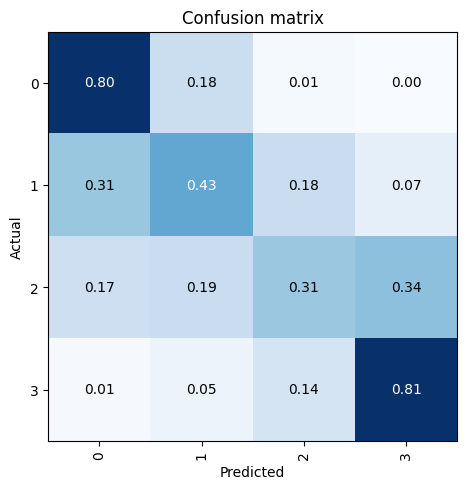

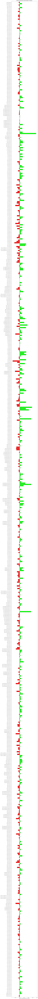

In [26]:

days = 28
_, dls_28 = utils.create_dls(X[:,:,-1 * days *8:], y, feature_mins=np.array(feature_mins), feature_maxs=np.array(feature_maxs), sample_frac=1.0, splits=splits, batch_size=96)
model_28 = TSTPlus(dls_28.vars, dls_28.c, seq_len=days*8, d_model=15, n_heads=15, d_k=1, d_v=2, d_ff=128, dropout=.2, n_layers=8, fc_dropout=.8, attn_dropout=.4, store_attn=False)
learn_28 = Learner(dls_28, model_28, loss_func=LabelSmoothingCrossEntropy(), metrics=[accuracy, BalancedAccuracy()],  opt_func=partial(Adam, decouple_wd=False),cbs=[ShowGraphCallback2(), PredictionDynamics()])
learn_28.fit_one_cycle(100, lr, cbs=[EarlyStoppingCallback(monitor='accuracy', min_delta=0.001, patience=7)])
interp = ClassificationInterpretation.from_learner(learn_28)
conf_matrix = interp.plot_confusion_matrix(normalize=True)
fi = learn_28.feature_importance(feature_names=list(feature_names))
learn_28.export(ml_path + 'model_' + file_label + '_28days')
fi.to_csv(ml_path + 'fi_' + file_label + '_28days.csv')

In [33]:
del model_28, learn_28, dls_28

In [174]:
def filter_features(days, file_label, fi_extension):
    file_suffix = file_label + '_' + str(days) + 'days_' + str(fi_extension) 
    fi = pd.read_csv(ml_path + 'fi_' + file_suffix + '.csv')
    #drop Feature called "Baseline"
    fi = fi[fi['Feature'] != 'BASELINE']
    #sort fi by Feature
    fi = fi.sort_values(by=['Feature'])
    fi.reset_index(inplace=True, drop=True)
    #filter to only the top features with a positive "accuracy_change"
    fi = fi[fi['accuracy_change'] > 0]

    print(str(len(fi)) + ' features remaining')

    #open feature list
    feature_names = pd.read_csv(ml_path + '/FeatureLabels_' + file_label + '.csv')
    #find index in feature names of fi['Feature']
    filtered_feature_names = feature_names[feature_names['0'].isin(fi['Feature'])]
    #ensure filtered_feature_names is ordered
    filtered_feature_names = filtered_feature_names.sort_values(by=['0'])
    filtered_feature_indexes = filtered_feature_names.index.values
    return filtered_feature_indexes, filtered_feature_names

def create_dl_and_model(days, filtered_feature_indexes):
    splits2, dls = utils.create_dls(X[:,filtered_feature_indexes,-1 * days *8:], y, feature_mins=np.array([feature_mins[i] for i in filtered_feature_indexes]), feature_maxs=np.array([feature_maxs[i] for i in filtered_feature_indexes]), sample_frac=1.0, splits=splits, batch_size=96)
    model = TSTPlus(dls.vars, dls.c, seq_len=days*8, d_model=15, n_heads=15, d_k=1, d_v=2, d_ff=128, dropout=.2, n_layers=8, fc_dropout=.8, attn_dropout=.4, store_attn=False)
    return dls, model, splits2

#iteratively train models while removing features with negative feature importance
def simplify_features(days, file_label, fi_extension, previous_accuracy, threshold):
    filtered_feature_indexes, filtered_feature_names = filter_features(days, file_label, fi_extension) 
    #create a data loader indexed to just the features contained in fi
    dls, model, splits2 = create_dl_and_model(days, filtered_feature_indexes)
    
    learn = Learner(dls, model, loss_func=LabelSmoothingCrossEntropy(), metrics=[accuracy, BalancedAccuracy()],  opt_func=partial(Adam, decouple_wd=False),cbs=[ShowGraphCallback2(), PredictionDynamics()])
    learn.fit_one_cycle(100, lr, cbs=[EarlyStoppingCallback(monitor='accuracy', min_delta=0.001, patience=7)])
    interp = ClassificationInterpretation.from_learner(learn)
    conf_matrix = interp.plot_confusion_matrix(normalize=True)
    #get accuracy score
    #return learn
    accuracy_score = max([x[2] for x in learn.recorder.values]) #2 is accuracy 3 is balaned accuracy
    print('Accuracy: ' + str(accuracy_score))   
    if (accuracy_score > previous_accuracy) or (accuracy_score - previous_accuracy < threshold):
        #save model and feature importance
        fi_extension += 1
        file_suffix = file_label + '_' + str(days) + 'days_' + str(fi_extension) 
        learn.export(ml_path + 'model_' + file_suffix + '.pkl')
        #calculate feature importance
        fi = learn.feature_importance(feature_names=list(filtered_feature_names['0'].values))
        fi.to_csv(ml_path + 'fi_' + file_suffix + '.csv')


In [170]:
days=14
splits2, dls = utils.create_dls(X[:,filtered_indexes_14,-1 * days *8:], y, feature_mins=np.array([feature_mins[i] for i in filtered_indexes_14]), feature_maxs=np.array([feature_maxs[i] for i in filtered_indexes_14]), sample_frac=1.0, splits=splits, batch_size=96)

In [171]:
splits


((#40000) [27235,15100,8277,22581,31816,24215,15339,38503,30145,5948...],
 (#8000) [47836,43219,40789,47701,45869,45796,42384,42161,42732,40068...])

In [172]:
splits2

((#40000) [27235,15100,8277,22581,31816,24215,15339,38503,30145,5948...],
 (#8000) [47836,43219,40789,47701,45869,45796,42384,42161,42732,40068...])

In [243]:
#14 day model
filtered_indexes_14, filtered_names_14 = filter_features(14, file_label, 0)
dls_14, model_14, splits2 = create_dl_and_model(14, filtered_indexes_14)
#open learner from file
learn_14 = load_learner(ml_path + 'model_' + file_label + '_14days_1.pkl')

426 features remaining


In [244]:
ret_14 = learn_14.get_preds(dl=dls_14.valid, with_decoded=True)

In [245]:
#28 day model
filtered_indexes_28, filtered_names_28 = filter_features(28, file_label, 0)
dls_28, model_28, splits = create_dl_and_model(28, filtered_indexes_28)
#open learner from file
learn_28 = load_learner(ml_path + 'model_' + file_label + '_28days_1.pkl')

367 features remaining


In [246]:
ret_28 = learn_28.get_preds(dl=dls_28.valid, with_decoded=True)

In [252]:
#find the probabilities of both learn and learn_14 and pick the class with the highest probability
preds = []
for i in range(len(ret_28[0])):
    ret28_or_14 = np.argmax([ret_28[0][i][0], ret_14[0][i][0]])
    if(ret28_or_14 == 0):
        print('28')
        preds.append(ret_28[2][i])
    else:
        print('14')
        preds.append(ret_14[2][i])

14
28
14
14
28
14
28
14
28
14
14
28
14
14
28
28
14
14
28
28
14
28
14
14
14
28
14
28
14
28
28
14
14
28
14
14
14
14
28
14
28
28
28
28
28
14
28
28
14
14
14
14
28
28
14
28
14
14
28
14
14
14
28
14
14
28
28
14
14
28
28
14
14
14
14
14
14
14
28
14
14
14
28
28
14
28
14
28
14
14
14
28
14
14
14
14
28
14
14
14
14
14
14
14
14
14
14
28
14
28
28
14
14
14
14
28
14
28
28
28
28
14
28
14
28
28
14
14
14
14
28
28
28
14
14
14
14
14
14
14
14
14
28
14
28
28
14
28
28
28
14
28
14
14
28
14
14
28
14
14
14
14
14
14
28
28
14
14
28
14
28
28
28
28
28
14
14
14
14
14
14
28
14
14
28
28
14
28
28
28
14
14
28
14
14
14
14
28
14
28
28
28
14
28
28
14
14
14
14
14
14
14
28
14
14
28
14
14
14
28
14
14
14
14
14
14
28
28
14
14
14
28
14
14
14
14
28
14
14
28
14
28
14
14
14
14
14
28
14
28
14
14
14
28
28
14
14
14
14
28
28
14
28
28
14
14
14
14
14
14
28
28
28
28
14
28
28
28
28
28
14
14
28
14
28
14
14
14
14
14
28
28
28
28
28
14
14
28
14
14
14
28
28
28
14
14
28
14
28
28
14
14
28
28
28
14
28
14
28
28
14
14
14
28
14
28
14
28
14
14
28
28
14
2

In [248]:
y_valid = y[splits[1]]

In [249]:
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(y_valid, preds)

In [250]:
conf_matrix/np.sum(conf_matrix, axis=1)

array([[0.8995, 0.0755, 0.02  , 0.005 ],
       [0.3595, 0.294 , 0.2555, 0.091 ],
       [0.1985, 0.1225, 0.2905, 0.3885],
       [0.014 , 0.031 , 0.1145, 0.8405]])

In [251]:
from sklearn.metrics import balanced_accuracy_score
balanced_accuracy_score(y_valid, preds)


0.581125

In [254]:
balanced_accuracy_score(y_valid, ret_14[2])

0.576125

426 features remaining


epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.612218,1.391938,0.265250,0.265250,00:45
1,1.601794,1.389963,0.273375,0.273375,00:45
2,1.609633,1.386242,0.288750,0.288750,00:45
3,1.585740,1.380626,0.301625,0.301625,00:46
4,1.576569,1.371305,0.322875,0.322875,00:46
5,1.566332,1.358664,0.343750,0.343750,00:46
6,1.545406,1.337321,0.365000,0.365000,00:46
7,1.512601,1.308117,0.377125,0.377125,00:46
8,1.459676,1.273535,0.383375,0.383375,00:46
9,1.439871,1.243032,0.389625,0.389625,00:45


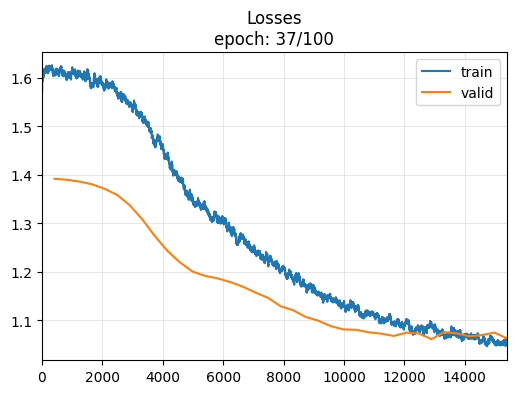

,train_loss,valid_loss,accuracy,balanced_accuracy_score
36,1.063592,1.062728,0.58275,0.58275


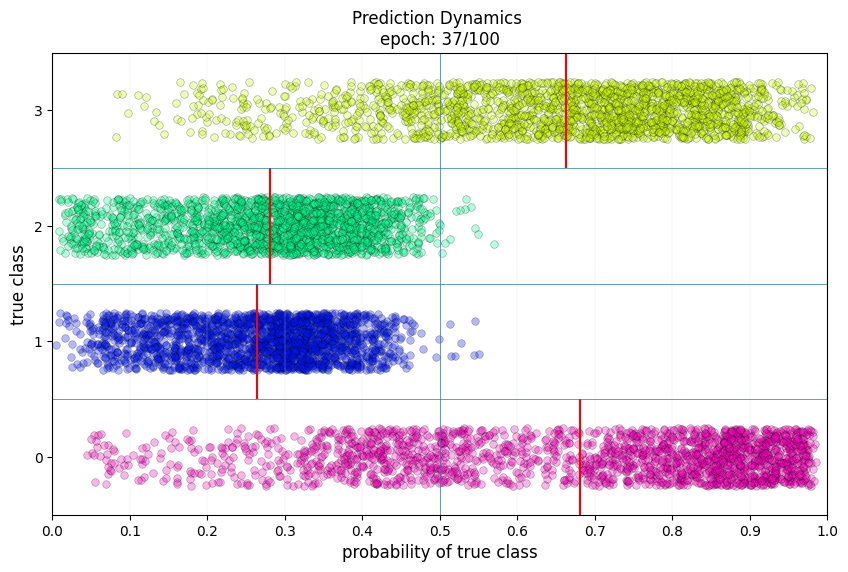

No improvement since epoch 30: early stopping


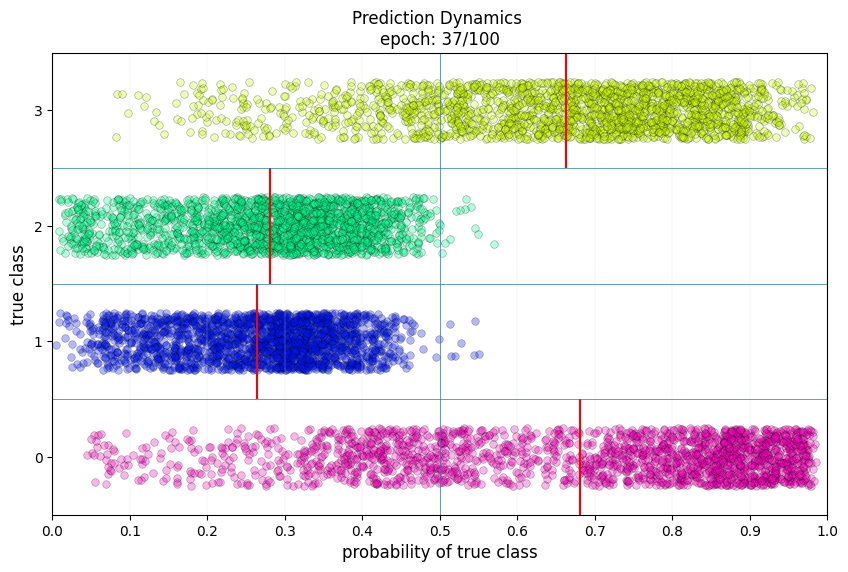

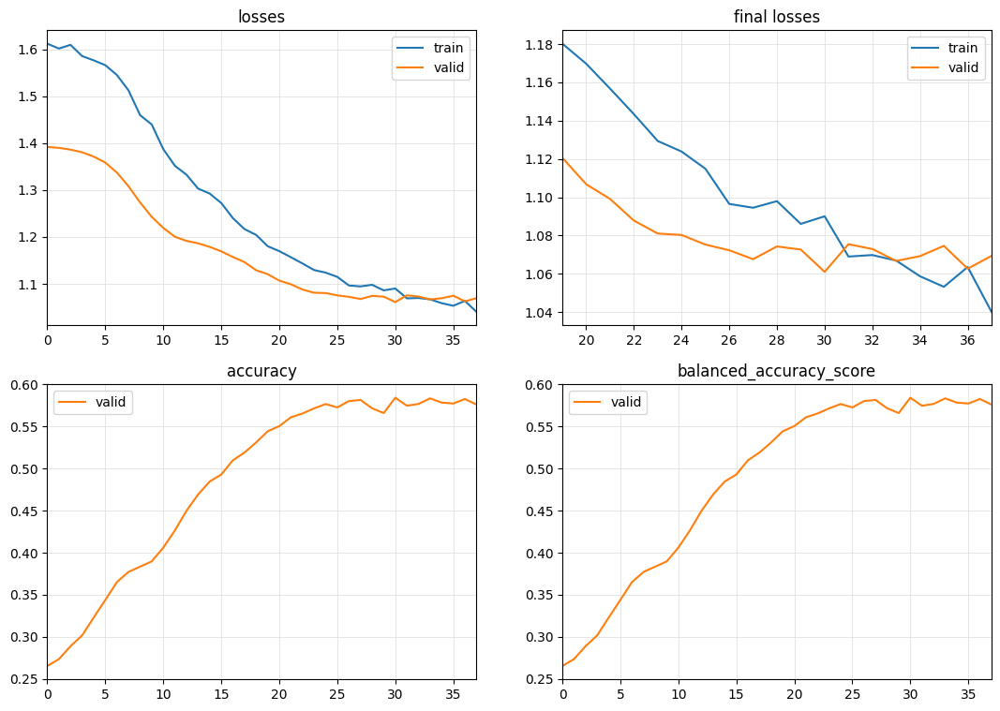

Accuracy: 0.576125
X.shape: (40000, 426, 112)
y.shape: (40000,)
Selected metric: accuracy
Computing feature importance (permutation method)...


  0 feature: BASELINE             accuracy: 0.598425


  0 feature: ABSV_1000mb_avg      accuracy: 0.598350


  1 feature: ABSV_1000mb_max      accuracy: 0.598350


  2 feature: ABSV_1000mb_min      accuracy: 0.598325


  3 feature: ABSV_100mb_max       accuracy: 0.598400


  4 feature: ABSV_10mb_max        accuracy: 0.598425


  5 feature: ABSV_150mb_avg       accuracy: 0.598250


  6 feature: ABSV_250mb_min       accuracy: 0.598125


  7 feature: ABSV_400mb_avg       accuracy: 0.598300


  8 feature: ABSV_450mb_min       accuracy: 0.597850


  9 feature: ABSV_500mb_avg       accuracy: 0.598475


 10 feature: ABSV_500mb_min       accuracy: 0.598100


 11 feature: ABSV_550mb_avg       accuracy: 0.598350


 12 feature: ABSV_600mb_avg       accuracy: 0.598200


 13 feature: ABSV_600mb_min       accuracy: 0.598300


 14 feature: ABSV_650mb_avg       accuracy: 0.598375


 15 feature: ABSV_650mb_max       accuracy: 0.598425


 16 feature: ABSV_700mb_avg       accuracy: 0.598225


 17 feature: ABSV_700mb_max       accuracy: 0.598275


 18 feature: ABSV_700mb_min       accuracy: 0.598450


 19 feature: ABSV_70mb_avg        accuracy: 0.598350


 20 feature: ABSV_70mb_min        accuracy: 0.598325


 21 feature: ABSV_750mb_avg       accuracy: 0.598000


 22 feature: ABSV_750mb_max       accuracy: 0.598200


 23 feature: ABSV_750mb_min       accuracy: 0.598150


 24 feature: ABSV_800mb_max       accuracy: 0.597975


 25 feature: ABSV_800mb_min       accuracy: 0.598025


 26 feature: ABSV_900mb_min       accuracy: 0.598350


 27 feature: ABSV_925mb_max       accuracy: 0.598400


 28 feature: ABSV_925mb_min       accuracy: 0.598475


 29 feature: ABSV_950mb_max       accuracy: 0.598325


 30 feature: ABSV_950mb_min       accuracy: 0.598375


 31 feature: ABSV_975mb_min       accuracy: 0.598275


 32 feature: ACPCP_surface_sum    accuracy: 0.598325


 33 feature: APCP_surface_sum     accuracy: 0.598850


 34 feature: APTMP_2maboveground_avg accuracy: 0.598425


 35 feature: APTMP_2maboveground_max accuracy: 0.598100


 36 feature: CAPE_255M0mbaboveground_max accuracy: 0.598325


 37 feature: CAPE_255M0mbaboveground_min accuracy: 0.598400


 38 feature: CAPE_surface_min     accuracy: 0.598450


 39 feature: CIN_180M0mbaboveground_min accuracy: 0.598600


 40 feature: CIN_255M0mbaboveground_max accuracy: 0.598475


 41 feature: CIN_surface_avg      accuracy: 0.598425


 42 feature: CPOFP_surface_avg    accuracy: 0.599400


 43 feature: CPOFP_surface_min    accuracy: 0.602375


 44 feature: DPT_2maboveground_avg accuracy: 0.598450


 45 feature: DPT_2maboveground_max accuracy: 0.598150


 46 feature: GUST_surface_avg     accuracy: 0.597525


 47 feature: GUST_surface_max     accuracy: 0.597500


 48 feature: GUST_surface_min     accuracy: 0.597850


 49 feature: HGT_0Cisotherm_avg   accuracy: 0.595725


 50 feature: HGT_100mb_min        accuracy: 0.598375


 51 feature: HGT_10mb_avg         accuracy: 0.598150


 52 feature: HGT_150mb_min        accuracy: 0.598300


 53 feature: HGT_200mb_avg        accuracy: 0.598125


 54 feature: HGT_200mb_max        accuracy: 0.598325


 55 feature: HGT_20mb_avg         accuracy: 0.598300


 56 feature: HGT_20mb_max         accuracy: 0.598250


 57 feature: HGT_250mb_max        accuracy: 0.597750


 58 feature: HGT_300mb_avg        accuracy: 0.598475


 59 feature: HGT_30mb_max         accuracy: 0.598150


 60 feature: HGT_350mb_max        accuracy: 0.598675


 61 feature: HGT_400mb_max        accuracy: 0.597850


 62 feature: HGT_400mb_min        accuracy: 0.598325


 63 feature: HGT_450mb_avg        accuracy: 0.598525


 64 feature: HGT_450mb_max        accuracy: 0.598475


 65 feature: HGT_500mb_avg        accuracy: 0.598050


 66 feature: HGT_500mb_min        accuracy: 0.598725


 67 feature: HGT_600mb_avg        accuracy: 0.598475


 68 feature: HGT_600mb_max        accuracy: 0.599075


 69 feature: HGT_650mb_avg        accuracy: 0.598975


 70 feature: HGT_650mb_max        accuracy: 0.598425


 71 feature: HGT_650mb_min        accuracy: 0.598200


 72 feature: HGT_700mb_avg        accuracy: 0.597275


 73 feature: HGT_700mb_min        accuracy: 0.598825


 74 feature: HGT_70mb_avg         accuracy: 0.598225


 75 feature: HGT_70mb_max         accuracy: 0.598425


 76 feature: HGT_800mb_max        accuracy: 0.598950


 77 feature: HGT_850mb_min        accuracy: 0.598675


 78 feature: HGT_900mb_avg        accuracy: 0.598100


 79 feature: HGT_900mb_max        accuracy: 0.598875


 80 feature: HGT_925mb_avg        accuracy: 0.600350


 81 feature: HGT_950mb_min        accuracy: 0.599625


 82 feature: HGT_975mb_max        accuracy: 0.598600


 83 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.598575


 84 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.598225


 85 feature: HGT_maxwind_min      accuracy: 0.597825


 86 feature: HGT_surface_avg      accuracy: 0.598450


 87 feature: HGT_tropopause_avg   accuracy: 0.598725


 88 feature: HGT_tropopause_max   accuracy: 0.599350


 89 feature: HINDEX_surface_avg   accuracy: 0.599075


 90 feature: HINDEX_surface_min   accuracy: 0.598400


 91 feature: HLCY_3000M0maboveground_avg accuracy: 0.598375


 92 feature: HLCY_3000M0maboveground_max accuracy: 0.598000


 93 feature: HLCY_3000M0maboveground_min accuracy: 0.598075


 94 feature: ICAHT_maxwind_min    accuracy: 0.597250


 95 feature: LAND_surface_avg     accuracy: 0.598225


 96 feature: LAND_surface_max     accuracy: 0.598250


 97 feature: LAND_surface_min     accuracy: 0.597625


 98 feature: POT_0D995sigmalevel_avg accuracy: 0.598500


 99 feature: POT_0D995sigmalevel_max accuracy: 0.598675


100 feature: POT_0D995sigmalevel_min accuracy: 0.598375


101 feature: PRES_80maboveground_avg accuracy: 0.598825


102 feature: PRES_80maboveground_max accuracy: 0.598350


103 feature: PRES_80maboveground_min accuracy: 0.598750


104 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.597950


105 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.598150


106 feature: PRES_maxwind_avg     accuracy: 0.598375


107 feature: PRES_maxwind_max     accuracy: 0.600475


108 feature: PRES_maxwind_min     accuracy: 0.598950


109 feature: PRES_surface_avg     accuracy: 0.598250


110 feature: PRES_surface_max     accuracy: 0.597525


111 feature: PRES_surface_min     accuracy: 0.597875


112 feature: PRES_tropopause_avg  accuracy: 0.599325


113 feature: PRES_tropopause_max  accuracy: 0.598675


114 feature: PRES_tropopause_min  accuracy: 0.597225


115 feature: RH_0Cisotherm_avg    accuracy: 0.598450


116 feature: RH_0Cisotherm_max    accuracy: 0.598575


117 feature: RH_0Cisotherm_min    accuracy: 0.596900


118 feature: RH_0D33M1sigmalayer_avg accuracy: 0.598825


119 feature: RH_0D33M1sigmalayer_min accuracy: 0.601725


120 feature: RH_0D44M0D72sigmalayer_avg accuracy: 0.596200


121 feature: RH_0D44M0D72sigmalayer_max accuracy: 0.604050


122 feature: RH_0D44M1sigmalayer_avg accuracy: 0.594300


123 feature: RH_0D44M1sigmalayer_max accuracy: 0.602975


124 feature: RH_0D72M0D94sigmalayer_avg accuracy: 0.602550


125 feature: RH_0D995sigmalevel_avg accuracy: 0.599950


126 feature: RH_0D995sigmalevel_min accuracy: 0.595800


127 feature: RH_1000mb_avg        accuracy: 0.599700


128 feature: RH_10mb_avg          accuracy: 0.598250


129 feature: RH_10mb_max          accuracy: 0.598200


130 feature: RH_150mb_avg         accuracy: 0.597175


131 feature: RH_150mb_max         accuracy: 0.599475


132 feature: RH_150mb_min         accuracy: 0.596200


133 feature: RH_200mb_avg         accuracy: 0.599050


134 feature: RH_200mb_max         accuracy: 0.595350


135 feature: RH_200mb_min         accuracy: 0.590400


136 feature: RH_20mb_avg          accuracy: 0.598550


137 feature: RH_250mb_avg         accuracy: 0.593800


138 feature: RH_250mb_max         accuracy: 0.598125


139 feature: RH_250mb_min         accuracy: 0.589525


140 feature: RH_2maboveground_avg accuracy: 0.598350


141 feature: RH_2maboveground_max accuracy: 0.599850


142 feature: RH_2maboveground_min accuracy: 0.600400


143 feature: RH_300mb_min         accuracy: 0.597300


144 feature: RH_30mb_avg          accuracy: 0.598050


145 feature: RH_30mb_max          accuracy: 0.597925


146 feature: RH_350mb_avg         accuracy: 0.598725


147 feature: RH_350mb_min         accuracy: 0.597075


148 feature: RH_400mb_avg         accuracy: 0.599925


149 feature: RH_400mb_min         accuracy: 0.599300


150 feature: RH_500mb_avg         accuracy: 0.597325


151 feature: RH_500mb_max         accuracy: 0.602575


152 feature: RH_50mb_avg          accuracy: 0.597975


153 feature: RH_50mb_max          accuracy: 0.598125


154 feature: RH_50mb_min          accuracy: 0.597900


155 feature: RH_550mb_avg         accuracy: 0.597075


156 feature: RH_550mb_min         accuracy: 0.599750


157 feature: RH_600mb_max         accuracy: 0.598150


158 feature: RH_600mb_min         accuracy: 0.597350


159 feature: RH_650mb_max         accuracy: 0.598125


160 feature: RH_650mb_min         accuracy: 0.593850


161 feature: RH_70mb_avg          accuracy: 0.598075


162 feature: RH_70mb_min          accuracy: 0.598250


163 feature: RH_750mb_avg         accuracy: 0.601000


164 feature: RH_750mb_max         accuracy: 0.598075


165 feature: RH_750mb_min         accuracy: 0.599300


166 feature: RH_800mb_min         accuracy: 0.602600


167 feature: RH_850mb_max         accuracy: 0.600500


168 feature: RH_900mb_max         accuracy: 0.598200


169 feature: RH_900mb_min         accuracy: 0.595425


170 feature: RH_925mb_avg         accuracy: 0.594425


171 feature: RH_925mb_max         accuracy: 0.593925


172 feature: RH_925mb_min         accuracy: 0.596975


173 feature: RH_950mb_avg         accuracy: 0.594550


174 feature: RH_950mb_max         accuracy: 0.595875


175 feature: RH_950mb_min         accuracy: 0.597525


176 feature: RH_975mb_avg         accuracy: 0.598700


177 feature: RH_975mb_min         accuracy: 0.602250


178 feature: SNOD_surface_avg     accuracy: 0.598400


179 feature: SNOD_surface_max     accuracy: 0.598525


180 feature: SNOD_surface_min     accuracy: 0.598375


181 feature: SPFH_2maboveground_avg accuracy: 0.597150


182 feature: SPFH_2maboveground_max accuracy: 0.597375


183 feature: SPFH_2maboveground_min accuracy: 0.597125


184 feature: SPFH_30M0mbaboveground_min accuracy: 0.599200


185 feature: SPFH_80maboveground_avg accuracy: 0.598000


186 feature: SPFH_80maboveground_max accuracy: 0.597950


187 feature: SPFH_80maboveground_min accuracy: 0.596600


188 feature: TMP_0D995sigmalevel_max accuracy: 0.598300


189 feature: TMP_0D995sigmalevel_min accuracy: 0.598225


190 feature: TMP_1000mb_avg       accuracy: 0.598225


191 feature: TMP_1000mb_min       accuracy: 0.597925


192 feature: TMP_100maboveground_avg accuracy: 0.598150


193 feature: TMP_100maboveground_min accuracy: 0.597875


194 feature: TMP_100mb_min        accuracy: 0.597725


195 feature: TMP_150mb_avg        accuracy: 0.597725


196 feature: TMP_150mb_max        accuracy: 0.598475


197 feature: TMP_1829mabovemeansealevel_max accuracy: 0.593175


198 feature: TMP_1829mabovemeansealevel_min accuracy: 0.595425


199 feature: TMP_200mb_max        accuracy: 0.598200


200 feature: TMP_200mb_min        accuracy: 0.597925


201 feature: TMP_250mb_avg        accuracy: 0.598000


202 feature: TMP_250mb_min        accuracy: 0.598200


203 feature: TMP_2743mabovemeansealevel_avg accuracy: 0.596300


204 feature: TMP_2743mabovemeansealevel_min accuracy: 0.596725


205 feature: TMP_2maboveground_max accuracy: 0.597925


206 feature: TMP_2maboveground_min accuracy: 0.598025


207 feature: TMP_300mb_avg        accuracy: 0.597975


208 feature: TMP_30M0mbaboveground_avg accuracy: 0.598200


209 feature: TMP_30M0mbaboveground_max accuracy: 0.598275


210 feature: TMP_30M0mbaboveground_min accuracy: 0.598150


211 feature: TMP_30mb_min         accuracy: 0.598350


212 feature: TMP_350mb_max        accuracy: 0.597475


213 feature: TMP_350mb_min        accuracy: 0.598700


214 feature: TMP_400mb_avg        accuracy: 0.597600


215 feature: TMP_450mb_avg        accuracy: 0.597450


216 feature: TMP_450mb_max        accuracy: 0.598400


217 feature: TMP_450mb_min        accuracy: 0.598200


218 feature: TMP_500mb_min        accuracy: 0.598575


219 feature: TMP_50mb_avg         accuracy: 0.598825


220 feature: TMP_50mb_max         accuracy: 0.598175


221 feature: TMP_550mb_avg        accuracy: 0.598300


222 feature: TMP_600mb_avg        accuracy: 0.598125


223 feature: TMP_600mb_max        accuracy: 0.598275


224 feature: TMP_600mb_min        accuracy: 0.597900


225 feature: TMP_650mb_avg        accuracy: 0.598525


226 feature: TMP_650mb_min        accuracy: 0.598400


227 feature: TMP_700mb_avg        accuracy: 0.598250


228 feature: TMP_700mb_min        accuracy: 0.598625


229 feature: TMP_70mb_avg         accuracy: 0.598575


230 feature: TMP_70mb_max         accuracy: 0.598000


231 feature: TMP_750mb_avg        accuracy: 0.598375


232 feature: TMP_800mb_avg        accuracy: 0.598525


233 feature: TMP_800mb_max        accuracy: 0.598275


234 feature: TMP_80maboveground_avg accuracy: 0.598375


235 feature: TMP_850mb_max        accuracy: 0.597825


236 feature: TMP_900mb_avg        accuracy: 0.598025


237 feature: TMP_900mb_min        accuracy: 0.598125


238 feature: TMP_925mb_avg        accuracy: 0.598175


239 feature: TMP_925mb_max        accuracy: 0.598450


240 feature: TMP_950mb_max        accuracy: 0.598500


241 feature: TMP_975mb_min        accuracy: 0.598100


242 feature: TMP_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.598350


243 feature: TMP_maxwind_avg      accuracy: 0.598300


244 feature: TMP_maxwind_max      accuracy: 0.598275


245 feature: TMP_maxwind_min      accuracy: 0.598175


246 feature: TMP_surface_avg      accuracy: 0.598000


247 feature: TMP_surface_max      accuracy: 0.597825


248 feature: TMP_surface_min      accuracy: 0.598225


249 feature: TMP_tropopause_avg   accuracy: 0.598450


250 feature: TMP_tropopause_min   accuracy: 0.598200


251 feature: TSOIL_0D1M0D4mbelowground_max accuracy: 0.597175


252 feature: TSOIL_0D1M0D4mbelowground_min accuracy: 0.598000


253 feature: TSOIL_0D4M1mbelowground_avg accuracy: 0.598525


254 feature: TSOIL_0D4M1mbelowground_max accuracy: 0.598425


255 feature: TSOIL_0M0D1mbelowground_max accuracy: 0.598025


256 feature: TSOIL_0M0D1mbelowground_min accuracy: 0.597950


257 feature: TSOIL_1M2mbelowground_avg accuracy: 0.598375


258 feature: TSOIL_1M2mbelowground_max accuracy: 0.598125


259 feature: UGRD_1000mb_avg      accuracy: 0.598250


260 feature: UGRD_100maboveground_avg accuracy: 0.598275


261 feature: UGRD_100maboveground_max accuracy: 0.597850


262 feature: UGRD_100mb_avg       accuracy: 0.597950


263 feature: UGRD_100mb_max       accuracy: 0.597775


264 feature: UGRD_100mb_min       accuracy: 0.598550


265 feature: UGRD_10mb_avg        accuracy: 0.596300


266 feature: UGRD_10mb_max        accuracy: 0.596775


267 feature: UGRD_10mb_min        accuracy: 0.598350


268 feature: UGRD_150mb_avg       accuracy: 0.597850


269 feature: UGRD_150mb_max       accuracy: 0.597425


270 feature: UGRD_150mb_min       accuracy: 0.598325


271 feature: UGRD_1829mabovemeansealevel_avg accuracy: 0.595350


272 feature: UGRD_1829mabovemeansealevel_max accuracy: 0.599475


273 feature: UGRD_1829mabovemeansealevel_min accuracy: 0.599200


274 feature: UGRD_200mb_avg       accuracy: 0.598050


275 feature: UGRD_200mb_min       accuracy: 0.598250


276 feature: UGRD_20mb_avg        accuracy: 0.597975


277 feature: UGRD_20mb_max        accuracy: 0.597775


278 feature: UGRD_20mb_min        accuracy: 0.598250


279 feature: UGRD_250mb_avg       accuracy: 0.599225


280 feature: UGRD_250mb_max       accuracy: 0.599175


281 feature: UGRD_250mb_min       accuracy: 0.598325


282 feature: UGRD_2743mabovemeansealevel_max accuracy: 0.599050


283 feature: UGRD_2743mabovemeansealevel_min accuracy: 0.599825


284 feature: UGRD_300mb_min       accuracy: 0.598000


285 feature: UGRD_30M0mbaboveground_avg accuracy: 0.598350


286 feature: UGRD_30M0mbaboveground_max accuracy: 0.598050


287 feature: UGRD_30M0mbaboveground_min accuracy: 0.598125


288 feature: UGRD_30mb_max        accuracy: 0.598900


289 feature: UGRD_30mb_min        accuracy: 0.598900


290 feature: UGRD_350mb_avg       accuracy: 0.597525


291 feature: UGRD_350mb_max       accuracy: 0.599350


292 feature: UGRD_400mb_max       accuracy: 0.598800


293 feature: UGRD_450mb_avg       accuracy: 0.596575


294 feature: UGRD_450mb_max       accuracy: 0.597625


295 feature: UGRD_500mb_max       accuracy: 0.597800


296 feature: UGRD_500mb_min       accuracy: 0.597725


297 feature: UGRD_50mb_max        accuracy: 0.598325


298 feature: UGRD_50mb_min        accuracy: 0.598250


299 feature: UGRD_550mb_avg       accuracy: 0.598675


300 feature: UGRD_550mb_max       accuracy: 0.598975


301 feature: UGRD_550mb_min       accuracy: 0.599625


302 feature: UGRD_600mb_avg       accuracy: 0.598375


303 feature: UGRD_600mb_max       accuracy: 0.596250


304 feature: UGRD_650mb_avg       accuracy: 0.597675


305 feature: UGRD_650mb_max       accuracy: 0.598725


306 feature: UGRD_650mb_min       accuracy: 0.598125


307 feature: UGRD_700mb_avg       accuracy: 0.598275


308 feature: UGRD_700mb_max       accuracy: 0.598575


309 feature: UGRD_70mb_avg        accuracy: 0.597075


310 feature: UGRD_70mb_min        accuracy: 0.597700


311 feature: UGRD_750mb_max       accuracy: 0.597725


312 feature: UGRD_750mb_min       accuracy: 0.598275


313 feature: UGRD_800mb_max       accuracy: 0.598575


314 feature: UGRD_80maboveground_avg accuracy: 0.597700


315 feature: UGRD_80maboveground_max accuracy: 0.598125


316 feature: UGRD_80maboveground_min accuracy: 0.598150


317 feature: UGRD_850mb_avg       accuracy: 0.598425


318 feature: UGRD_850mb_max       accuracy: 0.597900


319 feature: UGRD_850mb_min       accuracy: 0.598200


320 feature: UGRD_900mb_avg       accuracy: 0.598025


321 feature: UGRD_900mb_min       accuracy: 0.598400


322 feature: UGRD_925mb_avg       accuracy: 0.598275


323 feature: UGRD_925mb_min       accuracy: 0.598350


324 feature: UGRD_950mb_avg       accuracy: 0.598450


325 feature: UGRD_950mb_max       accuracy: 0.598125


326 feature: UGRD_975mb_max       accuracy: 0.597950


327 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.598350


328 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.598125


329 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.597725


330 feature: UGRD_maxwind_avg     accuracy: 0.598975


331 feature: UGRD_maxwind_max     accuracy: 0.599300


332 feature: UGRD_maxwind_min     accuracy: 0.597650


333 feature: UGRD_tropopause_max  accuracy: 0.598600


334 feature: UGRD_tropopause_min  accuracy: 0.597775


335 feature: VGRD_0D995sigmalevel_avg accuracy: 0.598525


336 feature: VGRD_1000mb_avg      accuracy: 0.598275


337 feature: VGRD_100mb_avg       accuracy: 0.597700


338 feature: VGRD_100mb_max       accuracy: 0.598325


339 feature: VGRD_100mb_min       accuracy: 0.598100


340 feature: VGRD_10maboveground_avg accuracy: 0.597900


341 feature: VGRD_10mb_avg        accuracy: 0.598500


342 feature: VGRD_10mb_max        accuracy: 0.596575


343 feature: VGRD_10mb_min        accuracy: 0.598375


344 feature: VGRD_150mb_max       accuracy: 0.598800


345 feature: VGRD_150mb_min       accuracy: 0.597325


346 feature: VGRD_1829mabovemeansealevel_avg accuracy: 0.600200


347 feature: VGRD_1829mabovemeansealevel_max accuracy: 0.600100


348 feature: VGRD_1829mabovemeansealevel_min accuracy: 0.598825


349 feature: VGRD_200mb_avg       accuracy: 0.597625


350 feature: VGRD_200mb_max       accuracy: 0.598200


351 feature: VGRD_200mb_min       accuracy: 0.598975


352 feature: VGRD_20mb_avg        accuracy: 0.597650


353 feature: VGRD_20mb_max        accuracy: 0.596825


354 feature: VGRD_250mb_avg       accuracy: 0.599650


355 feature: VGRD_250mb_min       accuracy: 0.599675


356 feature: VGRD_2743mabovemeansealevel_max accuracy: 0.598225


357 feature: VGRD_300mb_max       accuracy: 0.599175


358 feature: VGRD_30M0mbaboveground_min accuracy: 0.598025


359 feature: VGRD_30mb_avg        accuracy: 0.596700


360 feature: VGRD_30mb_max        accuracy: 0.596400


361 feature: VGRD_30mb_min        accuracy: 0.598900


362 feature: VGRD_350mb_max       accuracy: 0.598875


363 feature: VGRD_350mb_min       accuracy: 0.596975


364 feature: VGRD_3658mabovemeansealevel_avg accuracy: 0.598525


365 feature: VGRD_3658mabovemeansealevel_max accuracy: 0.596900


366 feature: VGRD_400mb_max       accuracy: 0.599525


367 feature: VGRD_400mb_min       accuracy: 0.598175


368 feature: VGRD_500mb_avg       accuracy: 0.598525


369 feature: VGRD_500mb_max       accuracy: 0.598375


370 feature: VGRD_500mb_min       accuracy: 0.598775


371 feature: VGRD_50mb_avg        accuracy: 0.597575


372 feature: VGRD_50mb_max        accuracy: 0.597650


373 feature: VGRD_550mb_avg       accuracy: 0.600650


374 feature: VGRD_550mb_max       accuracy: 0.598375


375 feature: VGRD_650mb_min       accuracy: 0.599775


376 feature: VGRD_700mb_max       accuracy: 0.598250


377 feature: VGRD_70mb_avg        accuracy: 0.598175


378 feature: VGRD_70mb_max        accuracy: 0.598850


379 feature: VGRD_70mb_min        accuracy: 0.597925


380 feature: VGRD_800mb_avg       accuracy: 0.597275


381 feature: VGRD_800mb_max       accuracy: 0.599725


382 feature: VGRD_80maboveground_avg accuracy: 0.597925


383 feature: VGRD_80maboveground_max accuracy: 0.598250


384 feature: VGRD_850mb_max       accuracy: 0.597775


385 feature: VGRD_900mb_avg       accuracy: 0.597975


386 feature: VGRD_900mb_min       accuracy: 0.598425


387 feature: VGRD_925mb_max       accuracy: 0.598400


388 feature: VGRD_950mb_avg       accuracy: 0.598400


389 feature: VGRD_975mb_max       accuracy: 0.598250


390 feature: VGRD_975mb_min       accuracy: 0.598275


391 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.599425


392 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.597650


393 feature: VGRD_maxwind_max     accuracy: 0.597525


394 feature: VGRD_maxwind_min     accuracy: 0.598225


395 feature: VGRD_tropopause_min  accuracy: 0.597400


396 feature: VVEL_1000mb_max      accuracy: 0.598575


397 feature: VVEL_1000mb_min      accuracy: 0.598600


398 feature: VVEL_100mb_min       accuracy: 0.598450


399 feature: VVEL_300mb_max       accuracy: 0.597975


400 feature: VVEL_300mb_min       accuracy: 0.598350


401 feature: VVEL_450mb_max       accuracy: 0.598500


402 feature: VVEL_500mb_min       accuracy: 0.598250


403 feature: VVEL_550mb_min       accuracy: 0.598100


404 feature: VVEL_600mb_max       accuracy: 0.598275


405 feature: VVEL_650mb_avg       accuracy: 0.598100


406 feature: VVEL_650mb_max       accuracy: 0.598550


407 feature: VVEL_650mb_min       accuracy: 0.597575


408 feature: VVEL_700mb_avg       accuracy: 0.598250


409 feature: VVEL_700mb_max       accuracy: 0.598250


410 feature: VVEL_700mb_min       accuracy: 0.598100


411 feature: VVEL_750mb_avg       accuracy: 0.598275


412 feature: VVEL_750mb_min       accuracy: 0.597975


413 feature: VVEL_800mb_max       accuracy: 0.598025


414 feature: VVEL_850mb_avg       accuracy: 0.598525


415 feature: VVEL_900mb_avg       accuracy: 0.598900


416 feature: VVEL_925mb_avg       accuracy: 0.598400


417 feature: VVEL_925mb_min       accuracy: 0.598475


418 feature: VVEL_950mb_avg       accuracy: 0.598075


419 feature: VVEL_950mb_max       accuracy: 0.598200


420 feature: VVEL_950mb_min       accuracy: 0.598400


421 feature: VVEL_975mb_max       accuracy: 0.598275


422 feature: VVEL_975mb_min       accuracy: 0.598500


423 feature: WATR_surface_sum     accuracy: 0.598100


424 feature: WEASD_surface_avg    accuracy: 0.597875


425 feature: WEASD_surface_min    accuracy: 0.598550



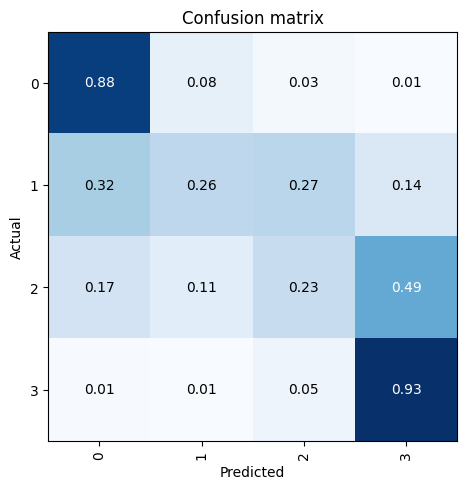

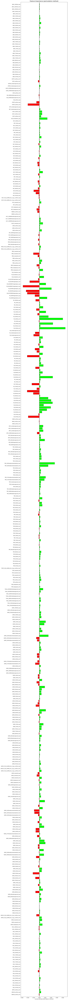

In [137]:
learn = simplify_features(14, 'ca_co_day1above_3h_84d_allvars_small', 0, .58, .01)

288 features remaining


epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.611183,1.385901,0.254500,0.254500,00:43
1,1.601899,1.382380,0.267250,0.267250,00:43
2,1.604723,1.377869,0.280500,0.280500,00:44
3,1.594772,1.371792,0.300250,0.300250,00:44
4,1.576077,1.363056,0.329250,0.329250,00:44
5,1.560149,1.351256,0.361500,0.361500,00:44
6,1.546765,1.333808,0.390375,0.390375,00:44
7,1.497607,1.309090,0.415750,0.415750,00:45
8,1.474469,1.275823,0.440250,0.440250,00:45
9,1.433116,1.235506,0.452625,0.452625,00:44


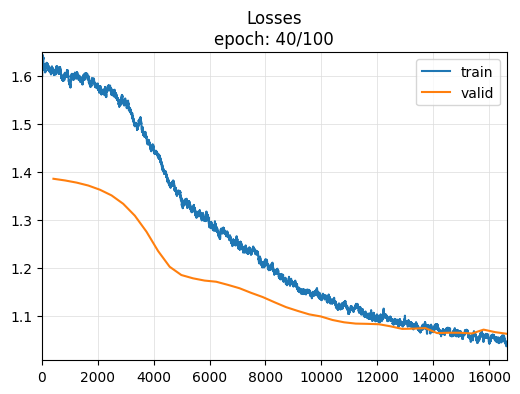

,train_loss,valid_loss,accuracy,balanced_accuracy_score
39,1.038623,1.063217,0.57925,0.57925


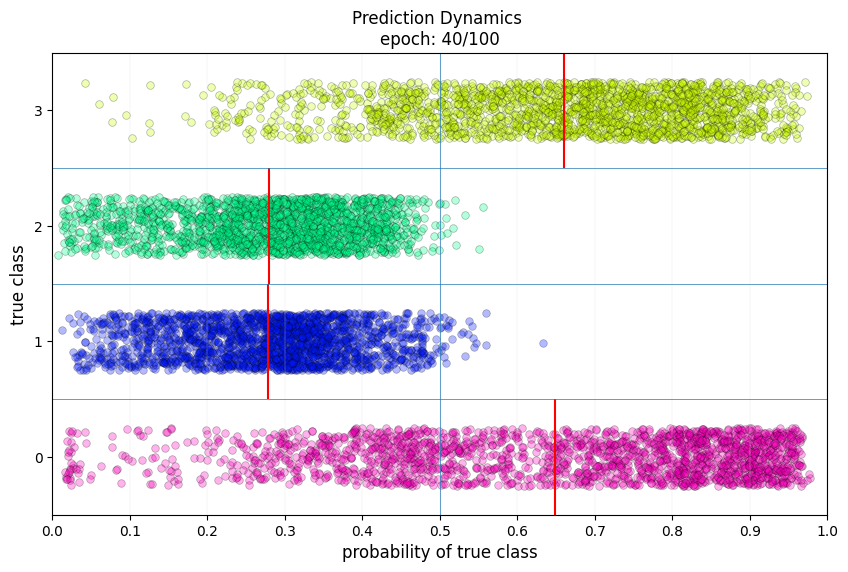

No improvement since epoch 33: early stopping


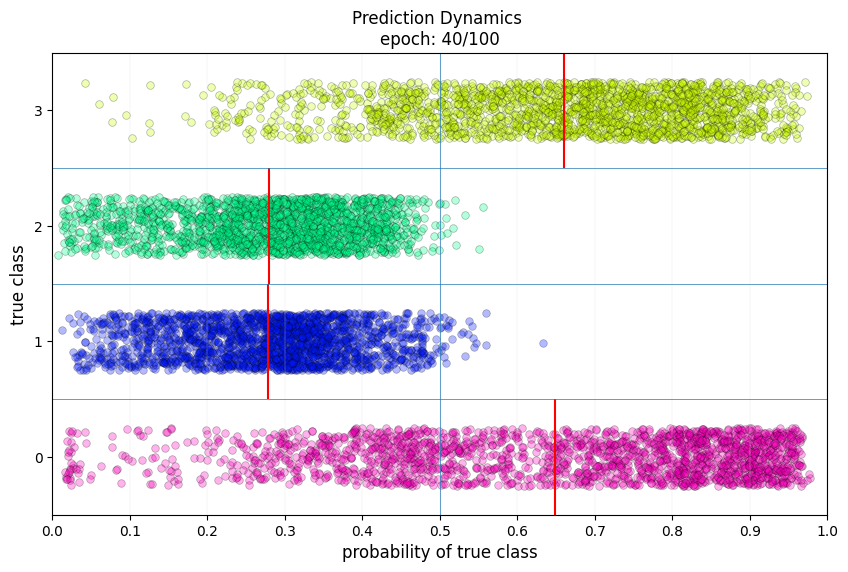

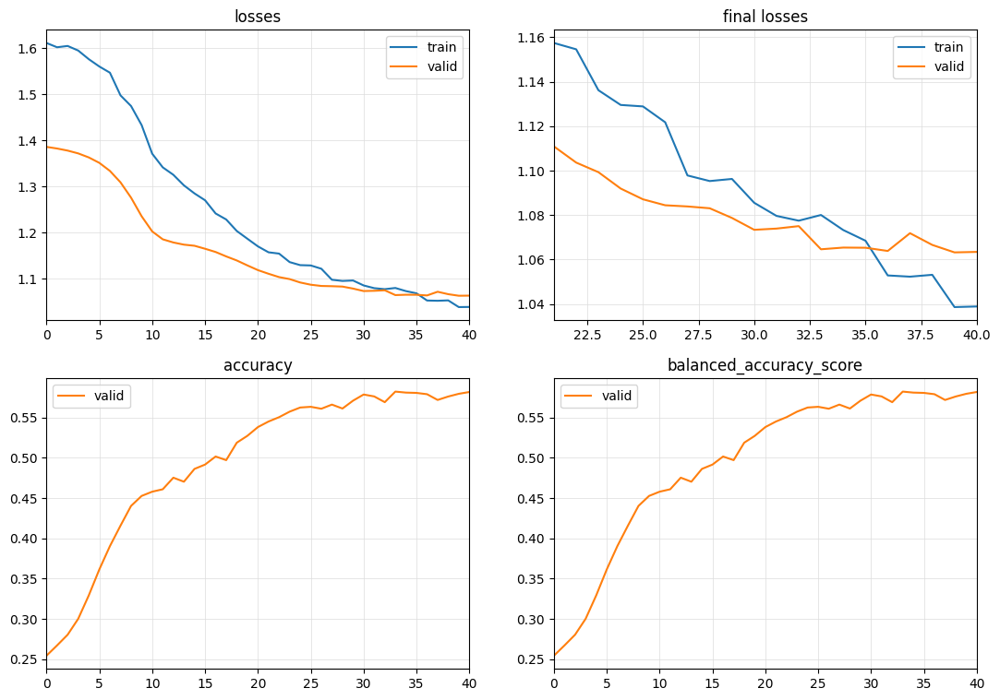

Accuracy: 0.5815
X.shape: (40000, 288, 112)
y.shape: (40000,)
Selected metric: accuracy
Computing feature importance (permutation method)...


  0 feature: BASELINE             accuracy: 0.606975


  0 feature: ABSV_1000mb_avg      accuracy: 0.607100


  1 feature: ABSV_1000mb_max      accuracy: 0.606350


  2 feature: ABSV_1000mb_min      accuracy: 0.606475


  3 feature: ABSV_100mb_max       accuracy: 0.606750


  4 feature: ABSV_150mb_avg       accuracy: 0.607175


  5 feature: ABSV_250mb_min       accuracy: 0.607000


  6 feature: ABSV_400mb_avg       accuracy: 0.606825


  7 feature: ABSV_450mb_min       accuracy: 0.606750


  8 feature: ABSV_500mb_min       accuracy: 0.607550


  9 feature: ABSV_550mb_avg       accuracy: 0.607175


 10 feature: ABSV_600mb_avg       accuracy: 0.607025


 11 feature: ABSV_600mb_min       accuracy: 0.606975


 12 feature: ABSV_650mb_avg       accuracy: 0.607125


 13 feature: ABSV_700mb_avg       accuracy: 0.606875


 14 feature: ABSV_700mb_max       accuracy: 0.606950


 15 feature: ABSV_70mb_avg        accuracy: 0.607000


 16 feature: ABSV_70mb_min        accuracy: 0.607025


 17 feature: ABSV_750mb_avg       accuracy: 0.607325


 18 feature: ABSV_750mb_max       accuracy: 0.606900


 19 feature: ABSV_750mb_min       accuracy: 0.606850


 20 feature: ABSV_800mb_max       accuracy: 0.606575


 21 feature: ABSV_800mb_min       accuracy: 0.606750


 22 feature: ABSV_900mb_min       accuracy: 0.606375


 23 feature: ABSV_925mb_max       accuracy: 0.607125


 24 feature: ABSV_950mb_max       accuracy: 0.606725


 25 feature: ABSV_950mb_min       accuracy: 0.607100


 26 feature: ABSV_975mb_min       accuracy: 0.606775


 27 feature: ACPCP_surface_sum    accuracy: 0.607025


 28 feature: APTMP_2maboveground_max accuracy: 0.606900


 29 feature: CAPE_255M0mbaboveground_max accuracy: 0.606825


 30 feature: CAPE_255M0mbaboveground_min accuracy: 0.606775


 31 feature: DPT_2maboveground_max accuracy: 0.606550


 32 feature: GUST_surface_avg     accuracy: 0.607325


 33 feature: GUST_surface_max     accuracy: 0.606775


 34 feature: GUST_surface_min     accuracy: 0.606350


 35 feature: HGT_0Cisotherm_avg   accuracy: 0.605200


 36 feature: HGT_100mb_min        accuracy: 0.606900


 37 feature: HGT_10mb_avg         accuracy: 0.606975


 38 feature: HGT_150mb_min        accuracy: 0.607125


 39 feature: HGT_200mb_avg        accuracy: 0.607500


 40 feature: HGT_200mb_max        accuracy: 0.606900


 41 feature: HGT_20mb_avg         accuracy: 0.606950


 42 feature: HGT_20mb_max         accuracy: 0.607100


 43 feature: HGT_250mb_max        accuracy: 0.607250


 44 feature: HGT_30mb_max         accuracy: 0.607050


 45 feature: HGT_400mb_max        accuracy: 0.607075


 46 feature: HGT_400mb_min        accuracy: 0.607400


 47 feature: HGT_500mb_avg        accuracy: 0.606925


 48 feature: HGT_650mb_min        accuracy: 0.607300


 49 feature: HGT_700mb_avg        accuracy: 0.606650


 50 feature: HGT_70mb_avg         accuracy: 0.607050


 51 feature: HGT_900mb_avg        accuracy: 0.608450


 52 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.608725


 53 feature: HGT_maxwind_min      accuracy: 0.608425


 54 feature: HINDEX_surface_min   accuracy: 0.606550


 55 feature: HLCY_3000M0maboveground_avg accuracy: 0.607250


 56 feature: HLCY_3000M0maboveground_max accuracy: 0.607275


 57 feature: HLCY_3000M0maboveground_min accuracy: 0.607000


 58 feature: ICAHT_maxwind_min    accuracy: 0.607025


 59 feature: LAND_surface_avg     accuracy: 0.603375


 60 feature: LAND_surface_max     accuracy: 0.605625


 61 feature: LAND_surface_min     accuracy: 0.606600


 62 feature: POT_0D995sigmalevel_min accuracy: 0.607750


 63 feature: PRES_80maboveground_max accuracy: 0.607400


 64 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.606725


 65 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.606250


 66 feature: PRES_maxwind_avg     accuracy: 0.607250


 67 feature: PRES_surface_avg     accuracy: 0.608200


 68 feature: PRES_surface_max     accuracy: 0.607225


 69 feature: PRES_surface_min     accuracy: 0.606500


 70 feature: PRES_tropopause_min  accuracy: 0.604700


 71 feature: RH_0Cisotherm_min    accuracy: 0.609150


 72 feature: RH_0D44M0D72sigmalayer_avg accuracy: 0.606025


 73 feature: RH_0D44M1sigmalayer_avg accuracy: 0.609025


 74 feature: RH_0D995sigmalevel_min accuracy: 0.606975


 75 feature: RH_10mb_avg          accuracy: 0.606600


 76 feature: RH_10mb_max          accuracy: 0.606650


 77 feature: RH_150mb_avg         accuracy: 0.606200


 78 feature: RH_150mb_min         accuracy: 0.605750


 79 feature: RH_200mb_max         accuracy: 0.603075


 80 feature: RH_200mb_min         accuracy: 0.604500


 81 feature: RH_250mb_avg         accuracy: 0.606800


 82 feature: RH_250mb_max         accuracy: 0.599925


 83 feature: RH_250mb_min         accuracy: 0.603800


 84 feature: RH_2maboveground_avg accuracy: 0.608325


 85 feature: RH_300mb_min         accuracy: 0.604800


 86 feature: RH_30mb_avg          accuracy: 0.606600


 87 feature: RH_30mb_max          accuracy: 0.607275


 88 feature: RH_350mb_min         accuracy: 0.606675


 89 feature: RH_500mb_avg         accuracy: 0.607975


 90 feature: RH_50mb_avg          accuracy: 0.606925


 91 feature: RH_50mb_max          accuracy: 0.606925


 92 feature: RH_50mb_min          accuracy: 0.607125


 93 feature: RH_550mb_avg         accuracy: 0.610225


 94 feature: RH_600mb_max         accuracy: 0.605125


 95 feature: RH_600mb_min         accuracy: 0.606000


 96 feature: RH_650mb_max         accuracy: 0.603400


 97 feature: RH_650mb_min         accuracy: 0.603975


 98 feature: RH_70mb_avg          accuracy: 0.606550


 99 feature: RH_70mb_min          accuracy: 0.606700


100 feature: RH_750mb_max         accuracy: 0.613175


101 feature: RH_900mb_max         accuracy: 0.601600


102 feature: RH_900mb_min         accuracy: 0.606850


103 feature: RH_925mb_avg         accuracy: 0.610700


104 feature: RH_925mb_max         accuracy: 0.608400


105 feature: RH_925mb_min         accuracy: 0.605925


106 feature: RH_950mb_avg         accuracy: 0.607625


107 feature: RH_950mb_max         accuracy: 0.608875


108 feature: RH_950mb_min         accuracy: 0.602425


109 feature: SNOD_surface_avg     accuracy: 0.607100


110 feature: SNOD_surface_min     accuracy: 0.608225


111 feature: SPFH_2maboveground_avg accuracy: 0.605875


112 feature: SPFH_2maboveground_max accuracy: 0.605800


113 feature: SPFH_2maboveground_min accuracy: 0.608525


114 feature: SPFH_80maboveground_avg accuracy: 0.607750


115 feature: SPFH_80maboveground_max accuracy: 0.605950


116 feature: SPFH_80maboveground_min accuracy: 0.604350


117 feature: TMP_0D995sigmalevel_max accuracy: 0.607175


118 feature: TMP_0D995sigmalevel_min accuracy: 0.606550


119 feature: TMP_1000mb_avg       accuracy: 0.606775


120 feature: TMP_1000mb_min       accuracy: 0.607125


121 feature: TMP_100maboveground_avg accuracy: 0.606750


122 feature: TMP_100maboveground_min accuracy: 0.606575


123 feature: TMP_100mb_min        accuracy: 0.607600


124 feature: TMP_150mb_avg        accuracy: 0.606825


125 feature: TMP_1829mabovemeansealevel_max accuracy: 0.602875


126 feature: TMP_1829mabovemeansealevel_min accuracy: 0.595750


127 feature: TMP_200mb_max        accuracy: 0.607025


128 feature: TMP_200mb_min        accuracy: 0.606950


129 feature: TMP_250mb_avg        accuracy: 0.606550


130 feature: TMP_250mb_min        accuracy: 0.607025


131 feature: TMP_2743mabovemeansealevel_avg accuracy: 0.609400


132 feature: TMP_2743mabovemeansealevel_min accuracy: 0.603950


133 feature: TMP_2maboveground_max accuracy: 0.606900


134 feature: TMP_2maboveground_min accuracy: 0.606600


135 feature: TMP_300mb_avg        accuracy: 0.606650


136 feature: TMP_30M0mbaboveground_avg accuracy: 0.606775


137 feature: TMP_30M0mbaboveground_max accuracy: 0.606875


138 feature: TMP_30M0mbaboveground_min accuracy: 0.606850


139 feature: TMP_30mb_min         accuracy: 0.606200


140 feature: TMP_350mb_max        accuracy: 0.606650


141 feature: TMP_400mb_avg        accuracy: 0.606775


142 feature: TMP_450mb_avg        accuracy: 0.606775


143 feature: TMP_450mb_max        accuracy: 0.607100


144 feature: TMP_450mb_min        accuracy: 0.606850


145 feature: TMP_50mb_max         accuracy: 0.607550


146 feature: TMP_550mb_avg        accuracy: 0.606250


147 feature: TMP_600mb_avg        accuracy: 0.607475


148 feature: TMP_600mb_max        accuracy: 0.607375


149 feature: TMP_600mb_min        accuracy: 0.606625


150 feature: TMP_650mb_min        accuracy: 0.607450


151 feature: TMP_700mb_avg        accuracy: 0.606675


152 feature: TMP_70mb_max         accuracy: 0.606550


153 feature: TMP_750mb_avg        accuracy: 0.606625


154 feature: TMP_800mb_max        accuracy: 0.607175


155 feature: TMP_80maboveground_avg accuracy: 0.606550


156 feature: TMP_850mb_max        accuracy: 0.606275


157 feature: TMP_900mb_avg        accuracy: 0.606850


158 feature: TMP_900mb_min        accuracy: 0.607050


159 feature: TMP_925mb_avg        accuracy: 0.607225


160 feature: TMP_975mb_min        accuracy: 0.606800


161 feature: TMP_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.606825


162 feature: TMP_maxwind_avg      accuracy: 0.606400


163 feature: TMP_maxwind_max      accuracy: 0.606975


164 feature: TMP_maxwind_min      accuracy: 0.606475


165 feature: TMP_surface_avg      accuracy: 0.607325


166 feature: TMP_surface_max      accuracy: 0.606750


167 feature: TMP_surface_min      accuracy: 0.607300


168 feature: TMP_tropopause_min   accuracy: 0.607175


169 feature: TSOIL_0D1M0D4mbelowground_max accuracy: 0.606850


170 feature: TSOIL_0D1M0D4mbelowground_min accuracy: 0.606975


171 feature: TSOIL_0M0D1mbelowground_max accuracy: 0.606650


172 feature: TSOIL_0M0D1mbelowground_min accuracy: 0.606700


173 feature: TSOIL_1M2mbelowground_avg accuracy: 0.606750


174 feature: TSOIL_1M2mbelowground_max accuracy: 0.607025


175 feature: UGRD_1000mb_avg      accuracy: 0.606750


176 feature: UGRD_100maboveground_avg accuracy: 0.606600


177 feature: UGRD_100maboveground_max accuracy: 0.607175


178 feature: UGRD_100mb_avg       accuracy: 0.606325


179 feature: UGRD_100mb_max       accuracy: 0.606550


180 feature: UGRD_10mb_avg        accuracy: 0.606025


181 feature: UGRD_10mb_max        accuracy: 0.606550


182 feature: UGRD_10mb_min        accuracy: 0.606850


183 feature: UGRD_150mb_avg       accuracy: 0.607225


184 feature: UGRD_150mb_max       accuracy: 0.607050


185 feature: UGRD_150mb_min       accuracy: 0.606850


186 feature: UGRD_1829mabovemeansealevel_avg accuracy: 0.604125


187 feature: UGRD_200mb_avg       accuracy: 0.607675


188 feature: UGRD_200mb_min       accuracy: 0.608050


189 feature: UGRD_20mb_avg        accuracy: 0.606025


190 feature: UGRD_20mb_max        accuracy: 0.605825


191 feature: UGRD_20mb_min        accuracy: 0.602500


192 feature: UGRD_250mb_min       accuracy: 0.607700


193 feature: UGRD_300mb_min       accuracy: 0.609525


194 feature: UGRD_30M0mbaboveground_avg accuracy: 0.606450


195 feature: UGRD_30M0mbaboveground_max accuracy: 0.607450


196 feature: UGRD_30M0mbaboveground_min accuracy: 0.607075


197 feature: UGRD_350mb_avg       accuracy: 0.606725


198 feature: UGRD_450mb_avg       accuracy: 0.605900


199 feature: UGRD_450mb_max       accuracy: 0.607450


200 feature: UGRD_500mb_max       accuracy: 0.608325


201 feature: UGRD_500mb_min       accuracy: 0.604950


202 feature: UGRD_50mb_max        accuracy: 0.607525


203 feature: UGRD_50mb_min        accuracy: 0.606700


204 feature: UGRD_600mb_avg       accuracy: 0.607075


205 feature: UGRD_600mb_max       accuracy: 0.607450


206 feature: UGRD_650mb_avg       accuracy: 0.608375


207 feature: UGRD_650mb_min       accuracy: 0.606175


208 feature: UGRD_700mb_avg       accuracy: 0.608100


209 feature: UGRD_70mb_avg        accuracy: 0.606250


210 feature: UGRD_70mb_min        accuracy: 0.606800


211 feature: UGRD_750mb_max       accuracy: 0.607000


212 feature: UGRD_750mb_min       accuracy: 0.607850


213 feature: UGRD_80maboveground_avg accuracy: 0.607125


214 feature: UGRD_80maboveground_max accuracy: 0.607125


215 feature: UGRD_80maboveground_min accuracy: 0.606875


216 feature: UGRD_850mb_max       accuracy: 0.607125


217 feature: UGRD_850mb_min       accuracy: 0.607025


218 feature: UGRD_900mb_avg       accuracy: 0.606050


219 feature: UGRD_900mb_min       accuracy: 0.606550


220 feature: UGRD_925mb_avg       accuracy: 0.606650


221 feature: UGRD_925mb_min       accuracy: 0.607050


222 feature: UGRD_950mb_max       accuracy: 0.607050


223 feature: UGRD_975mb_max       accuracy: 0.606900


224 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.606575


225 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.606275


226 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.607475


227 feature: UGRD_maxwind_min     accuracy: 0.606100


228 feature: UGRD_tropopause_min  accuracy: 0.608325


229 feature: VGRD_1000mb_avg      accuracy: 0.607025


230 feature: VGRD_100mb_avg       accuracy: 0.606425


231 feature: VGRD_100mb_max       accuracy: 0.607875


232 feature: VGRD_100mb_min       accuracy: 0.607700


233 feature: VGRD_10maboveground_avg accuracy: 0.607475


234 feature: VGRD_10mb_max        accuracy: 0.607900


235 feature: VGRD_10mb_min        accuracy: 0.606950


236 feature: VGRD_150mb_min       accuracy: 0.606050


237 feature: VGRD_200mb_avg       accuracy: 0.606775


238 feature: VGRD_200mb_max       accuracy: 0.606175


239 feature: VGRD_20mb_avg        accuracy: 0.607275


240 feature: VGRD_20mb_max        accuracy: 0.607150


241 feature: VGRD_2743mabovemeansealevel_max accuracy: 0.608225


242 feature: VGRD_30M0mbaboveground_min accuracy: 0.606600


243 feature: VGRD_30mb_avg        accuracy: 0.606600


244 feature: VGRD_30mb_max        accuracy: 0.606650


245 feature: VGRD_350mb_min       accuracy: 0.605225


246 feature: VGRD_3658mabovemeansealevel_max accuracy: 0.607000


247 feature: VGRD_400mb_min       accuracy: 0.606900


248 feature: VGRD_500mb_max       accuracy: 0.607550


249 feature: VGRD_50mb_avg        accuracy: 0.606475


250 feature: VGRD_50mb_max        accuracy: 0.607925


251 feature: VGRD_550mb_max       accuracy: 0.607175


252 feature: VGRD_700mb_max       accuracy: 0.607925


253 feature: VGRD_70mb_avg        accuracy: 0.607275


254 feature: VGRD_70mb_min        accuracy: 0.606075


255 feature: VGRD_800mb_avg       accuracy: 0.605750


256 feature: VGRD_80maboveground_avg accuracy: 0.606650


257 feature: VGRD_80maboveground_max accuracy: 0.606825


258 feature: VGRD_850mb_max       accuracy: 0.607775


259 feature: VGRD_900mb_avg       accuracy: 0.607150


260 feature: VGRD_925mb_max       accuracy: 0.606775


261 feature: VGRD_950mb_avg       accuracy: 0.607400


262 feature: VGRD_975mb_max       accuracy: 0.607275


263 feature: VGRD_975mb_min       accuracy: 0.606500


264 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.606400


265 feature: VGRD_maxwind_max     accuracy: 0.606625


266 feature: VGRD_maxwind_min     accuracy: 0.606950


267 feature: VGRD_tropopause_min  accuracy: 0.607625


268 feature: VVEL_300mb_max       accuracy: 0.607100


269 feature: VVEL_300mb_min       accuracy: 0.607125


270 feature: VVEL_500mb_min       accuracy: 0.606225


271 feature: VVEL_550mb_min       accuracy: 0.607075


272 feature: VVEL_600mb_max       accuracy: 0.606450


273 feature: VVEL_650mb_avg       accuracy: 0.607475


274 feature: VVEL_650mb_min       accuracy: 0.606650


275 feature: VVEL_700mb_avg       accuracy: 0.606775


276 feature: VVEL_700mb_max       accuracy: 0.606325


277 feature: VVEL_700mb_min       accuracy: 0.607000


278 feature: VVEL_750mb_avg       accuracy: 0.606825


279 feature: VVEL_750mb_min       accuracy: 0.606750


280 feature: VVEL_800mb_max       accuracy: 0.606675


281 feature: VVEL_925mb_avg       accuracy: 0.606900


282 feature: VVEL_950mb_avg       accuracy: 0.606650


283 feature: VVEL_950mb_max       accuracy: 0.606575


284 feature: VVEL_950mb_min       accuracy: 0.606750


285 feature: VVEL_975mb_max       accuracy: 0.607100


286 feature: WATR_surface_sum     accuracy: 0.606475


287 feature: WEASD_surface_avg    accuracy: 0.605200



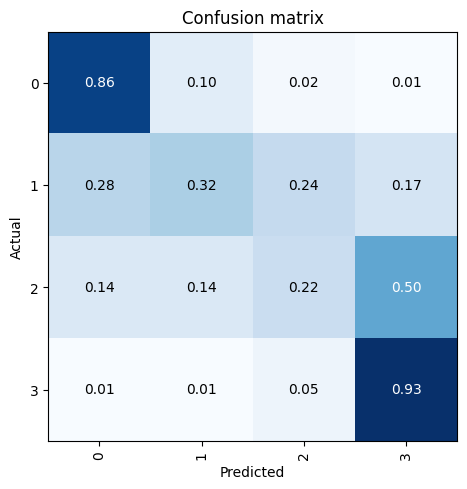

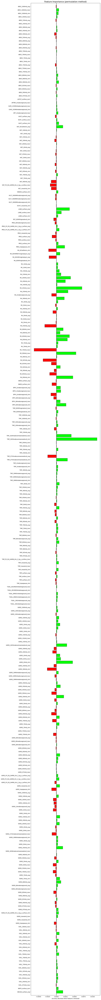

In [138]:
learn = simplify_features(14, 'ca_co_day1above_3h_84d_allvars_small', 1, .58, .01)

163 features remaining


epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.644302,1.399710,0.232250,0.232250,00:42
1,1.629162,1.396519,0.236500,0.236500,00:42
2,1.619053,1.392849,0.245375,0.245375,00:42
3,1.605928,1.388196,0.250375,0.250375,00:42
4,1.607382,1.382488,0.260750,0.260750,00:43
5,1.590880,1.375391,0.275500,0.275500,00:43
6,1.578874,1.365129,0.300875,0.300875,00:43
7,1.556594,1.352490,0.325750,0.325750,00:43
8,1.539557,1.333798,0.357375,0.357375,00:43
9,1.503731,1.310216,0.378500,0.378500,00:44


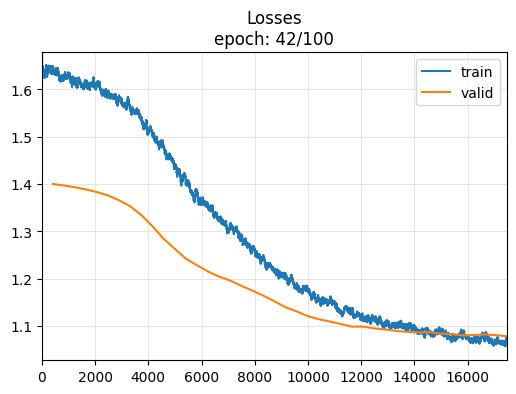

,train_loss,valid_loss,accuracy,balanced_accuracy_score
41,1.074572,1.078039,0.5585,0.5585


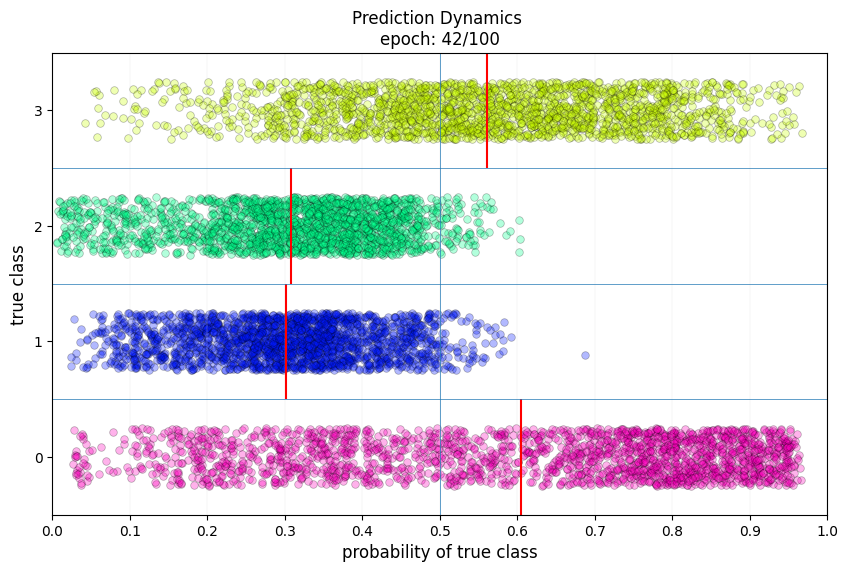

No improvement since epoch 35: early stopping


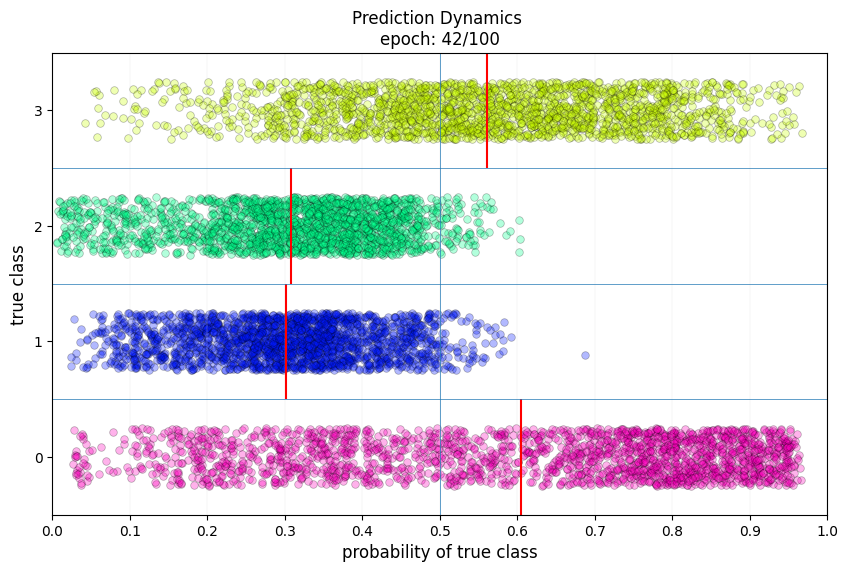

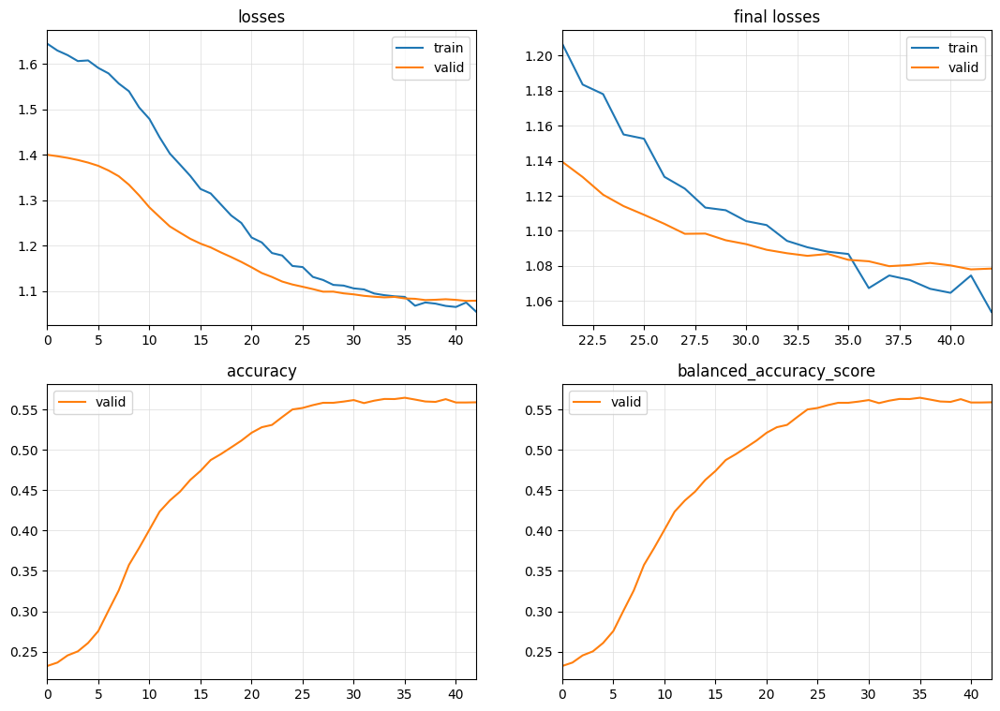

Accuracy: 0.55875
X.shape: (40000, 163, 112)
y.shape: (40000,)
Selected metric: accuracy
Computing feature importance (permutation method)...


  0 feature: BASELINE             accuracy: 0.607175


  0 feature: ABSV_1000mb_max      accuracy: 0.607375


  1 feature: ABSV_1000mb_min      accuracy: 0.607500


  2 feature: ABSV_100mb_max       accuracy: 0.607150


  3 feature: ABSV_400mb_avg       accuracy: 0.607175


  4 feature: ABSV_450mb_min       accuracy: 0.606775


  5 feature: ABSV_700mb_avg       accuracy: 0.608150


  6 feature: ABSV_700mb_max       accuracy: 0.606900


  7 feature: ABSV_750mb_max       accuracy: 0.607150


  8 feature: ABSV_750mb_min       accuracy: 0.607650


  9 feature: ABSV_800mb_max       accuracy: 0.607275


 10 feature: ABSV_800mb_min       accuracy: 0.607250


 11 feature: ABSV_900mb_min       accuracy: 0.607375


 12 feature: ABSV_950mb_max       accuracy: 0.607275


 13 feature: ABSV_975mb_min       accuracy: 0.606925


 14 feature: APTMP_2maboveground_max accuracy: 0.606825


 15 feature: CAPE_255M0mbaboveground_max accuracy: 0.607050


 16 feature: CAPE_255M0mbaboveground_min accuracy: 0.607050


 17 feature: DPT_2maboveground_max accuracy: 0.606775


 18 feature: GUST_surface_max     accuracy: 0.602250


 19 feature: GUST_surface_min     accuracy: 0.605200


 20 feature: HGT_0Cisotherm_avg   accuracy: 0.595550


 21 feature: HGT_100mb_min        accuracy: 0.607125


 22 feature: HGT_200mb_max        accuracy: 0.606700


 23 feature: HGT_20mb_avg         accuracy: 0.607200


 24 feature: HGT_500mb_avg        accuracy: 0.606975


 25 feature: HGT_700mb_avg        accuracy: 0.606500


 26 feature: HINDEX_surface_min   accuracy: 0.606525


 27 feature: LAND_surface_avg     accuracy: 0.606025


 28 feature: LAND_surface_max     accuracy: 0.606075


 29 feature: LAND_surface_min     accuracy: 0.606250


 30 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.606650


 31 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.606000


 32 feature: PRES_surface_min     accuracy: 0.606650


 33 feature: PRES_tropopause_min  accuracy: 0.606725


 34 feature: RH_0D44M0D72sigmalayer_avg accuracy: 0.606300


 35 feature: RH_10mb_avg          accuracy: 0.607325


 36 feature: RH_10mb_max          accuracy: 0.607425


 37 feature: RH_150mb_avg         accuracy: 0.607100


 38 feature: RH_150mb_min         accuracy: 0.604975


 39 feature: RH_200mb_max         accuracy: 0.603700


 40 feature: RH_200mb_min         accuracy: 0.603925


 41 feature: RH_250mb_avg         accuracy: 0.602700


 42 feature: RH_250mb_max         accuracy: 0.605150


 43 feature: RH_250mb_min         accuracy: 0.598425


 44 feature: RH_300mb_min         accuracy: 0.598175


 45 feature: RH_30mb_avg          accuracy: 0.605225


 46 feature: RH_350mb_min         accuracy: 0.604050


 47 feature: RH_50mb_avg          accuracy: 0.605800


 48 feature: RH_50mb_max          accuracy: 0.607425


 49 feature: RH_600mb_max         accuracy: 0.602775


 50 feature: RH_600mb_min         accuracy: 0.605750


 51 feature: RH_650mb_max         accuracy: 0.605825


 52 feature: RH_650mb_min         accuracy: 0.603925


 53 feature: RH_70mb_avg          accuracy: 0.607825


 54 feature: RH_70mb_min          accuracy: 0.606775


 55 feature: RH_900mb_max         accuracy: 0.604175


 56 feature: RH_900mb_min         accuracy: 0.606900


 57 feature: RH_925mb_min         accuracy: 0.607175


 58 feature: RH_950mb_min         accuracy: 0.606500


 59 feature: SPFH_2maboveground_avg accuracy: 0.608100


 60 feature: SPFH_2maboveground_max accuracy: 0.605925


 61 feature: SPFH_80maboveground_max accuracy: 0.607750


 62 feature: SPFH_80maboveground_min accuracy: 0.608350


 63 feature: TMP_0D995sigmalevel_min accuracy: 0.606550


 64 feature: TMP_1000mb_avg       accuracy: 0.606950


 65 feature: TMP_100maboveground_avg accuracy: 0.606700


 66 feature: TMP_100maboveground_min accuracy: 0.607125


 67 feature: TMP_150mb_avg        accuracy: 0.607150


 68 feature: TMP_1829mabovemeansealevel_max accuracy: 0.604650


 69 feature: TMP_1829mabovemeansealevel_min accuracy: 0.606950


 70 feature: TMP_200mb_min        accuracy: 0.606500


 71 feature: TMP_250mb_avg        accuracy: 0.606925


 72 feature: TMP_2743mabovemeansealevel_min accuracy: 0.606750


 73 feature: TMP_2maboveground_max accuracy: 0.607025


 74 feature: TMP_2maboveground_min accuracy: 0.607125


 75 feature: TMP_300mb_avg        accuracy: 0.606550


 76 feature: TMP_30M0mbaboveground_avg accuracy: 0.607050


 77 feature: TMP_30M0mbaboveground_max accuracy: 0.606450


 78 feature: TMP_30M0mbaboveground_min accuracy: 0.606575


 79 feature: TMP_30mb_min         accuracy: 0.606725


 80 feature: TMP_350mb_max        accuracy: 0.607275


 81 feature: TMP_400mb_avg        accuracy: 0.607100


 82 feature: TMP_450mb_avg        accuracy: 0.607500


 83 feature: TMP_450mb_min        accuracy: 0.607250


 84 feature: TMP_550mb_avg        accuracy: 0.607425


 85 feature: TMP_600mb_min        accuracy: 0.606625


 86 feature: TMP_700mb_avg        accuracy: 0.607225


 87 feature: TMP_70mb_max         accuracy: 0.607075


 88 feature: TMP_750mb_avg        accuracy: 0.607175


 89 feature: TMP_80maboveground_avg accuracy: 0.607425


 90 feature: TMP_850mb_max        accuracy: 0.606825


 91 feature: TMP_900mb_avg        accuracy: 0.607250


 92 feature: TMP_975mb_min        accuracy: 0.607175


 93 feature: TMP_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.607050


 94 feature: TMP_maxwind_avg      accuracy: 0.607425


 95 feature: TMP_maxwind_min      accuracy: 0.606550


 96 feature: TMP_surface_max      accuracy: 0.607075


 97 feature: TSOIL_0D1M0D4mbelowground_max accuracy: 0.606525


 98 feature: TSOIL_0M0D1mbelowground_max accuracy: 0.606150


 99 feature: TSOIL_0M0D1mbelowground_min accuracy: 0.607125


100 feature: TSOIL_1M2mbelowground_avg accuracy: 0.607100


101 feature: UGRD_1000mb_avg      accuracy: 0.606550


102 feature: UGRD_100maboveground_avg accuracy: 0.606900


103 feature: UGRD_100mb_avg       accuracy: 0.600075


104 feature: UGRD_100mb_max       accuracy: 0.607425


105 feature: UGRD_10mb_avg        accuracy: 0.604050


106 feature: UGRD_10mb_max        accuracy: 0.605900


107 feature: UGRD_10mb_min        accuracy: 0.604225


108 feature: UGRD_150mb_min       accuracy: 0.605400


109 feature: UGRD_1829mabovemeansealevel_avg accuracy: 0.608450


110 feature: UGRD_20mb_avg        accuracy: 0.602625


111 feature: UGRD_20mb_max        accuracy: 0.606100


112 feature: UGRD_20mb_min        accuracy: 0.605800


113 feature: UGRD_30M0mbaboveground_avg accuracy: 0.606850


114 feature: UGRD_350mb_avg       accuracy: 0.605125


115 feature: UGRD_450mb_avg       accuracy: 0.605025


116 feature: UGRD_500mb_min       accuracy: 0.606275


117 feature: UGRD_50mb_min        accuracy: 0.604025


118 feature: UGRD_650mb_min       accuracy: 0.604875


119 feature: UGRD_70mb_avg        accuracy: 0.605600


120 feature: UGRD_70mb_min        accuracy: 0.604100


121 feature: UGRD_80maboveground_min accuracy: 0.606875


122 feature: UGRD_900mb_avg       accuracy: 0.607225


123 feature: UGRD_900mb_min       accuracy: 0.607275


124 feature: UGRD_925mb_avg       accuracy: 0.606950


125 feature: UGRD_975mb_max       accuracy: 0.607225


126 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.604875


127 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.602650


128 feature: UGRD_maxwind_min     accuracy: 0.604900


129 feature: VGRD_100mb_avg       accuracy: 0.605700


130 feature: VGRD_10mb_min        accuracy: 0.604975


131 feature: VGRD_150mb_min       accuracy: 0.604175


132 feature: VGRD_200mb_avg       accuracy: 0.606850


133 feature: VGRD_200mb_max       accuracy: 0.606100


134 feature: VGRD_30M0mbaboveground_min accuracy: 0.606900


135 feature: VGRD_30mb_avg        accuracy: 0.605725


136 feature: VGRD_30mb_max        accuracy: 0.602725


137 feature: VGRD_350mb_min       accuracy: 0.601025


138 feature: VGRD_400mb_min       accuracy: 0.604450


139 feature: VGRD_50mb_avg        accuracy: 0.604475


140 feature: VGRD_70mb_min        accuracy: 0.606950


141 feature: VGRD_800mb_avg       accuracy: 0.606400


142 feature: VGRD_80maboveground_avg accuracy: 0.607150


143 feature: VGRD_80maboveground_max accuracy: 0.607100


144 feature: VGRD_925mb_max       accuracy: 0.607375


145 feature: VGRD_975mb_min       accuracy: 0.606800


146 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.605875


147 feature: VGRD_maxwind_max     accuracy: 0.606425


148 feature: VGRD_maxwind_min     accuracy: 0.603900


149 feature: VVEL_500mb_min       accuracy: 0.607075


150 feature: VVEL_600mb_max       accuracy: 0.605725


151 feature: VVEL_650mb_min       accuracy: 0.607050


152 feature: VVEL_700mb_avg       accuracy: 0.607500


153 feature: VVEL_700mb_max       accuracy: 0.607800


154 feature: VVEL_750mb_avg       accuracy: 0.607200


155 feature: VVEL_750mb_min       accuracy: 0.607700


156 feature: VVEL_800mb_max       accuracy: 0.607325


157 feature: VVEL_925mb_avg       accuracy: 0.606825


158 feature: VVEL_950mb_avg       accuracy: 0.607075


159 feature: VVEL_950mb_max       accuracy: 0.607025


160 feature: VVEL_950mb_min       accuracy: 0.606700


161 feature: WATR_surface_sum     accuracy: 0.607125


162 feature: WEASD_surface_avg    accuracy: 0.607625



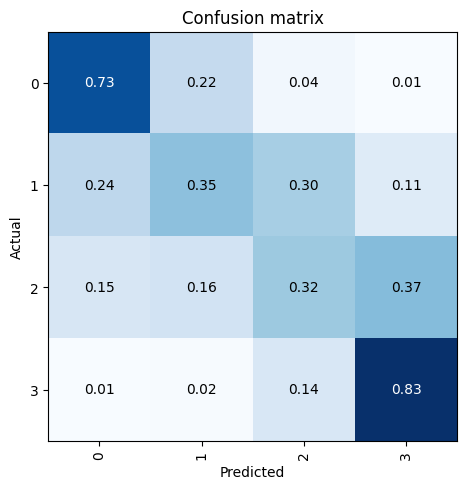

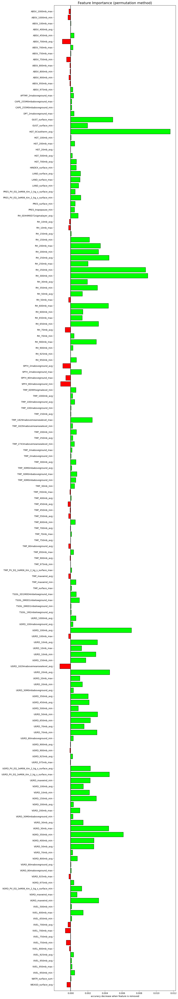

In [139]:
learn = simplify_features(14, 'ca_co_day1above_3h_84d_allvars_small', 2, .58, .01)

367 features remaining


epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.609430,1.367523,0.299500,0.299500,01:55
1,1.615856,1.362874,0.322625,0.322625,01:56
2,1.603912,1.354909,0.347625,0.347625,01:56
3,1.592324,1.344711,0.369500,0.369500,01:56
4,1.577459,1.327394,0.387875,0.387875,01:56
5,1.541850,1.304582,0.389375,0.389375,01:56
6,1.510158,1.282911,0.388750,0.388750,01:56
7,1.471736,1.267084,0.393375,0.393375,01:56
8,1.438054,1.261327,0.404000,0.404000,01:56
9,1.415198,1.251268,0.423125,0.423125,01:56


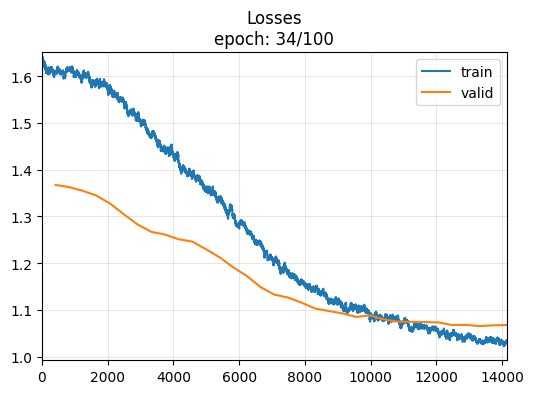

,train_loss,valid_loss,accuracy,balanced_accuracy_score
33,1.035202,1.067586,0.577125,0.577125


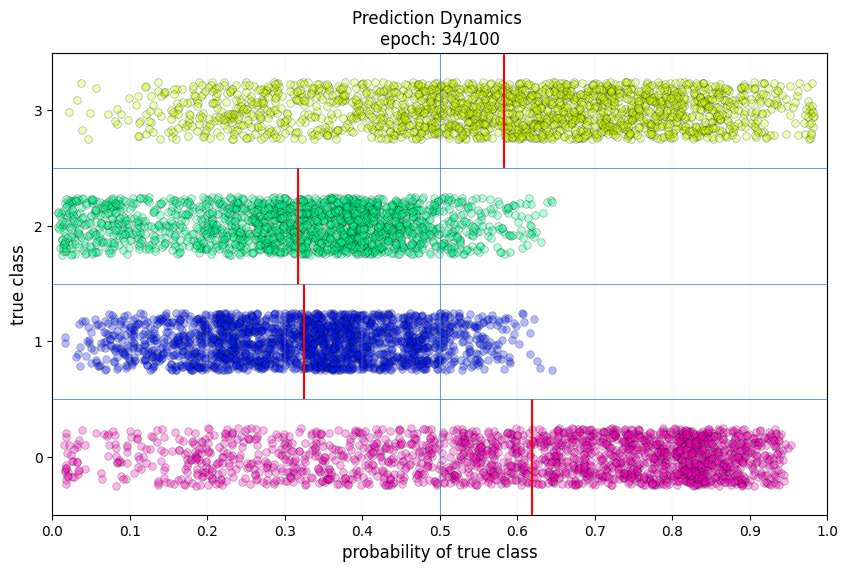

No improvement since epoch 27: early stopping


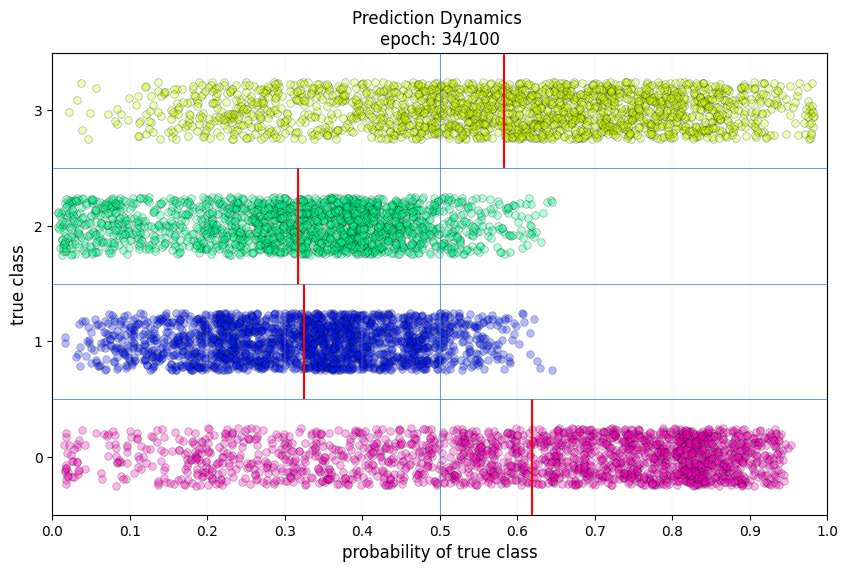

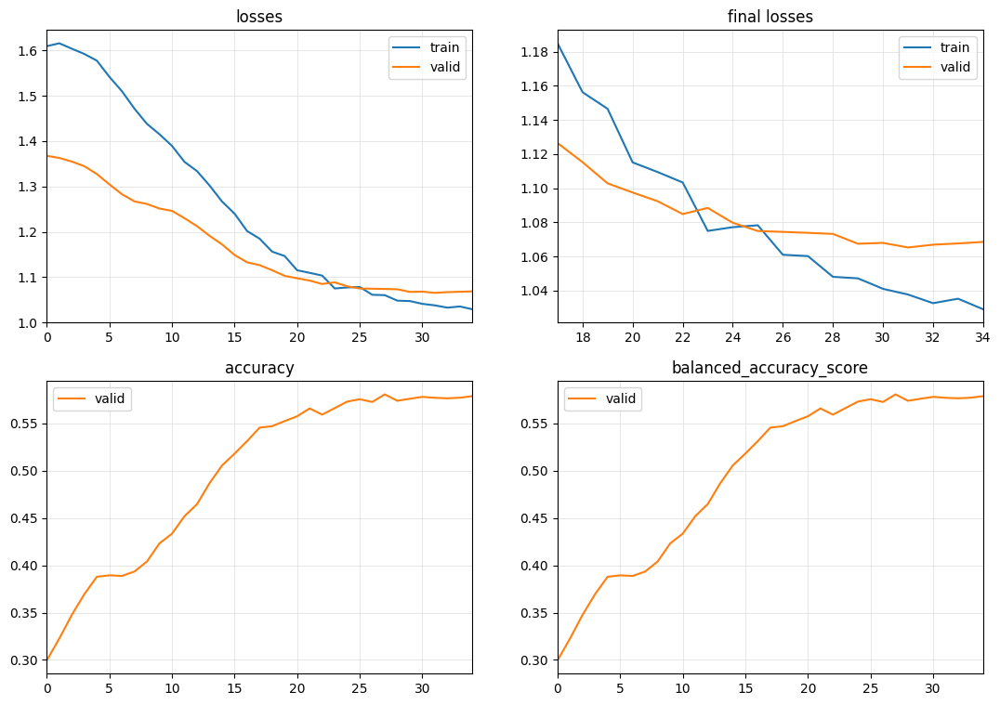

Accuracy: 0.57875
X.shape: (40000, 367, 224)
y.shape: (40000,)
Selected metric: accuracy
Computing feature importance (permutation method)...


  0 feature: BASELINE             accuracy: 0.632375


  0 feature: ABSV_1000mb_max      accuracy: 0.632425


  1 feature: ABSV_100mb_max       accuracy: 0.632575


  2 feature: ABSV_10mb_min        accuracy: 0.632625


  3 feature: ABSV_250mb_avg       accuracy: 0.633050


  4 feature: ABSV_250mb_max       accuracy: 0.632275


  5 feature: ABSV_300mb_max       accuracy: 0.632425


  6 feature: ABSV_300mb_min       accuracy: 0.632825


  7 feature: ABSV_30mb_avg        accuracy: 0.633050


  8 feature: ABSV_30mb_max        accuracy: 0.632375


  9 feature: ABSV_350mb_min       accuracy: 0.632475


 10 feature: ABSV_400mb_max       accuracy: 0.632725


 11 feature: ABSV_450mb_avg       accuracy: 0.632150


 12 feature: ABSV_500mb_max       accuracy: 0.632725


 13 feature: ABSV_500mb_min       accuracy: 0.632275


 14 feature: ABSV_50mb_max        accuracy: 0.632325


 15 feature: ABSV_550mb_avg       accuracy: 0.632925


 16 feature: ABSV_550mb_max       accuracy: 0.633050


 17 feature: ABSV_550mb_min       accuracy: 0.632425


 18 feature: ABSV_600mb_avg       accuracy: 0.632925


 19 feature: ABSV_600mb_max       accuracy: 0.632325


 20 feature: ABSV_650mb_min       accuracy: 0.632125


 21 feature: ABSV_70mb_max        accuracy: 0.632225


 22 feature: ABSV_750mb_avg       accuracy: 0.632400


 23 feature: ABSV_750mb_max       accuracy: 0.632750


 24 feature: ABSV_800mb_max       accuracy: 0.632975


 25 feature: ABSV_800mb_min       accuracy: 0.632375


 26 feature: ABSV_850mb_max       accuracy: 0.632550


 27 feature: ABSV_900mb_min       accuracy: 0.632250


 28 feature: ABSV_950mb_max       accuracy: 0.632525


 29 feature: ABSV_950mb_min       accuracy: 0.632275


 30 feature: ABSV_975mb_avg       accuracy: 0.632625


 31 feature: ABSV_975mb_min       accuracy: 0.632325


 32 feature: APCP_surface_sum     accuracy: 0.632275


 33 feature: APTMP_2maboveground_max accuracy: 0.632200


 34 feature: APTMP_2maboveground_min accuracy: 0.633250


 35 feature: CAPE_255M0mbaboveground_min accuracy: 0.632475


 36 feature: CAPE_surface_avg     accuracy: 0.632225


 37 feature: CIN_180M0mbaboveground_max accuracy: 0.632750


 38 feature: CIN_255M0mbaboveground_avg accuracy: 0.632650


 39 feature: CIN_255M0mbaboveground_max accuracy: 0.633400


 40 feature: CIN_surface_avg      accuracy: 0.632675


 41 feature: CIN_surface_min      accuracy: 0.632700


 42 feature: CPOFP_surface_avg    accuracy: 0.631600


 43 feature: CPOFP_surface_max    accuracy: 0.630800


 44 feature: DPT_2maboveground_max accuracy: 0.632875


 45 feature: GUST_surface_avg     accuracy: 0.630950


 46 feature: GUST_surface_max     accuracy: 0.632125


 47 feature: GUST_surface_min     accuracy: 0.631175


 48 feature: HGT_0Cisotherm_avg   accuracy: 0.633075


 49 feature: HGT_0Cisotherm_max   accuracy: 0.625125


 50 feature: HGT_1000mb_avg       accuracy: 0.629975


 51 feature: HGT_1000mb_max       accuracy: 0.633050


 52 feature: HGT_1000mb_min       accuracy: 0.631275


 53 feature: HGT_100mb_min        accuracy: 0.632550


 54 feature: HGT_10mb_avg         accuracy: 0.633650


 55 feature: HGT_10mb_max         accuracy: 0.632725


 56 feature: HGT_10mb_min         accuracy: 0.632350


 57 feature: HGT_150mb_avg        accuracy: 0.632725


 58 feature: HGT_150mb_max        accuracy: 0.632725


 59 feature: HGT_200mb_min        accuracy: 0.632525


 60 feature: HGT_20mb_avg         accuracy: 0.632500


 61 feature: HGT_20mb_min         accuracy: 0.633025


 62 feature: HGT_250mb_max        accuracy: 0.633550


 63 feature: HGT_250mb_min        accuracy: 0.632975


 64 feature: HGT_300mb_avg        accuracy: 0.632625


 65 feature: HGT_300mb_max        accuracy: 0.632225


 66 feature: HGT_300mb_min        accuracy: 0.632450


 67 feature: HGT_30mb_avg         accuracy: 0.632850


 68 feature: HGT_350mb_avg        accuracy: 0.632125


 69 feature: HGT_350mb_max        accuracy: 0.632575


 70 feature: HGT_400mb_avg        accuracy: 0.632475


 71 feature: HGT_450mb_avg        accuracy: 0.632550


 72 feature: HGT_500mb_avg        accuracy: 0.632325


 73 feature: HGT_500mb_max        accuracy: 0.632575


 74 feature: HGT_50mb_max         accuracy: 0.632425


 75 feature: HGT_50mb_min         accuracy: 0.633050


 76 feature: HGT_600mb_max        accuracy: 0.632325


 77 feature: HGT_600mb_min        accuracy: 0.632425


 78 feature: HGT_650mb_avg        accuracy: 0.633250


 79 feature: HGT_70mb_avg         accuracy: 0.632950


 80 feature: HGT_70mb_max         accuracy: 0.632175


 81 feature: HGT_750mb_avg        accuracy: 0.632950


 82 feature: HGT_800mb_avg        accuracy: 0.632175


 83 feature: HGT_800mb_min        accuracy: 0.633125


 84 feature: HGT_850mb_max        accuracy: 0.633325


 85 feature: HGT_850mb_min        accuracy: 0.633100


 86 feature: HGT_900mb_avg        accuracy: 0.631525


 87 feature: HGT_900mb_max        accuracy: 0.633275


 88 feature: HGT_925mb_min        accuracy: 0.631150


 89 feature: HGT_975mb_avg        accuracy: 0.632050


 90 feature: HGT_975mb_max        accuracy: 0.630925


 91 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.633475


 92 feature: HGT_maxwind_avg      accuracy: 0.633400


 93 feature: HGT_surface_max      accuracy: 0.632375


 94 feature: HINDEX_surface_avg   accuracy: 0.631350


 95 feature: HINDEX_surface_max   accuracy: 0.630875


 96 feature: HLCY_3000M0maboveground_avg accuracy: 0.631025


 97 feature: HLCY_3000M0maboveground_max accuracy: 0.632675


 98 feature: HLCY_3000M0maboveground_min accuracy: 0.631200


 99 feature: ICAHT_maxwind_avg    accuracy: 0.631775


100 feature: ICAHT_tropopause_avg accuracy: 0.632400


101 feature: ICAHT_tropopause_max accuracy: 0.633000


102 feature: LAND_surface_avg     accuracy: 0.633025


103 feature: LAND_surface_max     accuracy: 0.631150


104 feature: LAND_surface_min     accuracy: 0.633175


105 feature: PRES_80maboveground_avg accuracy: 0.632475


106 feature: PRES_80maboveground_max accuracy: 0.632550


107 feature: PRES_80maboveground_min accuracy: 0.632250


108 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.632700


109 feature: PRES_maxwind_avg     accuracy: 0.631825


110 feature: PRES_maxwind_max     accuracy: 0.633275


111 feature: PRES_tropopause_max  accuracy: 0.632350


112 feature: PRES_tropopause_min  accuracy: 0.631300


113 feature: PRMSL_meansealevel_avg accuracy: 0.632175


114 feature: PRMSL_meansealevel_min accuracy: 0.632025


115 feature: RH_0Cisotherm_avg    accuracy: 0.633575


116 feature: RH_0Cisotherm_min    accuracy: 0.631950


117 feature: RH_0D33M1sigmalayer_avg accuracy: 0.631375


118 feature: RH_0D33M1sigmalayer_max accuracy: 0.630425


119 feature: RH_0D44M0D72sigmalayer_max accuracy: 0.629375


120 feature: RH_0D44M1sigmalayer_avg accuracy: 0.632475


121 feature: RH_0D44M1sigmalayer_min accuracy: 0.628525


122 feature: RH_0D72M0D94sigmalayer_max accuracy: 0.634075


123 feature: RH_0D72M0D94sigmalayer_min accuracy: 0.628700


124 feature: RH_0D995sigmalevel_avg accuracy: 0.633375


125 feature: RH_0D995sigmalevel_min accuracy: 0.634500


126 feature: RH_1000mb_max        accuracy: 0.631725


127 feature: RH_1000mb_min        accuracy: 0.632550


128 feature: RH_100mb_max         accuracy: 0.632500


129 feature: RH_100mb_min         accuracy: 0.633125


130 feature: RH_10mb_avg          accuracy: 0.631825


131 feature: RH_10mb_max          accuracy: 0.632325


132 feature: RH_200mb_avg         accuracy: 0.630950


133 feature: RH_200mb_max         accuracy: 0.630100


134 feature: RH_200mb_min         accuracy: 0.629075


135 feature: RH_20mb_avg          accuracy: 0.632325


136 feature: RH_250mb_avg         accuracy: 0.632600


137 feature: RH_2maboveground_avg accuracy: 0.632075


138 feature: RH_2maboveground_min accuracy: 0.631325


139 feature: RH_300mb_max         accuracy: 0.629975


140 feature: RH_300mb_min         accuracy: 0.631425


141 feature: RH_30M0mbaboveground_max accuracy: 0.631050


142 feature: RH_30M0mbaboveground_min accuracy: 0.633700


143 feature: RH_30mb_min          accuracy: 0.632375


144 feature: RH_400mb_max         accuracy: 0.632350


145 feature: RH_450mb_min         accuracy: 0.633150


146 feature: RH_500mb_avg         accuracy: 0.624025


147 feature: RH_500mb_max         accuracy: 0.628825


148 feature: RH_500mb_min         accuracy: 0.636075


149 feature: RH_600mb_avg         accuracy: 0.628750


150 feature: RH_650mb_max         accuracy: 0.632800


151 feature: RH_650mb_min         accuracy: 0.631050


152 feature: RH_700mb_avg         accuracy: 0.634300


153 feature: RH_70mb_min          accuracy: 0.632575


154 feature: RH_750mb_max         accuracy: 0.624775


155 feature: RH_800mb_avg         accuracy: 0.632400


156 feature: RH_800mb_max         accuracy: 0.633450


157 feature: RH_800mb_min         accuracy: 0.628675


158 feature: RH_850mb_avg         accuracy: 0.630925


159 feature: RH_850mb_max         accuracy: 0.633125


160 feature: RH_900mb_avg         accuracy: 0.634050


161 feature: RH_900mb_max         accuracy: 0.628225


162 feature: RH_900mb_min         accuracy: 0.635375


163 feature: RH_925mb_avg         accuracy: 0.629800


164 feature: RH_925mb_min         accuracy: 0.629250


165 feature: RH_975mb_avg         accuracy: 0.630550


166 feature: RH_975mb_max         accuracy: 0.633675


167 feature: SNOD_surface_max     accuracy: 0.632250


168 feature: SPFH_2maboveground_min accuracy: 0.631850


169 feature: SPFH_30M0mbaboveground_max accuracy: 0.633050


170 feature: SPFH_30M0mbaboveground_min accuracy: 0.631400


171 feature: SPFH_80maboveground_avg accuracy: 0.632575


172 feature: SPFH_80maboveground_max accuracy: 0.632550


173 feature: SPFH_80maboveground_min accuracy: 0.631475


174 feature: TMP_0D995sigmalevel_min accuracy: 0.632975


175 feature: TMP_1000mb_max       accuracy: 0.633150


176 feature: TMP_100maboveground_avg accuracy: 0.632700


177 feature: TMP_100mb_max        accuracy: 0.632825


178 feature: TMP_100mb_min        accuracy: 0.632525


179 feature: TMP_10mb_avg         accuracy: 0.631775


180 feature: TMP_10mb_max         accuracy: 0.632225


181 feature: TMP_10mb_min         accuracy: 0.631875


182 feature: TMP_150mb_avg        accuracy: 0.632925


183 feature: TMP_150mb_min        accuracy: 0.633000


184 feature: TMP_1829mabovemeansealevel_avg accuracy: 0.618000


185 feature: TMP_1829mabovemeansealevel_max accuracy: 0.632000


186 feature: TMP_1829mabovemeansealevel_min accuracy: 0.631500


187 feature: TMP_200mb_max        accuracy: 0.633225


188 feature: TMP_200mb_min        accuracy: 0.633450


189 feature: TMP_20mb_avg         accuracy: 0.631975


190 feature: TMP_20mb_max         accuracy: 0.633150


191 feature: TMP_250mb_avg        accuracy: 0.632450


192 feature: TMP_250mb_min        accuracy: 0.633250


193 feature: TMP_2743mabovemeansealevel_min accuracy: 0.631675


194 feature: TMP_2maboveground_max accuracy: 0.632650


195 feature: TMP_2maboveground_min accuracy: 0.632000


196 feature: TMP_300mb_avg        accuracy: 0.633050


197 feature: TMP_300mb_max        accuracy: 0.632625


198 feature: TMP_30M0mbaboveground_avg accuracy: 0.633000


199 feature: TMP_30M0mbaboveground_min accuracy: 0.632775


200 feature: TMP_30mb_min         accuracy: 0.632375


201 feature: TMP_350mb_avg        accuracy: 0.632650


202 feature: TMP_3658mabovemeansealevel_avg accuracy: 0.633250


203 feature: TMP_3658mabovemeansealevel_max accuracy: 0.632375


204 feature: TMP_400mb_min        accuracy: 0.631375


205 feature: TMP_450mb_avg        accuracy: 0.633425


206 feature: TMP_450mb_max        accuracy: 0.633175


207 feature: TMP_500mb_avg        accuracy: 0.631400


208 feature: TMP_50mb_max         accuracy: 0.632000


209 feature: TMP_50mb_min         accuracy: 0.632875


210 feature: TMP_550mb_avg        accuracy: 0.632200


211 feature: TMP_550mb_min        accuracy: 0.633225


212 feature: TMP_600mb_max        accuracy: 0.632600


213 feature: TMP_650mb_min        accuracy: 0.632900


214 feature: TMP_700mb_max        accuracy: 0.633125


215 feature: TMP_700mb_min        accuracy: 0.632000


216 feature: TMP_70mb_avg         accuracy: 0.632200


217 feature: TMP_70mb_max         accuracy: 0.632350


218 feature: TMP_750mb_avg        accuracy: 0.632300


219 feature: TMP_750mb_max        accuracy: 0.633225


220 feature: TMP_750mb_min        accuracy: 0.632650


221 feature: TMP_80maboveground_avg accuracy: 0.633125


222 feature: TMP_80maboveground_max accuracy: 0.632500


223 feature: TMP_80maboveground_min accuracy: 0.633325


224 feature: TMP_900mb_min        accuracy: 0.633400


225 feature: TMP_950mb_avg        accuracy: 0.633075


226 feature: TMP_975mb_avg        accuracy: 0.632175


227 feature: TMP_975mb_min        accuracy: 0.632400


228 feature: TMP_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.632675


229 feature: TMP_maxwind_avg      accuracy: 0.633375


230 feature: TMP_surface_avg      accuracy: 0.632575


231 feature: TMP_surface_min      accuracy: 0.632850


232 feature: TMP_tropopause_max   accuracy: 0.633400


233 feature: TMP_tropopause_min   accuracy: 0.631725


234 feature: TSOIL_0D4M1mbelowground_avg accuracy: 0.630550


235 feature: TSOIL_0D4M1mbelowground_max accuracy: 0.633025


236 feature: TSOIL_1M2mbelowground_avg accuracy: 0.633450


237 feature: TSOIL_1M2mbelowground_max accuracy: 0.631900


238 feature: UGRD_1000mb_max      accuracy: 0.632875


239 feature: UGRD_1000mb_min      accuracy: 0.633150


240 feature: UGRD_100maboveground_min accuracy: 0.632375


241 feature: UGRD_100mb_avg       accuracy: 0.632225


242 feature: UGRD_100mb_min       accuracy: 0.633175


243 feature: UGRD_10maboveground_avg accuracy: 0.632725


244 feature: UGRD_10maboveground_max accuracy: 0.632950


245 feature: UGRD_10mb_avg        accuracy: 0.631925


246 feature: UGRD_150mb_max       accuracy: 0.632525


247 feature: UGRD_1829mabovemeansealevel_max accuracy: 0.628800


248 feature: UGRD_1829mabovemeansealevel_min accuracy: 0.631525


249 feature: UGRD_200mb_avg       accuracy: 0.632675


250 feature: UGRD_200mb_min       accuracy: 0.633450


251 feature: UGRD_20mb_min        accuracy: 0.633100


252 feature: UGRD_250mb_avg       accuracy: 0.629500


253 feature: UGRD_250mb_max       accuracy: 0.631450


254 feature: UGRD_250mb_min       accuracy: 0.631200


255 feature: UGRD_2743mabovemeansealevel_max accuracy: 0.632850


256 feature: UGRD_2743mabovemeansealevel_min accuracy: 0.633175


257 feature: UGRD_300mb_max       accuracy: 0.633075


258 feature: UGRD_300mb_min       accuracy: 0.630600


259 feature: UGRD_30mb_avg        accuracy: 0.633275


260 feature: UGRD_30mb_min        accuracy: 0.632250


261 feature: UGRD_350mb_max       accuracy: 0.633050


262 feature: UGRD_3658mabovemeansealevel_max accuracy: 0.632150


263 feature: UGRD_400mb_avg       accuracy: 0.632300


264 feature: UGRD_400mb_max       accuracy: 0.632500


265 feature: UGRD_400mb_min       accuracy: 0.633775


266 feature: UGRD_450mb_max       accuracy: 0.631250


267 feature: UGRD_450mb_min       accuracy: 0.634025


268 feature: UGRD_500mb_max       accuracy: 0.632025


269 feature: UGRD_500mb_min       accuracy: 0.631525


270 feature: UGRD_50mb_avg        accuracy: 0.633600


271 feature: UGRD_50mb_max        accuracy: 0.632525


272 feature: UGRD_50mb_min        accuracy: 0.632925


273 feature: UGRD_550mb_min       accuracy: 0.631975


274 feature: UGRD_600mb_avg       accuracy: 0.630450


275 feature: UGRD_600mb_min       accuracy: 0.632425


276 feature: UGRD_650mb_avg       accuracy: 0.632425


277 feature: UGRD_650mb_max       accuracy: 0.633450


278 feature: UGRD_650mb_min       accuracy: 0.631875


279 feature: UGRD_700mb_max       accuracy: 0.633300


280 feature: UGRD_700mb_min       accuracy: 0.632950


281 feature: UGRD_70mb_min        accuracy: 0.632500


282 feature: UGRD_800mb_max       accuracy: 0.632475


283 feature: UGRD_800mb_min       accuracy: 0.633400


284 feature: UGRD_80maboveground_min accuracy: 0.631775


285 feature: UGRD_850mb_max       accuracy: 0.633300


286 feature: UGRD_850mb_min       accuracy: 0.632200


287 feature: UGRD_900mb_avg       accuracy: 0.632025


288 feature: UGRD_925mb_max       accuracy: 0.632550


289 feature: UGRD_950mb_max       accuracy: 0.632125


290 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.632525


291 feature: UGRD_maxwind_avg     accuracy: 0.631950


292 feature: UGRD_maxwind_max     accuracy: 0.631500


293 feature: UGRD_maxwind_min     accuracy: 0.632300


294 feature: UGRD_tropopause_avg  accuracy: 0.631750


295 feature: UGRD_tropopause_max  accuracy: 0.630650


296 feature: UGRD_tropopause_min  accuracy: 0.631950


297 feature: VGRD_0D995sigmalevel_avg accuracy: 0.632425


298 feature: VGRD_0D995sigmalevel_min accuracy: 0.632050


299 feature: VGRD_1000mb_max      accuracy: 0.632475


300 feature: VGRD_100maboveground_max accuracy: 0.633025


301 feature: VGRD_100mb_min       accuracy: 0.631950


302 feature: VGRD_10maboveground_avg accuracy: 0.632175


303 feature: VGRD_10maboveground_min accuracy: 0.632525


304 feature: VGRD_10mb_avg        accuracy: 0.632375


305 feature: VGRD_1829mabovemeansealevel_avg accuracy: 0.625700


306 feature: VGRD_1829mabovemeansealevel_max accuracy: 0.631900


307 feature: VGRD_200mb_avg       accuracy: 0.630650


308 feature: VGRD_20mb_avg        accuracy: 0.630075


309 feature: VGRD_20mb_max        accuracy: 0.630925


310 feature: VGRD_250mb_min       accuracy: 0.631075


311 feature: VGRD_30M0mbaboveground_max accuracy: 0.632875


312 feature: VGRD_30mb_min        accuracy: 0.632875


313 feature: VGRD_3658mabovemeansealevel_avg accuracy: 0.630175


314 feature: VGRD_3658mabovemeansealevel_max accuracy: 0.632325


315 feature: VGRD_3658mabovemeansealevel_min accuracy: 0.631375


316 feature: VGRD_400mb_min       accuracy: 0.633800


317 feature: VGRD_450mb_min       accuracy: 0.632875


318 feature: VGRD_500mb_min       accuracy: 0.633300


319 feature: VGRD_50mb_avg        accuracy: 0.632175


320 feature: VGRD_50mb_min        accuracy: 0.631475


321 feature: VGRD_600mb_avg       accuracy: 0.631775


322 feature: VGRD_600mb_max       accuracy: 0.631475


323 feature: VGRD_650mb_min       accuracy: 0.630875


324 feature: VGRD_70mb_min        accuracy: 0.633675


325 feature: VGRD_800mb_avg       accuracy: 0.631800


326 feature: VGRD_800mb_max       accuracy: 0.633125


327 feature: VGRD_80maboveground_avg accuracy: 0.632225


328 feature: VGRD_80maboveground_max accuracy: 0.633400


329 feature: VGRD_900mb_min       accuracy: 0.632525


330 feature: VGRD_925mb_avg       accuracy: 0.632225


331 feature: VGRD_925mb_min       accuracy: 0.632200


332 feature: VGRD_975mb_min       accuracy: 0.632900


333 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.632150


334 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.632425


335 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.631775


336 feature: VGRD_maxwind_min     accuracy: 0.631150


337 feature: VGRD_tropopause_min  accuracy: 0.633150


338 feature: VVEL_0D995sigmalevel_avg accuracy: 0.632600


339 feature: VVEL_1000mb_avg      accuracy: 0.632350


340 feature: VVEL_1000mb_min      accuracy: 0.632925


341 feature: VVEL_200mb_max       accuracy: 0.633050


342 feature: VVEL_400mb_min       accuracy: 0.632575


343 feature: VVEL_450mb_avg       accuracy: 0.632225


344 feature: VVEL_500mb_min       accuracy: 0.632825


345 feature: VVEL_550mb_avg       accuracy: 0.632225


346 feature: VVEL_550mb_max       accuracy: 0.632575


347 feature: VVEL_600mb_max       accuracy: 0.632500


348 feature: VVEL_600mb_min       accuracy: 0.633025


349 feature: VVEL_650mb_max       accuracy: 0.632050


350 feature: VVEL_750mb_max       accuracy: 0.632275


351 feature: VVEL_800mb_max       accuracy: 0.633025


352 feature: VVEL_800mb_min       accuracy: 0.631925


353 feature: VVEL_850mb_max       accuracy: 0.632875


354 feature: VVEL_850mb_min       accuracy: 0.632600


355 feature: VVEL_900mb_avg       accuracy: 0.632575


356 feature: VVEL_925mb_avg       accuracy: 0.632600


357 feature: VVEL_925mb_max       accuracy: 0.633000


358 feature: VVEL_925mb_min       accuracy: 0.633325


359 feature: VVEL_950mb_avg       accuracy: 0.632475


360 feature: VVEL_950mb_max       accuracy: 0.632425


361 feature: VVEL_950mb_min       accuracy: 0.632000


362 feature: VVEL_975mb_avg       accuracy: 0.632300


363 feature: VVEL_975mb_min       accuracy: 0.632250


364 feature: WATR_surface_sum     accuracy: 0.632575


365 feature: WEASD_surface_avg    accuracy: 0.633125


366 feature: WEASD_surface_max    accuracy: 0.633000



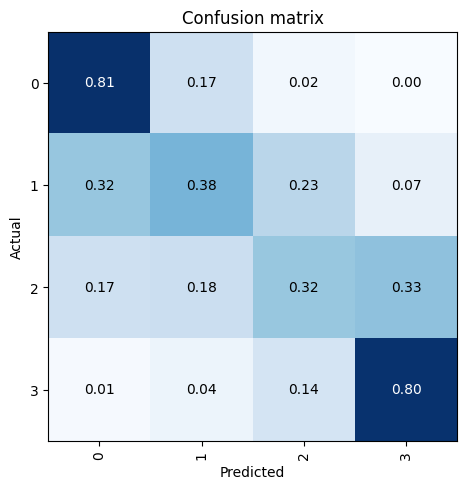

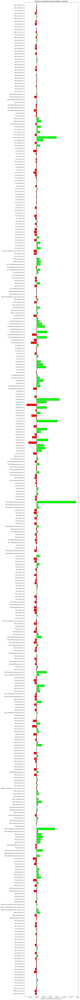

In [141]:
simplify_features(28, 'ca_co_day1above_3h_84d_allvars_small', 0, .58, .01)

159 features remaining


epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.643464,1.402286,0.224125,0.224125,01:52
1,1.641618,1.397750,0.241625,0.241625,01:52
2,1.634446,1.392598,0.253250,0.253250,01:52
3,1.627248,1.386424,0.264125,0.264125,01:52
4,1.620078,1.379397,0.278125,0.278125,01:52
5,1.608637,1.370820,0.302375,0.302375,01:52
6,1.599713,1.359606,0.332875,0.332875,01:52
7,1.560292,1.342635,0.350750,0.350750,01:52
8,1.549253,1.316281,0.367375,0.367375,01:52
9,1.504006,1.282901,0.380375,0.380375,01:52


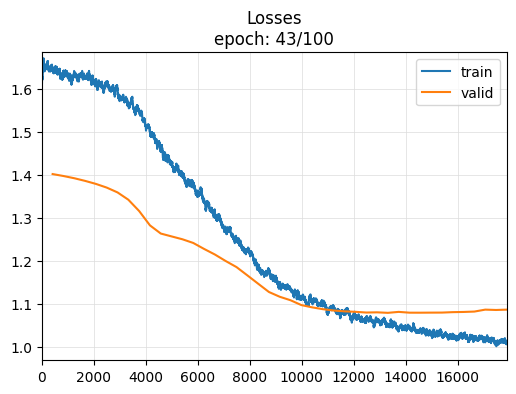

,train_loss,valid_loss,accuracy,balanced_accuracy_score
42,1.012223,1.086942,0.553,0.553


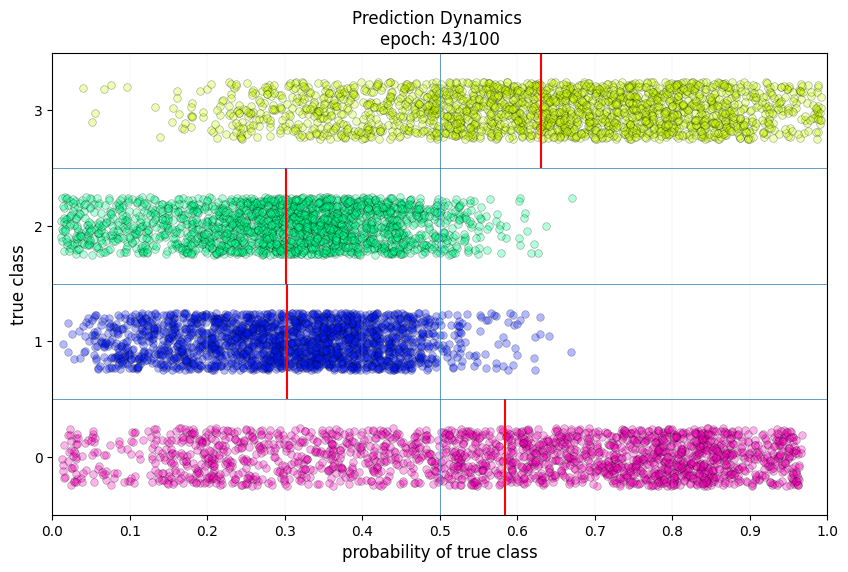

No improvement since epoch 36: early stopping


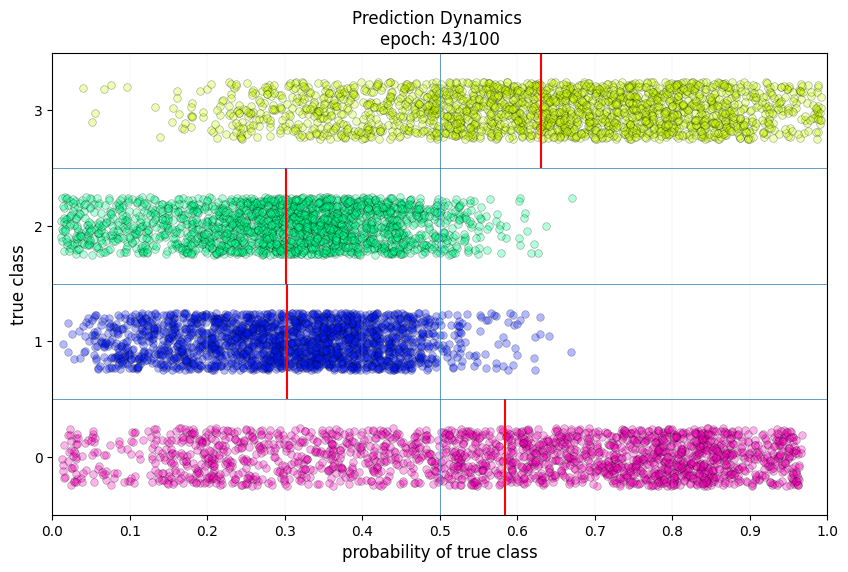

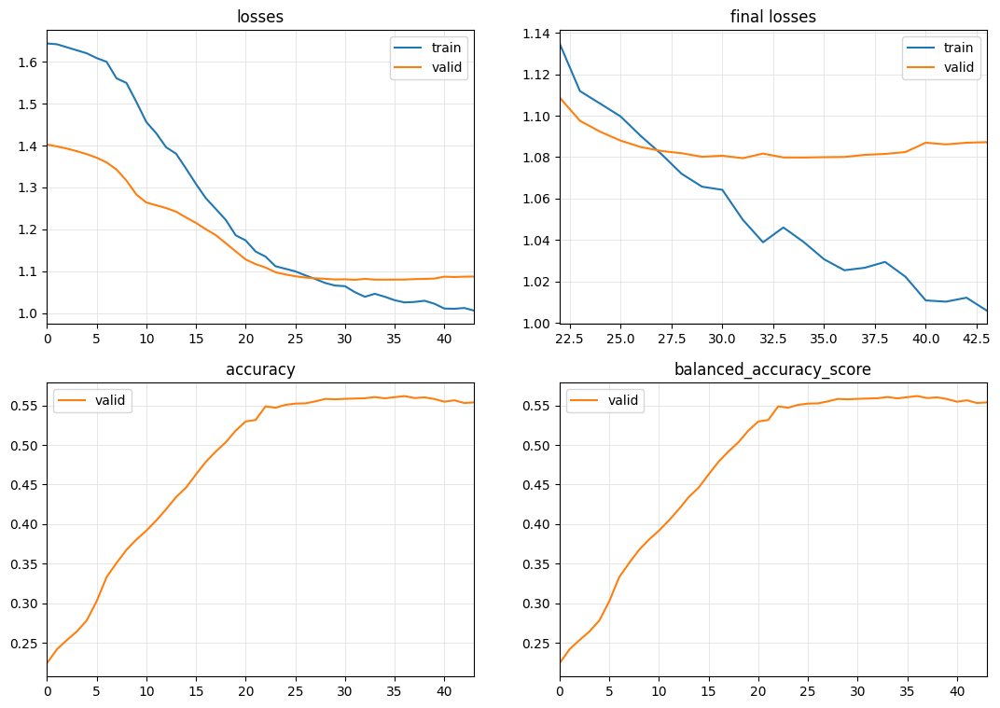

Accuracy: 0.55375
X.shape: (40000, 159, 224)
y.shape: (40000,)
Selected metric: accuracy
Computing feature importance (permutation method)...


  0 feature: BASELINE             accuracy: 0.633325


  0 feature: ABSV_250mb_max       accuracy: 0.632925


  1 feature: ABSV_450mb_avg       accuracy: 0.633300


  2 feature: ABSV_500mb_min       accuracy: 0.633400


  3 feature: ABSV_50mb_max        accuracy: 0.633150


  4 feature: ABSV_600mb_max       accuracy: 0.633600


  5 feature: ABSV_650mb_min       accuracy: 0.632950


  6 feature: ABSV_70mb_max        accuracy: 0.633200


  7 feature: ABSV_900mb_min       accuracy: 0.633175


  8 feature: ABSV_950mb_min       accuracy: 0.633375


  9 feature: ABSV_975mb_min       accuracy: 0.633275


 10 feature: APCP_surface_sum     accuracy: 0.633400


 11 feature: APTMP_2maboveground_max accuracy: 0.633200


 12 feature: CAPE_surface_avg     accuracy: 0.633150


 13 feature: CPOFP_surface_avg    accuracy: 0.626975


 14 feature: CPOFP_surface_max    accuracy: 0.632925


 15 feature: GUST_surface_avg     accuracy: 0.632975


 16 feature: GUST_surface_max     accuracy: 0.632100


 17 feature: GUST_surface_min     accuracy: 0.632050


 18 feature: HGT_0Cisotherm_max   accuracy: 0.631850


 19 feature: HGT_1000mb_avg       accuracy: 0.634025


 20 feature: HGT_1000mb_min       accuracy: 0.633725


 21 feature: HGT_10mb_min         accuracy: 0.632950


 22 feature: HGT_300mb_max        accuracy: 0.633450


 23 feature: HGT_350mb_avg        accuracy: 0.633600


 24 feature: HGT_500mb_avg        accuracy: 0.632650


 25 feature: HGT_600mb_max        accuracy: 0.633200


 26 feature: HGT_70mb_max         accuracy: 0.633125


 27 feature: HGT_800mb_avg        accuracy: 0.633900


 28 feature: HGT_900mb_avg        accuracy: 0.633600


 29 feature: HGT_925mb_min        accuracy: 0.632600


 30 feature: HGT_975mb_avg        accuracy: 0.630500


 31 feature: HGT_975mb_max        accuracy: 0.633600


 32 feature: HINDEX_surface_avg   accuracy: 0.633975


 33 feature: HINDEX_surface_max   accuracy: 0.633625


 34 feature: HLCY_3000M0maboveground_avg accuracy: 0.633775


 35 feature: HLCY_3000M0maboveground_min accuracy: 0.632075


 36 feature: ICAHT_maxwind_avg    accuracy: 0.633300


 37 feature: LAND_surface_max     accuracy: 0.633425


 38 feature: PRES_80maboveground_min accuracy: 0.633025


 39 feature: PRES_maxwind_avg     accuracy: 0.634075


 40 feature: PRES_tropopause_max  accuracy: 0.633875


 41 feature: PRES_tropopause_min  accuracy: 0.632900


 42 feature: PRMSL_meansealevel_avg accuracy: 0.633600


 43 feature: PRMSL_meansealevel_min accuracy: 0.632875


 44 feature: RH_0Cisotherm_min    accuracy: 0.633950


 45 feature: RH_0D33M1sigmalayer_avg accuracy: 0.635575


 46 feature: RH_0D33M1sigmalayer_max accuracy: 0.634325


 47 feature: RH_0D44M0D72sigmalayer_max accuracy: 0.635900


 48 feature: RH_0D44M1sigmalayer_min accuracy: 0.633025


 49 feature: RH_0D72M0D94sigmalayer_min accuracy: 0.629625


 50 feature: RH_1000mb_max        accuracy: 0.635325


 51 feature: RH_10mb_avg          accuracy: 0.633500


 52 feature: RH_10mb_max          accuracy: 0.633675


 53 feature: RH_200mb_avg         accuracy: 0.633175


 54 feature: RH_200mb_max         accuracy: 0.629250


 55 feature: RH_200mb_min         accuracy: 0.629525


 56 feature: RH_20mb_avg          accuracy: 0.632100


 57 feature: RH_2maboveground_avg accuracy: 0.636075


 58 feature: RH_2maboveground_min accuracy: 0.630850


 59 feature: RH_300mb_max         accuracy: 0.632350


 60 feature: RH_300mb_min         accuracy: 0.632200


 61 feature: RH_30M0mbaboveground_max accuracy: 0.629425


 62 feature: RH_400mb_max         accuracy: 0.633450


 63 feature: RH_500mb_avg         accuracy: 0.632950


 64 feature: RH_500mb_max         accuracy: 0.629900


 65 feature: RH_600mb_avg         accuracy: 0.632525


 66 feature: RH_650mb_min         accuracy: 0.630750


 67 feature: RH_750mb_max         accuracy: 0.634100


 68 feature: RH_800mb_min         accuracy: 0.632425


 69 feature: RH_850mb_avg         accuracy: 0.632350


 70 feature: RH_900mb_max         accuracy: 0.633125


 71 feature: RH_925mb_avg         accuracy: 0.634600


 72 feature: RH_925mb_min         accuracy: 0.631825


 73 feature: RH_975mb_avg         accuracy: 0.633000


 74 feature: SNOD_surface_max     accuracy: 0.633825


 75 feature: SPFH_2maboveground_min accuracy: 0.632000


 76 feature: SPFH_30M0mbaboveground_min accuracy: 0.633200


 77 feature: SPFH_80maboveground_min accuracy: 0.631950


 78 feature: TMP_10mb_avg         accuracy: 0.632725


 79 feature: TMP_10mb_max         accuracy: 0.634200


 80 feature: TMP_10mb_min         accuracy: 0.633475


 81 feature: TMP_1829mabovemeansealevel_avg accuracy: 0.620875


 82 feature: TMP_1829mabovemeansealevel_max accuracy: 0.627050


 83 feature: TMP_1829mabovemeansealevel_min accuracy: 0.630900


 84 feature: TMP_20mb_avg         accuracy: 0.633350


 85 feature: TMP_2743mabovemeansealevel_min accuracy: 0.633450


 86 feature: TMP_2maboveground_min accuracy: 0.633200


 87 feature: TMP_400mb_min        accuracy: 0.633250


 88 feature: TMP_500mb_avg        accuracy: 0.633125


 89 feature: TMP_50mb_max         accuracy: 0.633900


 90 feature: TMP_550mb_avg        accuracy: 0.632950


 91 feature: TMP_700mb_min        accuracy: 0.633400


 92 feature: TMP_70mb_avg         accuracy: 0.633225


 93 feature: TMP_70mb_max         accuracy: 0.632450


 94 feature: TMP_750mb_avg        accuracy: 0.633150


 95 feature: TMP_975mb_avg        accuracy: 0.633225


 96 feature: TMP_tropopause_min   accuracy: 0.633100


 97 feature: TSOIL_0D4M1mbelowground_avg accuracy: 0.631825


 98 feature: TSOIL_1M2mbelowground_max accuracy: 0.632825


 99 feature: UGRD_100mb_avg       accuracy: 0.631125


100 feature: UGRD_10mb_avg        accuracy: 0.633925


101 feature: UGRD_1829mabovemeansealevel_max accuracy: 0.629200


102 feature: UGRD_1829mabovemeansealevel_min accuracy: 0.631000


103 feature: UGRD_250mb_avg       accuracy: 0.633625


104 feature: UGRD_250mb_max       accuracy: 0.633675


105 feature: UGRD_250mb_min       accuracy: 0.632700


106 feature: UGRD_300mb_min       accuracy: 0.632350


107 feature: UGRD_30mb_min        accuracy: 0.633100


108 feature: UGRD_3658mabovemeansealevel_max accuracy: 0.633050


109 feature: UGRD_400mb_avg       accuracy: 0.632675


110 feature: UGRD_450mb_max       accuracy: 0.633350


111 feature: UGRD_500mb_max       accuracy: 0.632750


112 feature: UGRD_500mb_min       accuracy: 0.633975


113 feature: UGRD_550mb_min       accuracy: 0.633200


114 feature: UGRD_600mb_avg       accuracy: 0.632650


115 feature: UGRD_650mb_min       accuracy: 0.633500


116 feature: UGRD_80maboveground_min accuracy: 0.633375


117 feature: UGRD_850mb_min       accuracy: 0.632675


118 feature: UGRD_900mb_avg       accuracy: 0.633475


119 feature: UGRD_950mb_max       accuracy: 0.633450


120 feature: UGRD_maxwind_avg     accuracy: 0.632375


121 feature: UGRD_maxwind_max     accuracy: 0.632750


122 feature: UGRD_maxwind_min     accuracy: 0.631450


123 feature: UGRD_tropopause_avg  accuracy: 0.631450


124 feature: UGRD_tropopause_max  accuracy: 0.633500


125 feature: UGRD_tropopause_min  accuracy: 0.631950


126 feature: VGRD_0D995sigmalevel_min accuracy: 0.633700


127 feature: VGRD_100mb_min       accuracy: 0.632375


128 feature: VGRD_10maboveground_avg accuracy: 0.633275


129 feature: VGRD_1829mabovemeansealevel_avg accuracy: 0.632325


130 feature: VGRD_1829mabovemeansealevel_max accuracy: 0.635100


131 feature: VGRD_200mb_avg       accuracy: 0.630900


132 feature: VGRD_20mb_avg        accuracy: 0.633500


133 feature: VGRD_20mb_max        accuracy: 0.630425


134 feature: VGRD_250mb_min       accuracy: 0.633675


135 feature: VGRD_3658mabovemeansealevel_avg accuracy: 0.632925


136 feature: VGRD_3658mabovemeansealevel_max accuracy: 0.632500


137 feature: VGRD_3658mabovemeansealevel_min accuracy: 0.633600


138 feature: VGRD_50mb_avg        accuracy: 0.628275


139 feature: VGRD_50mb_min        accuracy: 0.634450


140 feature: VGRD_600mb_avg       accuracy: 0.633050


141 feature: VGRD_600mb_max       accuracy: 0.634000


142 feature: VGRD_650mb_min       accuracy: 0.633525


143 feature: VGRD_800mb_avg       accuracy: 0.633900


144 feature: VGRD_80maboveground_avg accuracy: 0.633400


145 feature: VGRD_925mb_avg       accuracy: 0.633450


146 feature: VGRD_925mb_min       accuracy: 0.634000


147 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.632650


148 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.635900


149 feature: VGRD_maxwind_min     accuracy: 0.632200


150 feature: VVEL_1000mb_avg      accuracy: 0.633225


151 feature: VVEL_450mb_avg       accuracy: 0.633275


152 feature: VVEL_550mb_avg       accuracy: 0.633050


153 feature: VVEL_650mb_max       accuracy: 0.633800


154 feature: VVEL_750mb_max       accuracy: 0.633550


155 feature: VVEL_800mb_min       accuracy: 0.633100


156 feature: VVEL_950mb_min       accuracy: 0.633075


157 feature: VVEL_975mb_avg       accuracy: 0.633225


158 feature: VVEL_975mb_min       accuracy: 0.632800



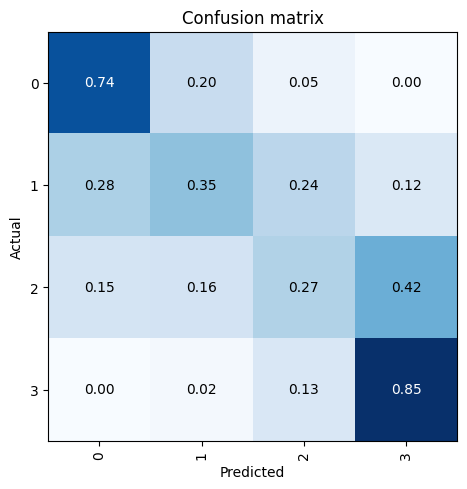

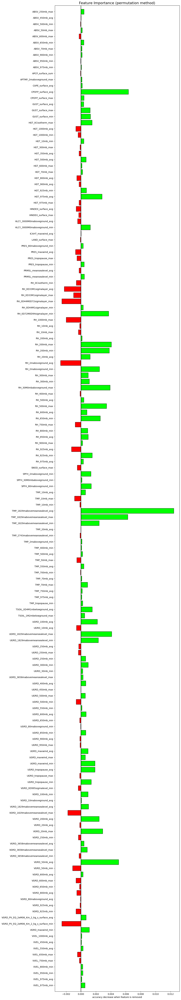

In [142]:
simplify_features(28, 'ca_co_day1above_3h_84d_allvars_small', 1, .58, .01)

epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.633419,1.404523,0.203625,0.203625,00:49
1,1.609032,1.399381,0.215625,0.215625,00:49
2,1.613274,1.393550,0.234000,0.234000,00:49
3,1.598191,1.384762,0.262750,0.262750,00:48
4,1.585032,1.372871,0.301125,0.301125,00:45
5,1.574133,1.354491,0.344375,0.344375,00:45
6,1.544716,1.324806,0.377625,0.377625,00:45
7,1.499063,1.282006,0.392875,0.392875,00:45
8,1.444635,1.246022,0.403375,0.403375,00:46
9,1.396373,1.220736,0.413375,0.413375,00:46


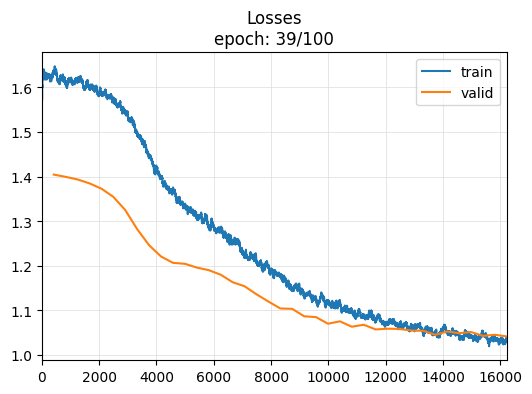

,train_loss,valid_loss,accuracy,balanced_accuracy_score
38,1.033434,1.041443,0.57725,0.57725


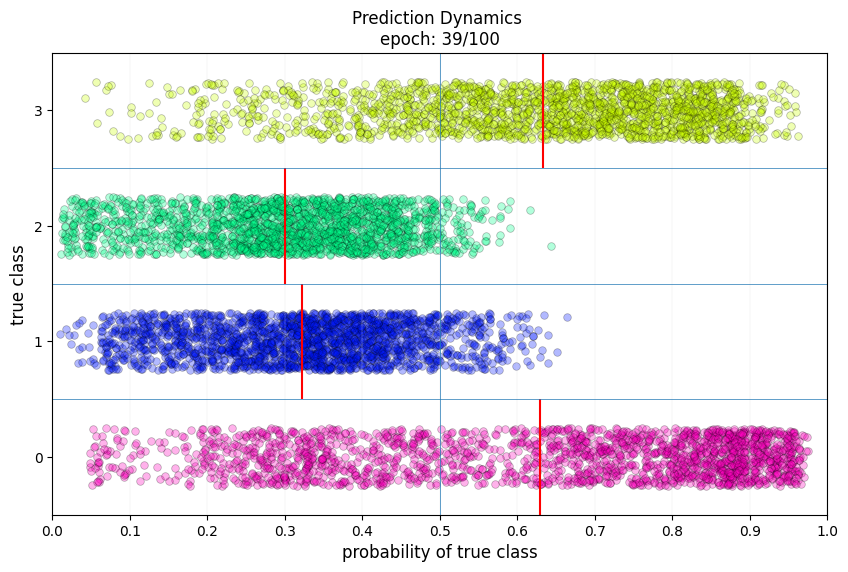

No improvement since epoch 32: early stopping


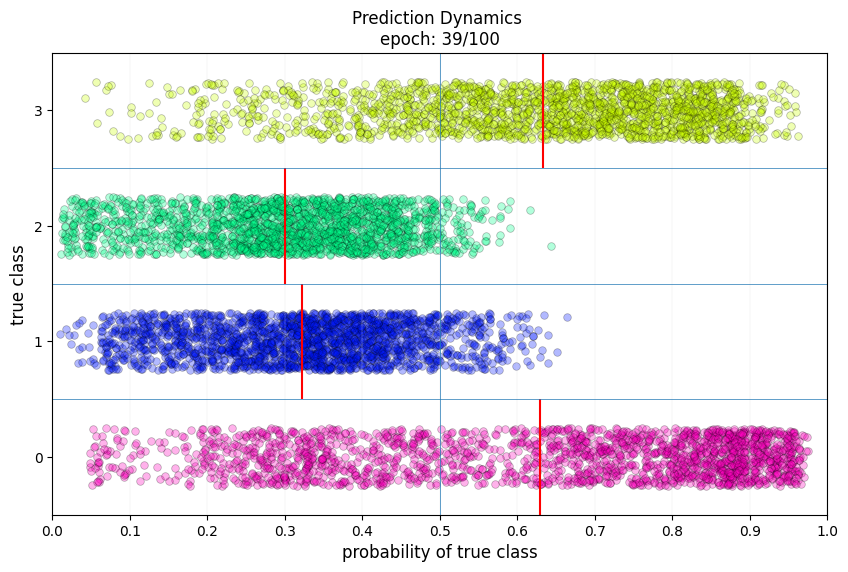

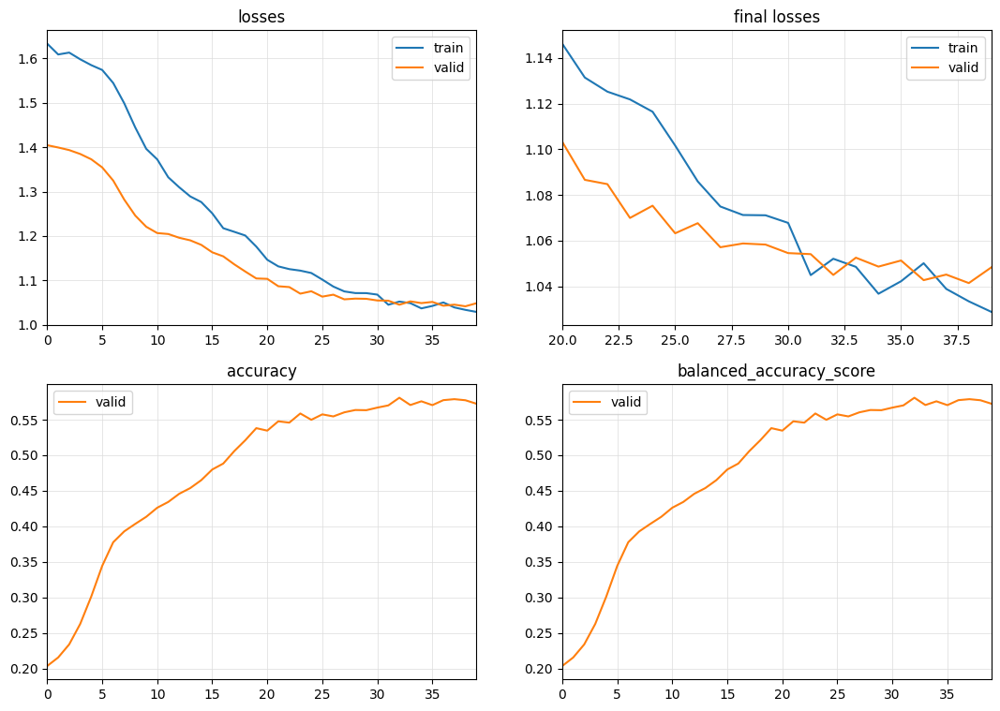

X.shape: (40000, 426, 112)
y.shape: (40000,)
Selected metric: accuracy


AssertionError: 

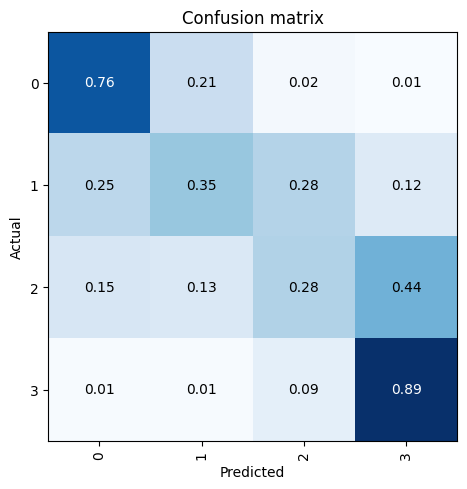

In [74]:
#days = 14
#create a data loader indexed to just the features contained in fi
#_, dls_14 = utils.create_dls(X[:,fi.index.values,-1 * days *8:], y, feature_mins=np.array(feature_mins), feature_maxs=np.array(feature_maxs), sample_frac=1.0, splits=splits, batch_size=96)

X.shape: (40000, 426, 112)
y.shape: (40000,)
Selected metric: accuracy
Computing feature importance (permutation method)...


  0 feature: BASELINE             accuracy: 0.623950


  0 feature: ABSV_1000mb_avg      accuracy: 0.623675


  1 feature: ABSV_1000mb_max      accuracy: 0.623875


  2 feature: ABSV_1000mb_min      accuracy: 0.624075


  3 feature: ABSV_100mb_max       accuracy: 0.623925


  4 feature: ABSV_10mb_max        accuracy: 0.623950


  5 feature: ABSV_150mb_avg       accuracy: 0.623575


  6 feature: ABSV_250mb_min       accuracy: 0.623975


  7 feature: ABSV_400mb_avg       accuracy: 0.624075


  8 feature: ABSV_450mb_min       accuracy: 0.624100


  9 feature: ABSV_500mb_avg       accuracy: 0.624050


 10 feature: ABSV_500mb_min       accuracy: 0.624150


 11 feature: ABSV_550mb_avg       accuracy: 0.623900


 12 feature: ABSV_600mb_avg       accuracy: 0.623975


 13 feature: ABSV_600mb_min       accuracy: 0.623575


 14 feature: ABSV_650mb_avg       accuracy: 0.623700


 15 feature: ABSV_650mb_max       accuracy: 0.624050


 16 feature: ABSV_700mb_avg       accuracy: 0.623600


 17 feature: ABSV_700mb_max       accuracy: 0.623675


 18 feature: ABSV_700mb_min       accuracy: 0.623450


 19 feature: ABSV_70mb_avg        accuracy: 0.623700


 20 feature: ABSV_70mb_min        accuracy: 0.624200


 21 feature: ABSV_750mb_avg       accuracy: 0.623700


 22 feature: ABSV_750mb_max       accuracy: 0.624125


 23 feature: ABSV_750mb_min       accuracy: 0.623950


 24 feature: ABSV_800mb_max       accuracy: 0.623475


 25 feature: ABSV_800mb_min       accuracy: 0.624375


 26 feature: ABSV_900mb_min       accuracy: 0.623975


 27 feature: ABSV_925mb_max       accuracy: 0.623750


 28 feature: ABSV_925mb_min       accuracy: 0.623950


 29 feature: ABSV_950mb_max       accuracy: 0.623425


 30 feature: ABSV_950mb_min       accuracy: 0.624100


 31 feature: ABSV_975mb_min       accuracy: 0.623650


 32 feature: ACPCP_surface_sum    accuracy: 0.623900


 33 feature: APCP_surface_sum     accuracy: 0.623725


 34 feature: APTMP_2maboveground_avg accuracy: 0.623925


 35 feature: APTMP_2maboveground_max accuracy: 0.623875


 36 feature: CAPE_255M0mbaboveground_max accuracy: 0.623725


 37 feature: CAPE_255M0mbaboveground_min accuracy: 0.623850


 38 feature: CAPE_surface_min     accuracy: 0.623900


 39 feature: CIN_180M0mbaboveground_min accuracy: 0.624025


 40 feature: CIN_255M0mbaboveground_max accuracy: 0.623925


 41 feature: CIN_surface_avg      accuracy: 0.623725


 42 feature: CPOFP_surface_avg    accuracy: 0.622525


 43 feature: CPOFP_surface_min    accuracy: 0.625225


 44 feature: DPT_2maboveground_avg accuracy: 0.623325


 45 feature: DPT_2maboveground_max accuracy: 0.623850


 46 feature: GUST_surface_avg     accuracy: 0.623125


 47 feature: GUST_surface_max     accuracy: 0.623800


 48 feature: GUST_surface_min     accuracy: 0.622775


 49 feature: HGT_0Cisotherm_avg   accuracy: 0.625925


 50 feature: HGT_100mb_min        accuracy: 0.623950


 51 feature: HGT_10mb_avg         accuracy: 0.624075


 52 feature: HGT_150mb_min        accuracy: 0.624100


 53 feature: HGT_200mb_avg        accuracy: 0.623825


 54 feature: HGT_200mb_max        accuracy: 0.624275


 55 feature: HGT_20mb_avg         accuracy: 0.624000


 56 feature: HGT_20mb_max         accuracy: 0.623925


 57 feature: HGT_250mb_max        accuracy: 0.623850


 58 feature: HGT_300mb_avg        accuracy: 0.623775


 59 feature: HGT_30mb_max         accuracy: 0.624000


 60 feature: HGT_350mb_max        accuracy: 0.623950


 61 feature: HGT_400mb_max        accuracy: 0.623725


 62 feature: HGT_400mb_min        accuracy: 0.623725


 63 feature: HGT_450mb_avg        accuracy: 0.624125


 64 feature: HGT_450mb_max        accuracy: 0.624025


 65 feature: HGT_500mb_avg        accuracy: 0.623875


 66 feature: HGT_500mb_min        accuracy: 0.624200


 67 feature: HGT_600mb_avg        accuracy: 0.624225


 68 feature: HGT_600mb_max        accuracy: 0.623825


 69 feature: HGT_650mb_avg        accuracy: 0.624025


 70 feature: HGT_650mb_max        accuracy: 0.624100


 71 feature: HGT_650mb_min        accuracy: 0.623950


 72 feature: HGT_700mb_avg        accuracy: 0.623925


 73 feature: HGT_700mb_min        accuracy: 0.623975


 74 feature: HGT_70mb_avg         accuracy: 0.623975


 75 feature: HGT_70mb_max         accuracy: 0.623875


 76 feature: HGT_800mb_max        accuracy: 0.623875


 77 feature: HGT_850mb_min        accuracy: 0.624175


 78 feature: HGT_900mb_avg        accuracy: 0.624650


 79 feature: HGT_900mb_max        accuracy: 0.623725


 80 feature: HGT_925mb_avg        accuracy: 0.625300


 81 feature: HGT_950mb_min        accuracy: 0.623925


 82 feature: HGT_975mb_max        accuracy: 0.623650


 83 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.623975


 84 feature: HGT_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.623925


 85 feature: HGT_maxwind_min      accuracy: 0.624825


 86 feature: HGT_surface_avg      accuracy: 0.624400


 87 feature: HGT_tropopause_avg   accuracy: 0.624500


 88 feature: HGT_tropopause_max   accuracy: 0.623575


 89 feature: HINDEX_surface_avg   accuracy: 0.623325


 90 feature: HINDEX_surface_min   accuracy: 0.623625


 91 feature: HLCY_3000M0maboveground_avg accuracy: 0.623350


 92 feature: HLCY_3000M0maboveground_max accuracy: 0.624075


 93 feature: HLCY_3000M0maboveground_min accuracy: 0.623625


 94 feature: ICAHT_maxwind_min    accuracy: 0.623625


 95 feature: LAND_surface_avg     accuracy: 0.623500


 96 feature: LAND_surface_max     accuracy: 0.623175


 97 feature: LAND_surface_min     accuracy: 0.622875


 98 feature: POT_0D995sigmalevel_avg accuracy: 0.623550


 99 feature: POT_0D995sigmalevel_max accuracy: 0.623925


100 feature: POT_0D995sigmalevel_min accuracy: 0.624000


101 feature: PRES_80maboveground_avg accuracy: 0.625300


102 feature: PRES_80maboveground_max accuracy: 0.624475


103 feature: PRES_80maboveground_min accuracy: 0.623325


104 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.623400


105 feature: PRES_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.624300


106 feature: PRES_maxwind_avg     accuracy: 0.624125


107 feature: PRES_maxwind_max     accuracy: 0.623475


108 feature: PRES_maxwind_min     accuracy: 0.623975


109 feature: PRES_surface_avg     accuracy: 0.624800


110 feature: PRES_surface_max     accuracy: 0.623725


111 feature: PRES_surface_min     accuracy: 0.624225


112 feature: PRES_tropopause_avg  accuracy: 0.624025


113 feature: PRES_tropopause_max  accuracy: 0.623675


114 feature: PRES_tropopause_min  accuracy: 0.623825


115 feature: RH_0Cisotherm_avg    accuracy: 0.624325


116 feature: RH_0Cisotherm_max    accuracy: 0.624775


117 feature: RH_0Cisotherm_min    accuracy: 0.622350


118 feature: RH_0D33M1sigmalayer_avg accuracy: 0.620850


119 feature: RH_0D33M1sigmalayer_min accuracy: 0.624675


120 feature: RH_0D44M0D72sigmalayer_avg accuracy: 0.625500


121 feature: RH_0D44M0D72sigmalayer_max accuracy: 0.624700


122 feature: RH_0D44M1sigmalayer_avg accuracy: 0.624925


123 feature: RH_0D44M1sigmalayer_max accuracy: 0.620175


124 feature: RH_0D72M0D94sigmalayer_avg accuracy: 0.625325


125 feature: RH_0D995sigmalevel_avg accuracy: 0.624675


126 feature: RH_0D995sigmalevel_min accuracy: 0.625150


127 feature: RH_1000mb_avg        accuracy: 0.622550


128 feature: RH_10mb_avg          accuracy: 0.624550


129 feature: RH_10mb_max          accuracy: 0.623900


130 feature: RH_150mb_avg         accuracy: 0.623875


131 feature: RH_150mb_max         accuracy: 0.623000


132 feature: RH_150mb_min         accuracy: 0.623375


133 feature: RH_200mb_avg         accuracy: 0.621650


134 feature: RH_200mb_max         accuracy: 0.622625


135 feature: RH_200mb_min         accuracy: 0.623675


136 feature: RH_20mb_avg          accuracy: 0.623700


137 feature: RH_250mb_avg         accuracy: 0.623575


138 feature: RH_250mb_max         accuracy: 0.622325


139 feature: RH_250mb_min         accuracy: 0.623050


140 feature: RH_2maboveground_avg accuracy: 0.624950


141 feature: RH_2maboveground_max accuracy: 0.623275


142 feature: RH_2maboveground_min accuracy: 0.623200


143 feature: RH_300mb_min         accuracy: 0.623675


144 feature: RH_30mb_avg          accuracy: 0.623150


145 feature: RH_30mb_max          accuracy: 0.624375


146 feature: RH_350mb_avg         accuracy: 0.624450


147 feature: RH_350mb_min         accuracy: 0.622150


148 feature: RH_400mb_avg         accuracy: 0.626525


149 feature: RH_400mb_min         accuracy: 0.625150


150 feature: RH_500mb_avg         accuracy: 0.625100


151 feature: RH_500mb_max         accuracy: 0.624500


152 feature: RH_50mb_avg          accuracy: 0.623625


153 feature: RH_50mb_max          accuracy: 0.623400


154 feature: RH_50mb_min          accuracy: 0.624000


155 feature: RH_550mb_avg         accuracy: 0.625125


156 feature: RH_550mb_min         accuracy: 0.623800


157 feature: RH_600mb_max         accuracy: 0.619650


158 feature: RH_600mb_min         accuracy: 0.624350


159 feature: RH_650mb_max         accuracy: 0.624900


160 feature: RH_650mb_min         accuracy: 0.621600


161 feature: RH_70mb_avg          accuracy: 0.623975


162 feature: RH_70mb_min          accuracy: 0.624025


163 feature: RH_750mb_avg         accuracy: 0.622325


164 feature: RH_750mb_max         accuracy: 0.625550


165 feature: RH_750mb_min         accuracy: 0.622300


166 feature: RH_800mb_min         accuracy: 0.624125


167 feature: RH_850mb_max         accuracy: 0.624000


168 feature: RH_900mb_max         accuracy: 0.626450


169 feature: RH_900mb_min         accuracy: 0.622875


170 feature: RH_925mb_avg         accuracy: 0.623825


171 feature: RH_925mb_max         accuracy: 0.625350


172 feature: RH_925mb_min         accuracy: 0.623550


173 feature: RH_950mb_avg         accuracy: 0.622875


174 feature: RH_950mb_max         accuracy: 0.624850


175 feature: RH_950mb_min         accuracy: 0.624900


176 feature: RH_975mb_avg         accuracy: 0.625075


177 feature: RH_975mb_min         accuracy: 0.625625


178 feature: SNOD_surface_avg     accuracy: 0.623875


179 feature: SNOD_surface_max     accuracy: 0.623850


180 feature: SNOD_surface_min     accuracy: 0.622775


181 feature: SPFH_2maboveground_avg accuracy: 0.623350


182 feature: SPFH_2maboveground_max accuracy: 0.624275


183 feature: SPFH_2maboveground_min accuracy: 0.625150


184 feature: SPFH_30M0mbaboveground_min accuracy: 0.622625


185 feature: SPFH_80maboveground_avg accuracy: 0.625475


186 feature: SPFH_80maboveground_max accuracy: 0.623425


187 feature: SPFH_80maboveground_min accuracy: 0.623425


188 feature: TMP_0D995sigmalevel_max accuracy: 0.624025


189 feature: TMP_0D995sigmalevel_min accuracy: 0.623425


190 feature: TMP_1000mb_avg       accuracy: 0.623925


191 feature: TMP_1000mb_min       accuracy: 0.623875


192 feature: TMP_100maboveground_avg accuracy: 0.623925


193 feature: TMP_100maboveground_min accuracy: 0.623800


194 feature: TMP_100mb_min        accuracy: 0.624400


195 feature: TMP_150mb_avg        accuracy: 0.623850


196 feature: TMP_150mb_max        accuracy: 0.623775


197 feature: TMP_1829mabovemeansealevel_max accuracy: 0.619950


198 feature: TMP_1829mabovemeansealevel_min accuracy: 0.620950


199 feature: TMP_200mb_max        accuracy: 0.623825


200 feature: TMP_200mb_min        accuracy: 0.623825


201 feature: TMP_250mb_avg        accuracy: 0.624225


202 feature: TMP_250mb_min        accuracy: 0.624225


203 feature: TMP_2743mabovemeansealevel_avg accuracy: 0.623375


204 feature: TMP_2743mabovemeansealevel_min accuracy: 0.620700


205 feature: TMP_2maboveground_max accuracy: 0.624050


206 feature: TMP_2maboveground_min accuracy: 0.623800


207 feature: TMP_300mb_avg        accuracy: 0.623975


208 feature: TMP_30M0mbaboveground_avg accuracy: 0.624275


209 feature: TMP_30M0mbaboveground_max accuracy: 0.624250


210 feature: TMP_30M0mbaboveground_min accuracy: 0.623950


211 feature: TMP_30mb_min         accuracy: 0.623825


212 feature: TMP_350mb_max        accuracy: 0.624175


213 feature: TMP_350mb_min        accuracy: 0.623750


214 feature: TMP_400mb_avg        accuracy: 0.623750


215 feature: TMP_450mb_avg        accuracy: 0.623900


216 feature: TMP_450mb_max        accuracy: 0.623925


217 feature: TMP_450mb_min        accuracy: 0.623475


218 feature: TMP_500mb_min        accuracy: 0.624225


219 feature: TMP_50mb_avg         accuracy: 0.623550


220 feature: TMP_50mb_max         accuracy: 0.624000


221 feature: TMP_550mb_avg        accuracy: 0.623775


222 feature: TMP_600mb_avg        accuracy: 0.623875


223 feature: TMP_600mb_max        accuracy: 0.624050


224 feature: TMP_600mb_min        accuracy: 0.623975


225 feature: TMP_650mb_avg        accuracy: 0.623725


226 feature: TMP_650mb_min        accuracy: 0.624125


227 feature: TMP_700mb_avg        accuracy: 0.623925


228 feature: TMP_700mb_min        accuracy: 0.623575


229 feature: TMP_70mb_avg         accuracy: 0.623950


230 feature: TMP_70mb_max         accuracy: 0.624075


231 feature: TMP_750mb_avg        accuracy: 0.623875


232 feature: TMP_800mb_avg        accuracy: 0.624225


233 feature: TMP_800mb_max        accuracy: 0.623850


234 feature: TMP_80maboveground_avg accuracy: 0.624225


235 feature: TMP_850mb_max        accuracy: 0.623775


236 feature: TMP_900mb_avg        accuracy: 0.623850


237 feature: TMP_900mb_min        accuracy: 0.624100


238 feature: TMP_925mb_avg        accuracy: 0.624225


239 feature: TMP_925mb_max        accuracy: 0.623875


240 feature: TMP_950mb_max        accuracy: 0.623875


241 feature: TMP_975mb_min        accuracy: 0.623850


242 feature: TMP_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.623850


243 feature: TMP_maxwind_avg      accuracy: 0.623875


244 feature: TMP_maxwind_max      accuracy: 0.623950


245 feature: TMP_maxwind_min      accuracy: 0.623700


246 feature: TMP_surface_avg      accuracy: 0.623950


247 feature: TMP_surface_max      accuracy: 0.623900


248 feature: TMP_surface_min      accuracy: 0.623900


249 feature: TMP_tropopause_avg   accuracy: 0.623950


250 feature: TMP_tropopause_min   accuracy: 0.623975


251 feature: TSOIL_0D1M0D4mbelowground_max accuracy: 0.624025


252 feature: TSOIL_0D1M0D4mbelowground_min accuracy: 0.623875


253 feature: TSOIL_0D4M1mbelowground_avg accuracy: 0.624200


254 feature: TSOIL_0D4M1mbelowground_max accuracy: 0.623625


255 feature: TSOIL_0M0D1mbelowground_max accuracy: 0.623700


256 feature: TSOIL_0M0D1mbelowground_min accuracy: 0.624225


257 feature: TSOIL_1M2mbelowground_avg accuracy: 0.624300


258 feature: TSOIL_1M2mbelowground_max accuracy: 0.624025


259 feature: UGRD_1000mb_avg      accuracy: 0.624075


260 feature: UGRD_100maboveground_avg accuracy: 0.623950


261 feature: UGRD_100maboveground_max accuracy: 0.624450


262 feature: UGRD_100mb_avg       accuracy: 0.623175


263 feature: UGRD_100mb_max       accuracy: 0.623850


264 feature: UGRD_100mb_min       accuracy: 0.622600


265 feature: UGRD_10mb_avg        accuracy: 0.624400


266 feature: UGRD_10mb_max        accuracy: 0.623550


267 feature: UGRD_10mb_min        accuracy: 0.624025


268 feature: UGRD_150mb_avg       accuracy: 0.623500


269 feature: UGRD_150mb_max       accuracy: 0.623925


270 feature: UGRD_150mb_min       accuracy: 0.623625


271 feature: UGRD_1829mabovemeansealevel_avg accuracy: 0.624025


272 feature: UGRD_1829mabovemeansealevel_max accuracy: 0.623525


273 feature: UGRD_1829mabovemeansealevel_min accuracy: 0.625575


274 feature: UGRD_200mb_avg       accuracy: 0.624475


275 feature: UGRD_200mb_min       accuracy: 0.624025


276 feature: UGRD_20mb_avg        accuracy: 0.624900


277 feature: UGRD_20mb_max        accuracy: 0.624050


278 feature: UGRD_20mb_min        accuracy: 0.623725


279 feature: UGRD_250mb_avg       accuracy: 0.624225


280 feature: UGRD_250mb_max       accuracy: 0.623675


281 feature: UGRD_250mb_min       accuracy: 0.624625


282 feature: UGRD_2743mabovemeansealevel_max accuracy: 0.622000


283 feature: UGRD_2743mabovemeansealevel_min accuracy: 0.625075


284 feature: UGRD_300mb_min       accuracy: 0.623250


285 feature: UGRD_30M0mbaboveground_avg accuracy: 0.623950


286 feature: UGRD_30M0mbaboveground_max accuracy: 0.623725


287 feature: UGRD_30M0mbaboveground_min accuracy: 0.624400


288 feature: UGRD_30mb_max        accuracy: 0.624350


289 feature: UGRD_30mb_min        accuracy: 0.623675


290 feature: UGRD_350mb_avg       accuracy: 0.624150


291 feature: UGRD_350mb_max       accuracy: 0.624200


292 feature: UGRD_400mb_max       accuracy: 0.623525


293 feature: UGRD_450mb_avg       accuracy: 0.624325


294 feature: UGRD_450mb_max       accuracy: 0.623700


295 feature: UGRD_500mb_max       accuracy: 0.623800


296 feature: UGRD_500mb_min       accuracy: 0.623600


297 feature: UGRD_50mb_max        accuracy: 0.623275


298 feature: UGRD_50mb_min        accuracy: 0.622425


299 feature: UGRD_550mb_avg       accuracy: 0.623350


300 feature: UGRD_550mb_max       accuracy: 0.624225


301 feature: UGRD_550mb_min       accuracy: 0.623875


302 feature: UGRD_600mb_avg       accuracy: 0.624150


303 feature: UGRD_600mb_max       accuracy: 0.623225


304 feature: UGRD_650mb_avg       accuracy: 0.624950


305 feature: UGRD_650mb_max       accuracy: 0.623700


306 feature: UGRD_650mb_min       accuracy: 0.624375


307 feature: UGRD_700mb_avg       accuracy: 0.623450


308 feature: UGRD_700mb_max       accuracy: 0.624550


309 feature: UGRD_70mb_avg        accuracy: 0.623850


310 feature: UGRD_70mb_min        accuracy: 0.623325


311 feature: UGRD_750mb_max       accuracy: 0.623400


312 feature: UGRD_750mb_min       accuracy: 0.624100


313 feature: UGRD_800mb_max       accuracy: 0.623700


314 feature: UGRD_80maboveground_avg accuracy: 0.623775


315 feature: UGRD_80maboveground_max accuracy: 0.624175


316 feature: UGRD_80maboveground_min accuracy: 0.623850


317 feature: UGRD_850mb_avg       accuracy: 0.623950


318 feature: UGRD_850mb_max       accuracy: 0.623675


319 feature: UGRD_850mb_min       accuracy: 0.624150


320 feature: UGRD_900mb_avg       accuracy: 0.624025


321 feature: UGRD_900mb_min       accuracy: 0.624075


322 feature: UGRD_925mb_avg       accuracy: 0.624250


323 feature: UGRD_925mb_min       accuracy: 0.624100


324 feature: UGRD_950mb_avg       accuracy: 0.624275


325 feature: UGRD_950mb_max       accuracy: 0.623925


326 feature: UGRD_975mb_max       accuracy: 0.624050


327 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_avg accuracy: 0.624550


328 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.623500


329 feature: UGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.623650


330 feature: UGRD_maxwind_avg     accuracy: 0.624175


331 feature: UGRD_maxwind_max     accuracy: 0.623275


332 feature: UGRD_maxwind_min     accuracy: 0.624350


333 feature: UGRD_tropopause_max  accuracy: 0.623450


334 feature: UGRD_tropopause_min  accuracy: 0.623250


335 feature: VGRD_0D995sigmalevel_avg accuracy: 0.623925


336 feature: VGRD_1000mb_avg      accuracy: 0.624175


337 feature: VGRD_100mb_avg       accuracy: 0.623350


338 feature: VGRD_100mb_max       accuracy: 0.623700


339 feature: VGRD_100mb_min       accuracy: 0.623275


340 feature: VGRD_10maboveground_avg accuracy: 0.623775


341 feature: VGRD_10mb_avg        accuracy: 0.623375


342 feature: VGRD_10mb_max        accuracy: 0.625050


343 feature: VGRD_10mb_min        accuracy: 0.624075


344 feature: VGRD_150mb_max       accuracy: 0.623725


345 feature: VGRD_150mb_min       accuracy: 0.624375


346 feature: VGRD_1829mabovemeansealevel_avg accuracy: 0.620575


347 feature: VGRD_1829mabovemeansealevel_max accuracy: 0.625175


348 feature: VGRD_1829mabovemeansealevel_min accuracy: 0.624675


349 feature: VGRD_200mb_avg       accuracy: 0.623700


350 feature: VGRD_200mb_max       accuracy: 0.624250


351 feature: VGRD_200mb_min       accuracy: 0.623700


352 feature: VGRD_20mb_avg        accuracy: 0.623975


353 feature: VGRD_20mb_max        accuracy: 0.623925


354 feature: VGRD_250mb_avg       accuracy: 0.623400


355 feature: VGRD_250mb_min       accuracy: 0.623375


356 feature: VGRD_2743mabovemeansealevel_max accuracy: 0.626450


357 feature: VGRD_300mb_max       accuracy: 0.624125


358 feature: VGRD_30M0mbaboveground_min accuracy: 0.624425


359 feature: VGRD_30mb_avg        accuracy: 0.622300


360 feature: VGRD_30mb_max        accuracy: 0.623000


361 feature: VGRD_30mb_min        accuracy: 0.623925


362 feature: VGRD_350mb_max       accuracy: 0.624575


363 feature: VGRD_350mb_min       accuracy: 0.623750


364 feature: VGRD_3658mabovemeansealevel_avg accuracy: 0.624225


365 feature: VGRD_3658mabovemeansealevel_max accuracy: 0.624625


366 feature: VGRD_400mb_max       accuracy: 0.623425


367 feature: VGRD_400mb_min       accuracy: 0.624200


368 feature: VGRD_500mb_avg       accuracy: 0.623950


369 feature: VGRD_500mb_max       accuracy: 0.623400


370 feature: VGRD_500mb_min       accuracy: 0.623875


371 feature: VGRD_50mb_avg        accuracy: 0.624575


372 feature: VGRD_50mb_max        accuracy: 0.624000


373 feature: VGRD_550mb_avg       accuracy: 0.623650


374 feature: VGRD_550mb_max       accuracy: 0.623425


375 feature: VGRD_650mb_min       accuracy: 0.624000


376 feature: VGRD_700mb_max       accuracy: 0.624275


377 feature: VGRD_70mb_avg        accuracy: 0.624075


378 feature: VGRD_70mb_max        accuracy: 0.623475


379 feature: VGRD_70mb_min        accuracy: 0.623850


380 feature: VGRD_800mb_avg       accuracy: 0.624375


381 feature: VGRD_800mb_max       accuracy: 0.624075


382 feature: VGRD_80maboveground_avg accuracy: 0.624400


383 feature: VGRD_80maboveground_max accuracy: 0.624150


384 feature: VGRD_850mb_max       accuracy: 0.623800


385 feature: VGRD_900mb_avg       accuracy: 0.624025


386 feature: VGRD_900mb_min       accuracy: 0.624475


387 feature: VGRD_925mb_max       accuracy: 0.624325


388 feature: VGRD_950mb_avg       accuracy: 0.624125


389 feature: VGRD_975mb_max       accuracy: 0.623650


390 feature: VGRD_975mb_min       accuracy: 0.624050


391 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_max accuracy: 0.624400


392 feature: VGRD_PV_EQ_2eM06_Km_2_kg_s_surface_min accuracy: 0.623750


393 feature: VGRD_maxwind_max     accuracy: 0.622500


394 feature: VGRD_maxwind_min     accuracy: 0.623950


395 feature: VGRD_tropopause_min  accuracy: 0.623750


396 feature: VVEL_1000mb_max      accuracy: 0.623675


397 feature: VVEL_1000mb_min      accuracy: 0.623600


398 feature: VVEL_100mb_min       accuracy: 0.623925


399 feature: VVEL_300mb_max       accuracy: 0.623825


400 feature: VVEL_300mb_min       accuracy: 0.623950


401 feature: VVEL_450mb_max       accuracy: 0.624000


402 feature: VVEL_500mb_min       accuracy: 0.623750


403 feature: VVEL_550mb_min       accuracy: 0.623725


404 feature: VVEL_600mb_max       accuracy: 0.623900


405 feature: VVEL_650mb_avg       accuracy: 0.623725


406 feature: VVEL_650mb_max       accuracy: 0.623725


407 feature: VVEL_650mb_min       accuracy: 0.623250


408 feature: VVEL_700mb_avg       accuracy: 0.623025


409 feature: VVEL_700mb_max       accuracy: 0.623775


410 feature: VVEL_700mb_min       accuracy: 0.623650


411 feature: VVEL_750mb_avg       accuracy: 0.623975


412 feature: VVEL_750mb_min       accuracy: 0.623750


413 feature: VVEL_800mb_max       accuracy: 0.623725


414 feature: VVEL_850mb_avg       accuracy: 0.623975


415 feature: VVEL_900mb_avg       accuracy: 0.623975


416 feature: VVEL_925mb_avg       accuracy: 0.623900


417 feature: VVEL_925mb_min       accuracy: 0.623725


418 feature: VVEL_950mb_avg       accuracy: 0.623975


419 feature: VVEL_950mb_max       accuracy: 0.624225


420 feature: VVEL_950mb_min       accuracy: 0.623900


421 feature: VVEL_975mb_max       accuracy: 0.623750


422 feature: VVEL_975mb_min       accuracy: 0.623675


423 feature: WATR_surface_sum     accuracy: 0.623450


424 feature: WEASD_surface_avg    accuracy: 0.623600


425 feature: WEASD_surface_min    accuracy: 0.624250



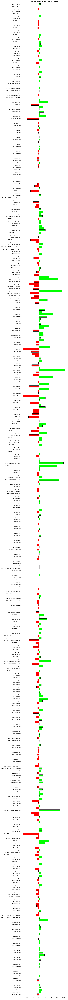

In [76]:
fi2 = learn_14.feature_importance(feature_names=[feature_names[i] for i in fi.index.values])

In [81]:
fi2.to_csv(ml_path + 'fi_' + file_label + '_14days_filtered.csv')

In [80]:
fi2[fi2['accuracy_change'] > 0]

,Feature,accuracy,accuracy_change
0,RH_600mb_max,0.619650,0.004300
1,TMP_1829mabovemeansealevel_max,0.619950,0.004000
2,RH_0D44M1sigmalayer_max,0.620175,0.003775
3,VGRD_1829mabovemeansealevel_avg,0.620575,0.003375
4,TMP_2743mabovemeansealevel_min,0.620700,0.003250
...,...,...,...
226,UGRD_950mb_max,0.623925,0.000025
227,VGRD_0D995sigmalevel_avg,0.623925,0.000025
228,VGRD_20mb_max,0.623925,0.000025
229,VGRD_30mb_min,0.623925,0.000025


In [ ]:
fi.to_csv(ml_path + 'feature_importance_' + file_label + '_14.csv', index=False)

In [16]:
model = TSTPlus(dls.vars, dls.c, seq_len=X.shape[2], d_model=128, n_heads=4, d_k=48, d_v=48, d_ff=128, dropout=.6, n_layers=11, fc_dropout=.8, store_attn=False)
learn = Learner(dls, model, loss_func=LabelSmoothingCrossEntropyFlat(), metrics=[accuracy, BalancedAccuracy()],  opt_func=partial(Adam, decouple_wd=False),cbs=[CutMix1d(), ShowGraphCallback2(), PredictionDynamics()])

In [17]:
lr = 1e-5

epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.623349,1.383898,0.251000,0.251000,08:27
1,1.626163,1.381914,0.252625,0.252625,05:26
2,1.621034,1.379677,0.277375,0.277375,05:25
3,1.615081,1.376583,0.312125,0.312125,05:26
4,1.616805,1.372434,0.327750,0.327750,05:26
5,1.606668,1.367158,0.327000,0.327000,06:47
6,1.590793,1.360001,0.330000,0.330000,05:33
7,1.596511,1.349417,0.347000,0.347000,05:33
8,1.577028,1.335146,0.359250,0.359250,07:07
9,1.563490,1.317390,0.377750,0.377750,05:33


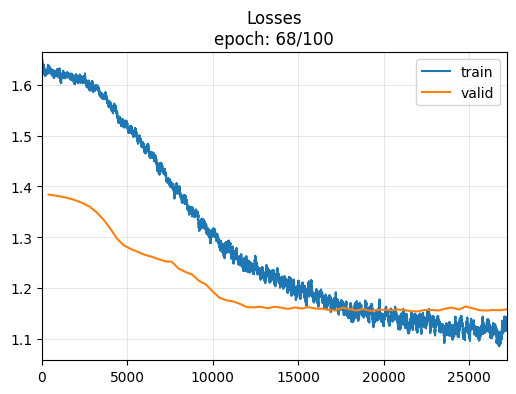

,train_loss,valid_loss,accuracy,balanced_accuracy_score
67,1.139804,1.158003,0.502125,0.502125


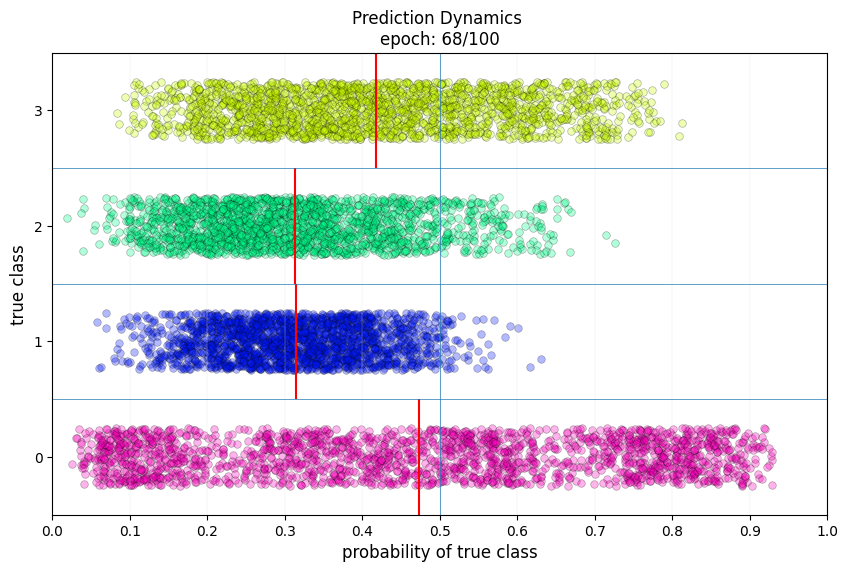

No improvement since epoch 53: early stopping


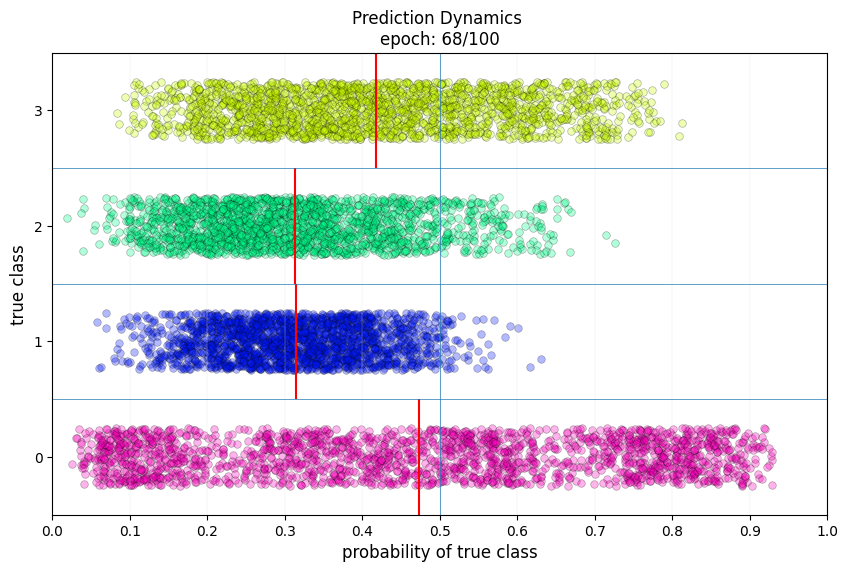

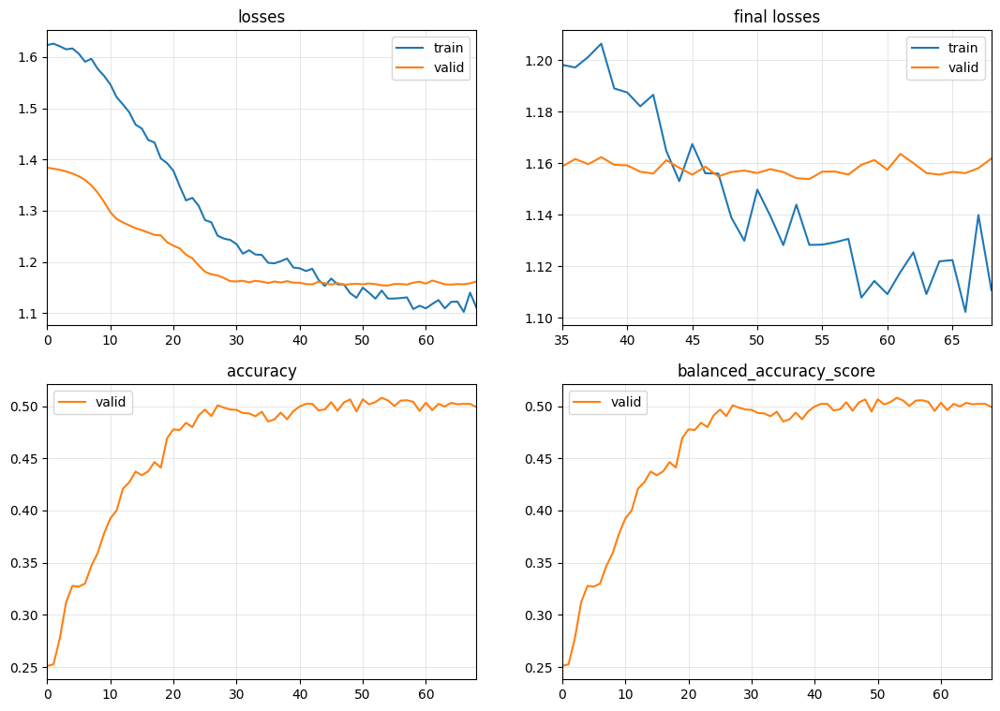

In [19]:
learn.fit_one_cycle(100, lr, cbs=[EarlyStoppingCallback(monitor='accuracy', min_delta=0.001, patience=15)])
#12 layers, 4 heads, fp32, 10.9gb gpu ram, 90% utilization

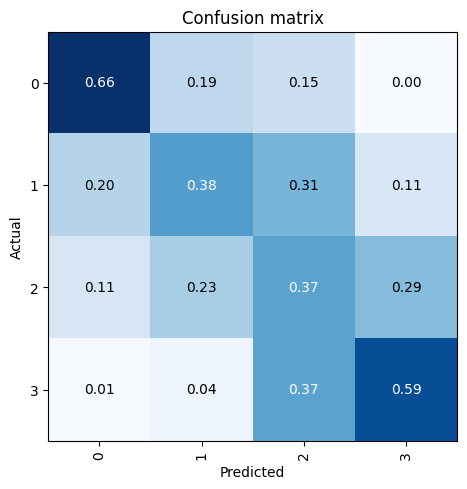

In [20]:
interp = ClassificationInterpretation.from_learner(learn)
conf_matrix = interp.plot_confusion_matrix(normalize=True)

epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.615022,1.371825,0.351250,0.351250,01:55
1,1.611309,1.365857,0.350500,0.350500,01:55
2,1.600338,1.356042,0.372750,0.372750,01:52
3,1.600130,1.343075,0.374625,0.374625,01:51
4,1.578875,1.325095,0.379750,0.379750,01:51
5,1.548053,1.304538,0.391375,0.391375,01:51
6,1.526993,1.281816,0.401125,0.401125,01:51
7,1.508011,1.259059,0.418625,0.418625,01:51
8,1.465890,1.241968,0.421750,0.421750,01:51
9,1.434683,1.223747,0.434750,0.434750,01:51


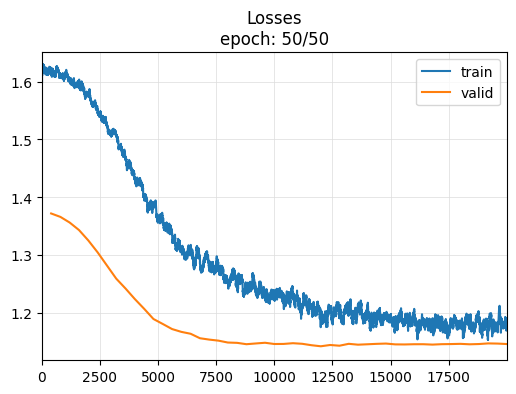

,train_loss,valid_loss,accuracy,balanced_accuracy_score
49,1.180162,1.145924,0.490625,0.490625


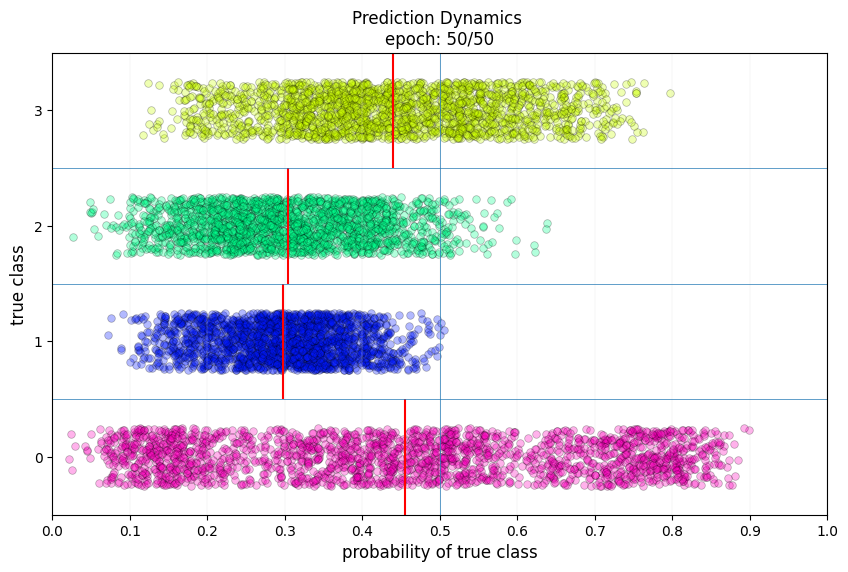

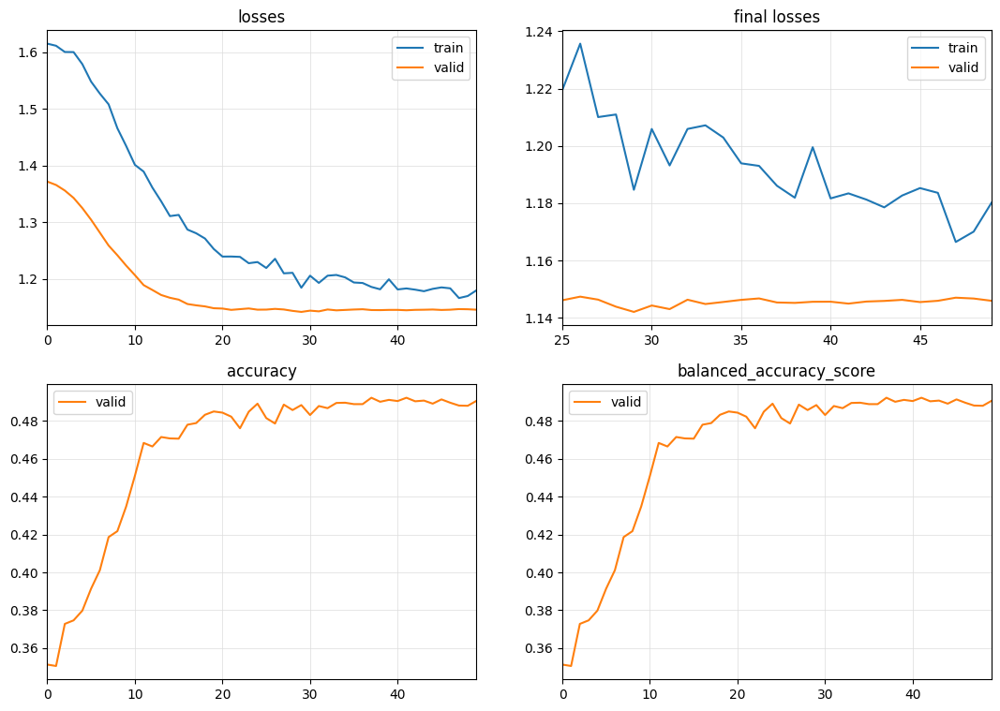

In [29]:
learn.fit_one_cycle(50, lr, cbs=[EarlyStoppingCallback(monitor='accuracy', min_delta=0.001, patience=15)])
#4 layers, 2 heads, fp32, 5gb gpu ram, 50% utilization

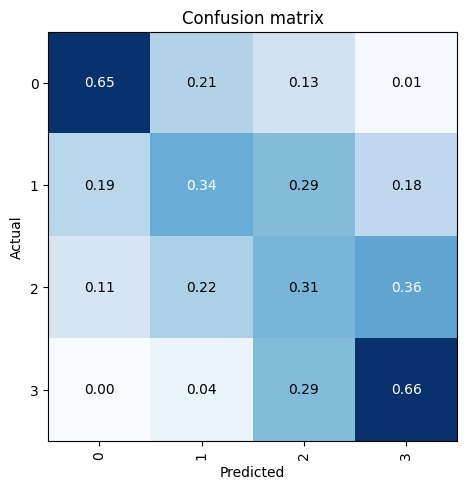

In [30]:
interp = ClassificationInterpretation.from_learner(learn)
conf_matrix = interp.plot_confusion_matrix(normalize=True)

epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.622980,1.387319,0.284125,0.284125,04:06
1,1.624049,1.379155,0.290125,0.290125,01:03
2,1.596502,1.366477,0.295625,0.295625,01:04
3,1.580133,1.350607,0.321375,0.321375,01:04
4,1.552908,1.331723,0.351375,0.351375,01:09
5,1.516443,1.306988,0.374875,0.374875,03:25
6,1.496144,1.283589,0.385000,0.385000,01:02
7,1.455618,1.259823,0.411750,0.411750,01:03
8,1.417659,1.234247,0.431500,0.431500,01:06
9,1.385778,1.217786,0.436125,0.436125,01:02


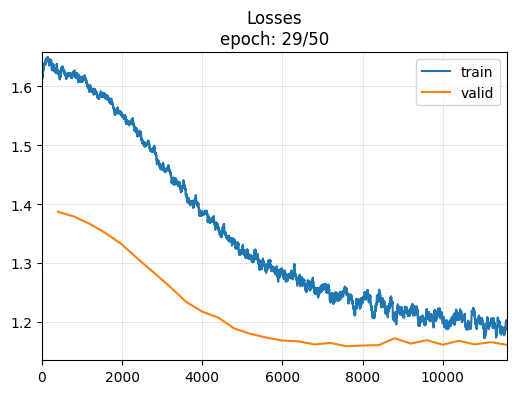

,train_loss,valid_loss,accuracy,balanced_accuracy_score
28,1.196785,1.161358,0.47775,0.47775


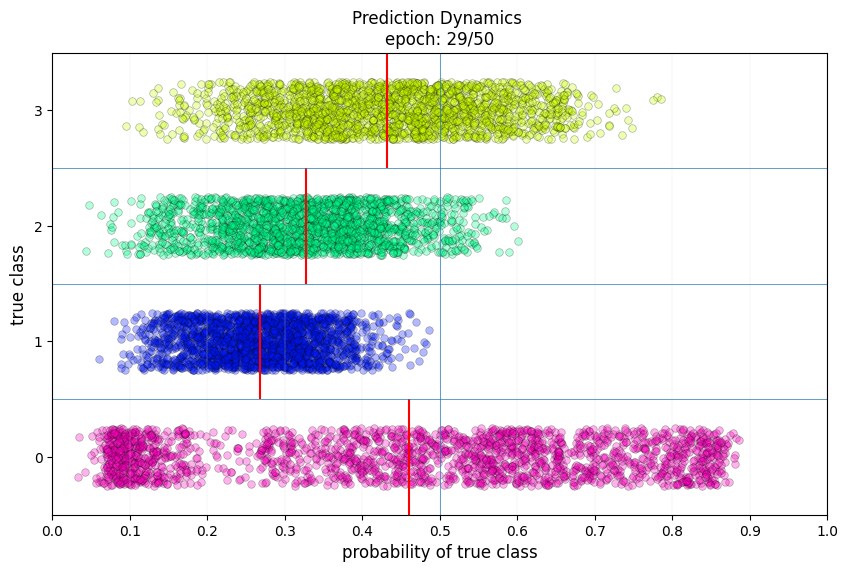

No improvement since epoch 14: early stopping


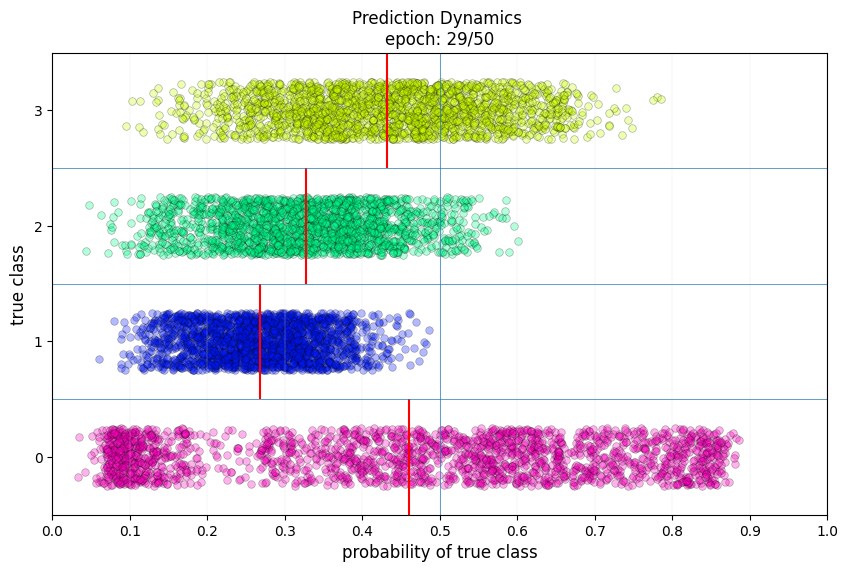

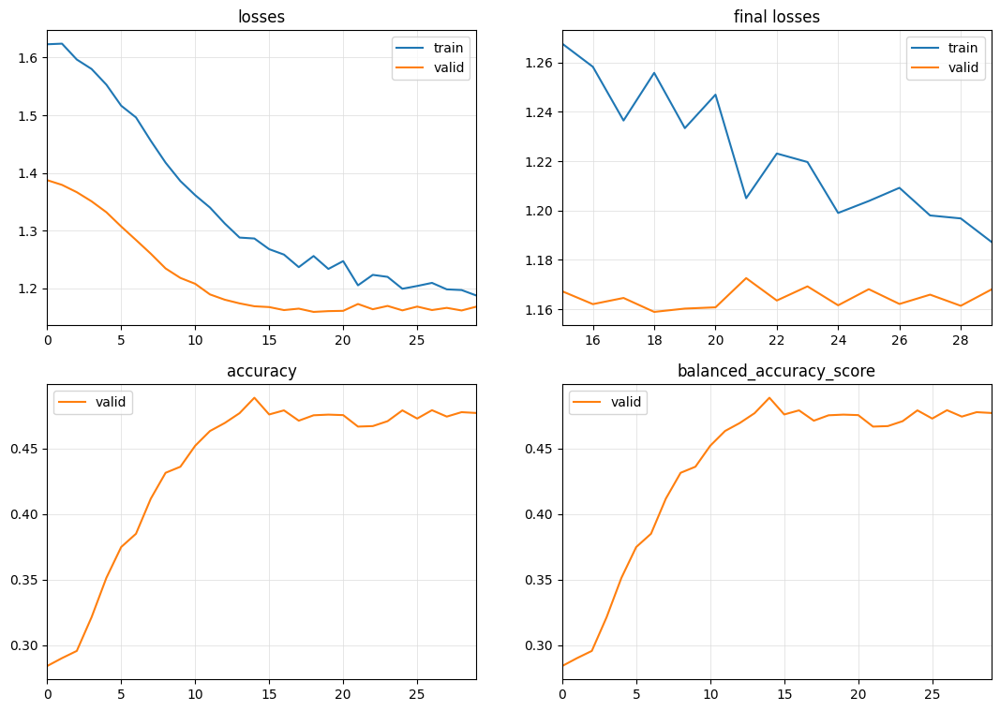

In [18]:
learn.fit_one_cycle(50, lr, cbs=[EarlyStoppingCallback(monitor='accuracy', min_delta=0.001, patience=15)])
#3gb gpu memory total, 6% utilization wiht small spikes to 30%, fp32

### Results


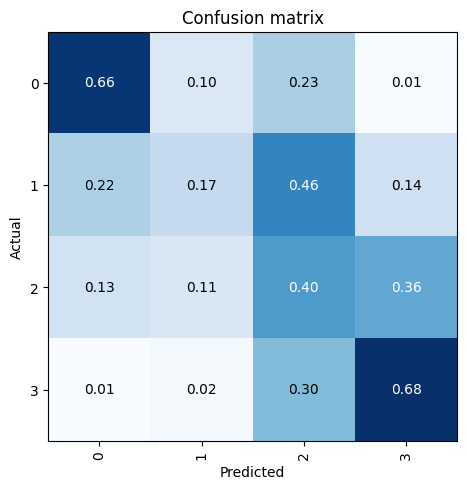

In [19]:
interp = ClassificationInterpretation.from_learner(learn)
conf_matrix = interp.plot_confusion_matrix(normalize=True)

In [23]:
learn = learn.to_fp16()

epoch,train_loss,valid_loss,accuracy,balanced_accuracy_score,time
0,1.631875,1.387331,0.263000,0.263000,01:05
1,1.616732,1.379048,0.321750,0.321750,01:05
2,1.604959,1.367906,0.362625,0.362625,01:05
3,1.593732,1.352051,0.356625,0.356625,01:07
4,1.562975,1.332504,0.380000,0.380000,01:06
5,1.526275,1.306985,0.393125,0.393125,01:05
6,1.501122,1.279816,0.394500,0.394500,01:06
7,1.453335,1.254000,0.407875,0.407875,01:04
8,1.423655,1.233897,0.437750,0.437750,01:05
9,1.387397,1.217920,0.450625,0.450625,01:06


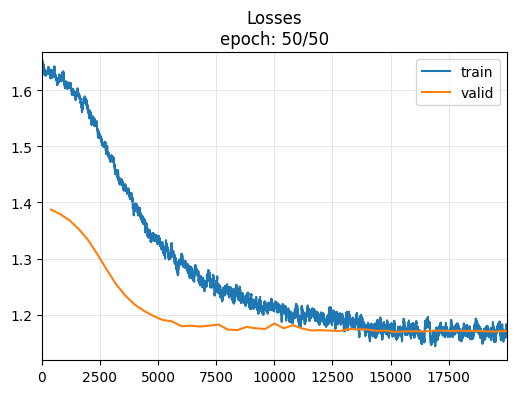

,train_loss,valid_loss,accuracy,balanced_accuracy_score
49,1.180514,1.17126,0.475875,0.475875


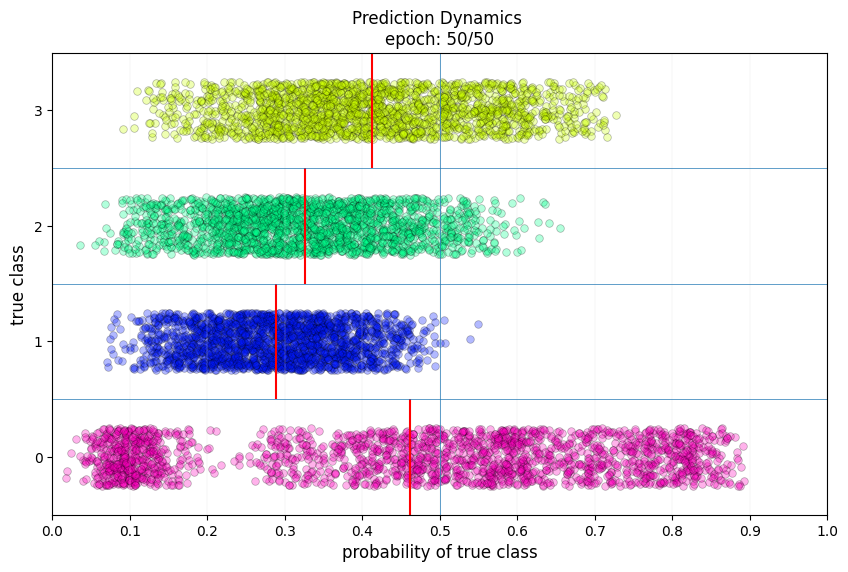

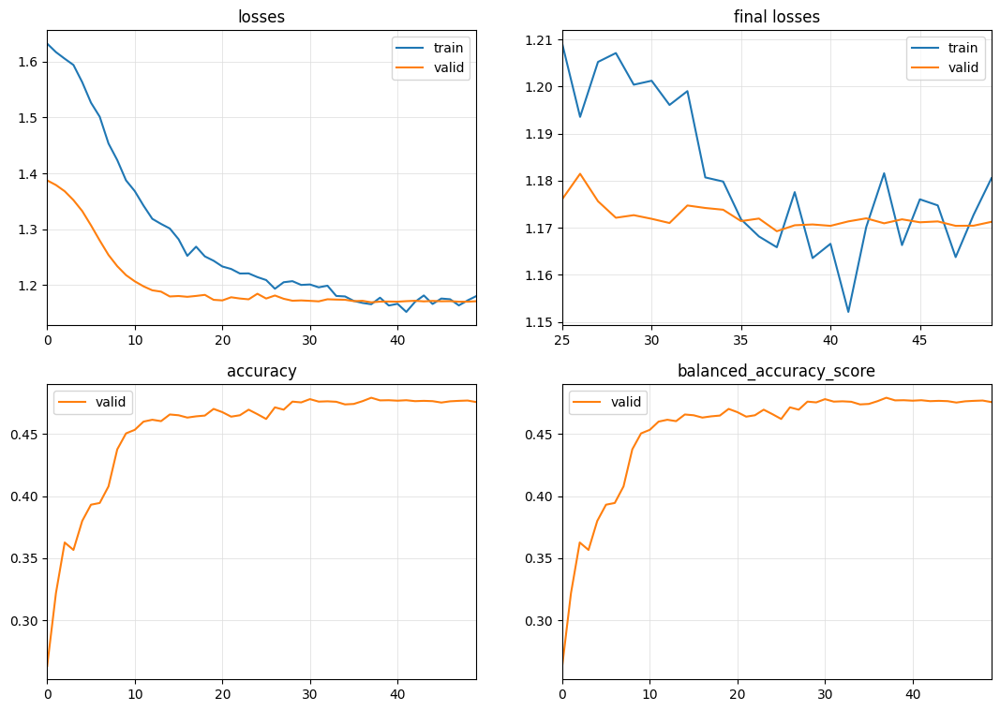

In [24]:
learn.fit_one_cycle(50, lr, cbs=[EarlyStoppingCallback(monitor='accuracy', min_delta=0.001, patience=15)])
#3gb gpu memory total, 20% utilization wiht small spikes, fp16

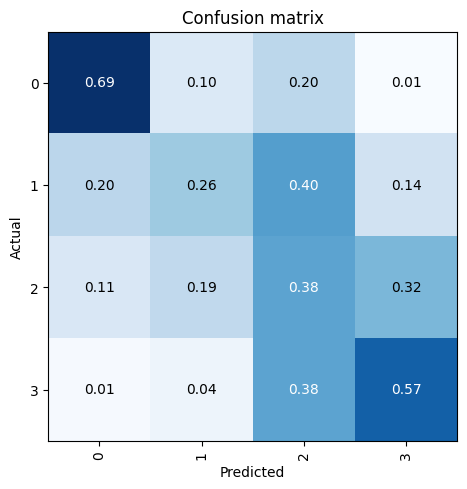

In [25]:
interp = ClassificationInterpretation.from_learner(learn)
conf_matrix = interp.plot_confusion_matrix(normalize=True)

X.shape: (40000, 82, 673)
y.shape: (40000,)
Selected metric: accuracy
Computing feature importance (permutation method)...


  0 feature: BASELINE             accuracy: 0.751700


  0 feature: ACPCP_surface_sum    accuracy: 0.751675


  1 feature: APCP_surface_sum     accuracy: 0.751400


  2 feature: APTMP_2maboveground_avg accuracy: 0.703200


  3 feature: CAPE_180M0mbaboveground_avg accuracy: 0.751775


  4 feature: CAPE_255M0mbaboveground_avg accuracy: 0.751550


  5 feature: CAPE_surface_avg     accuracy: 0.751775


  6 feature: CIN_180M0mbaboveground_avg accuracy: 0.675875


  7 feature: CIN_255M0mbaboveground_avg accuracy: 0.668075


  8 feature: CIN_surface_avg      accuracy: 0.660525


  9 feature: GUST_surface_avg     accuracy: 0.743675


 10 feature: RH_0D44M0D72sigmalayer_avg accuracy: 0.662575


 11 feature: RH_2maboveground_avg accuracy: 0.702800


 12 feature: RH_30M0mbaboveground_avg accuracy: 0.653700


 13 feature: RH_70mb_avg          accuracy: 0.749450


 14 feature: RH_975mb_avg         accuracy: 0.730725


 15 feature: SNOD_surface_avg     accuracy: 0.749200


 16 feature: TMP_100maboveground_avg accuracy: 0.700700


 17 feature: TMP_2maboveground_avg accuracy: 0.683675


 18 feature: TMP_30M0mbaboveground_avg accuracy: 0.645500


 19 feature: TMP_350mb_avg        accuracy: 0.726125


 20 feature: TMP_400mb_avg        accuracy: 0.712850


 21 feature: TMP_800mb_avg        accuracy: 0.669925


 22 feature: TMP_80maboveground_avg accuracy: 0.669725


 23 feature: TMP_surface_avg      accuracy: 0.664125


 24 feature: UGRD_0D995sigmalevel_avg accuracy: 0.731425


 25 feature: UGRD_1000mb_avg      accuracy: 0.743850


 26 feature: UGRD_100mb_avg       accuracy: 0.688375


 27 feature: UGRD_10mb_avg        accuracy: 0.739250


 28 feature: UGRD_150mb_avg       accuracy: 0.700575


 29 feature: UGRD_200mb_avg       accuracy: 0.748500


 30 feature: UGRD_20mb_avg        accuracy: 0.735825


 31 feature: UGRD_250mb_avg       accuracy: 0.751175


 32 feature: UGRD_300mb_avg       accuracy: 0.725950


 33 feature: UGRD_30mb_avg        accuracy: 0.749875


 34 feature: UGRD_350mb_avg       accuracy: 0.744825


 35 feature: UGRD_400mb_avg       accuracy: 0.732550


 36 feature: UGRD_450mb_avg       accuracy: 0.701600


 37 feature: UGRD_500mb_avg       accuracy: 0.719900


 38 feature: UGRD_50mb_avg        accuracy: 0.753000


 39 feature: UGRD_550mb_avg       accuracy: 0.722650


 40 feature: UGRD_600mb_avg       accuracy: 0.742575


 41 feature: UGRD_650mb_avg       accuracy: 0.729575


 42 feature: UGRD_700mb_avg       accuracy: 0.749350


 43 feature: UGRD_70mb_avg        accuracy: 0.744675


 44 feature: UGRD_750mb_avg       accuracy: 0.738800


 45 feature: UGRD_800mb_avg       accuracy: 0.730450


 46 feature: UGRD_850mb_avg       accuracy: 0.749650


 47 feature: UGRD_900mb_avg       accuracy: 0.750600


 48 feature: UGRD_925mb_avg       accuracy: 0.738675


 49 feature: UGRD_950mb_avg       accuracy: 0.751925


 50 feature: UGRD_975mb_avg       accuracy: 0.753300


 51 feature: VGRD_0D995sigmalevel_avg accuracy: 0.756075


 52 feature: VGRD_1000mb_avg      accuracy: 0.748050


 53 feature: VGRD_100mb_avg       accuracy: 0.722450


 54 feature: VGRD_10mb_avg        accuracy: 0.691800


 55 feature: VGRD_150mb_avg       accuracy: 0.736050


 56 feature: VGRD_200mb_avg       accuracy: 0.734575


 57 feature: VGRD_20mb_avg        accuracy: 0.728700


 58 feature: VGRD_250mb_avg       accuracy: 0.730025


 59 feature: VGRD_300mb_avg       accuracy: 0.745900


 60 feature: VGRD_30mb_avg        accuracy: 0.745125


 61 feature: VGRD_350mb_avg       accuracy: 0.742225


 62 feature: VGRD_400mb_avg       accuracy: 0.732150


 63 feature: VGRD_450mb_avg       accuracy: 0.746325


 64 feature: VGRD_500mb_avg       accuracy: 0.729375


 65 feature: VGRD_50mb_avg        accuracy: 0.714725


 66 feature: VGRD_550mb_avg       accuracy: 0.733675


 67 feature: VGRD_600mb_avg       accuracy: 0.732575


 68 feature: VGRD_650mb_avg       accuracy: 0.745325


 69 feature: VGRD_700mb_avg       accuracy: 0.743625


 70 feature: VGRD_70mb_avg        accuracy: 0.733325


 71 feature: VGRD_750mb_avg       accuracy: 0.750575


 72 feature: VGRD_800mb_avg       accuracy: 0.754800


 73 feature: VGRD_850mb_avg       accuracy: 0.755650


 74 feature: VGRD_900mb_avg       accuracy: 0.752525


 75 feature: VGRD_925mb_avg       accuracy: 0.743850


 76 feature: VGRD_950mb_avg       accuracy: 0.748475


 77 feature: VGRD_975mb_avg       accuracy: 0.746075


 78 feature: VVEL_200mb_avg       accuracy: 0.749400


 79 feature: VVEL_450mb_avg       accuracy: 0.749625


 80 feature: WATR_surface_sum     accuracy: 0.751250


 81 feature: WEASD_surface_avg    accuracy: 0.750250



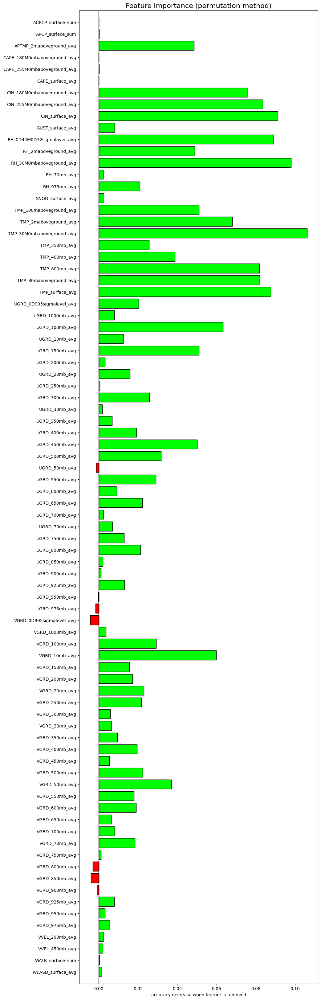

In [34]:
#list feature importances
fi = learn.feature_importance(partial_n=0.1, feature_names=list(feature_names))